# **DATA SCIENCE CASE: Spotify data set for popularity prediction**


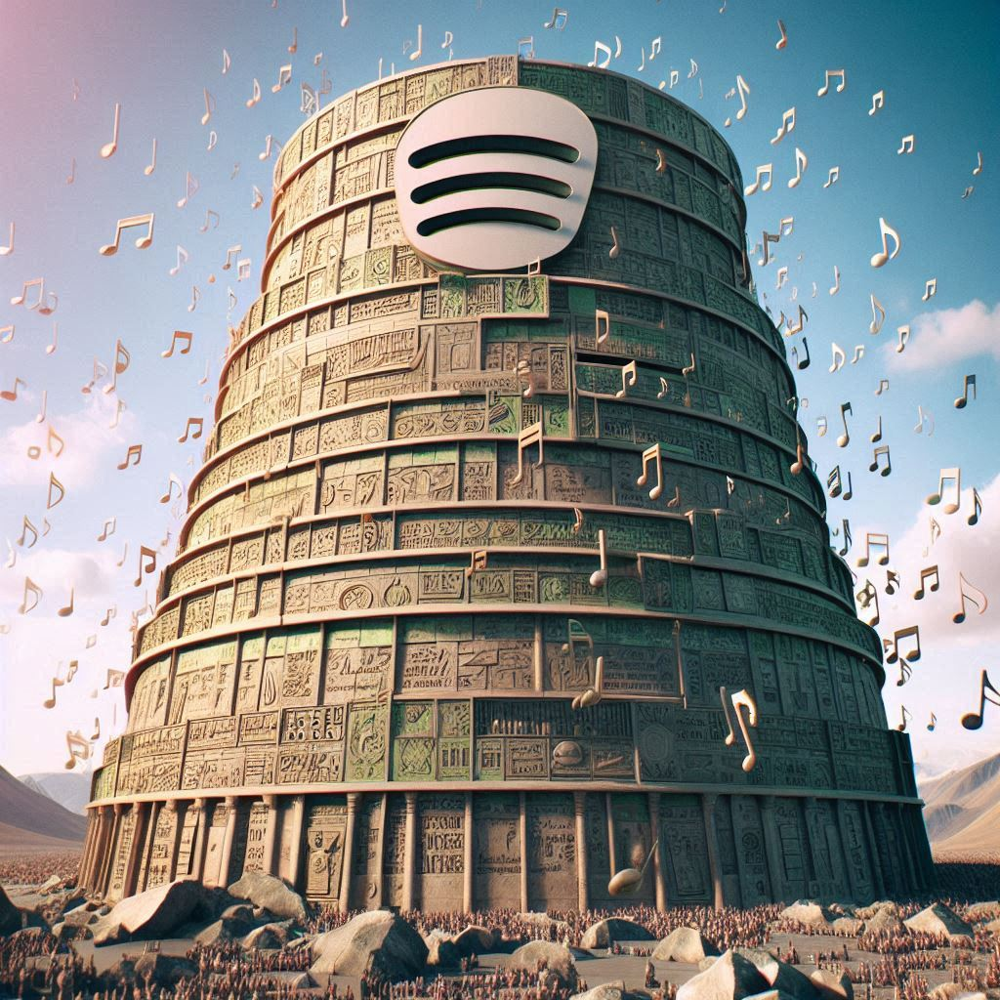

# **BUSINESS CASE**

#### 🎧📈Songs's spotify popularity is related to several factors, artist and producers are interested in revealing formula to achieve success.

#### In Spotify words, Popularity Index, is a dynamic metric that ranks songs, albums, and artists based on their current level of engagement and appeal to listeners on the platform. This score, which ranges from 0 to 100, takes into account factors such as:


*   **Recent plays**: How many times a song or album has been played in a **recent period** (usually 30 days).

*   **Listener interaction**: including skips, repeats, and saves, affects the score.

*   **Freshness of streams**: emphasizing the importance of current popularity.

*   **Global vs. local popularity**: While the score is based on global plays, local popularity in specific regions can also impact it.



### Keep in mind that it’s a dynamic metric that can change over time based on user behavior and trends. 🎧📈



### Therefore marketing promotion is a key point to achieve positions in Popularity Index, nothing else matters ?? (#Metallica🎸)
What about?


*   Energy?🙌
*   Danceable?💃
*   Lyrics? ✍️
*   Beat?🎹




#### This notebook is a first approach to the business case and data set. Consist on inspectioning, cleaning and analyzing features through and EDA process

## **1.** **Data intro and load**

Source:

https://www.kaggle.com/datasets/ziriantahirli/million-song-data-analysis-2/data


Libraries

In [1]:
# paths & savings
import sys
from pathlib import Path
project_dir = Path('C:/Users/mfm-8/Online_Env/DS_Project/')
sys.path.append(str(project_dir))
import os
import pickle

# basics
import numpy as np
import pandas as pd

# functions
import bootcampviztools as bt
from toolbox_ML import *

# regression & clusters
from sklearn.model_selection import train_test_split
from scipy import stats

# esthethic
warnings.filterwarnings('ignore')
import json
import matplotlib.pyplot as plt
import seaborn as sns

Route:

In [2]:
#Uploading file
#uploaded = files.upload()

In [3]:
# Provide the correct file path
file_path = 'C:/Users/mfm-8/Online_Env/DS_Project/df_spotify/spotify_data.csv'

# Read the CSV file into a DataFrame
df = pd.read_csv(file_path, sep=',')

In [4]:
df.head(5)

,Unnamed: 0,artist_name,track_name,track_id,popularity,year,genre,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,0,Jason Mraz,I Won't Give Up,53QF56cjZA9RTuuMZDrSA6,68,2012,acoustic,0.483,0.303,4,-10.058,1,0.0429,0.6940,0.000000,0.1150,0.139,133.406,240166,3
1,1,Jason Mraz,93 Million Miles,1s8tP3jP4GZcyHDsjvw218,50,2012,acoustic,0.572,0.454,3,-10.286,1,0.0258,0.4770,0.000014,0.0974,0.515,140.182,216387,4
2,2,Joshua Hyslop,Do Not Let Me Go,7BRCa8MPiyuvr2VU3O9W0F,57,2012,acoustic,0.409,0.234,3,-13.711,1,0.0323,0.3380,0.000050,0.0895,0.145,139.832,158960,4
3,3,Boyce Avenue,Fast Car,63wsZUhUZLlh1OsyrZq7sz,58,2012,acoustic,0.392,0.251,10,-9.845,1,0.0363,0.8070,0.000000,0.0797,0.508,204.961,304293,4
4,4,Andrew Belle,Sky's Still Blue,6nXIYClvJAfi6ujLiKqEq8,54,2012,acoustic,0.430,0.791,6,-5.419,0,0.0302,0.0726,0.019300,0.1100,0.217,171.864,244320,4


Certain columns can be drop

In [5]:
drop_columns= ['Unnamed: 0','track_id','track_name']
df = df.drop(columns=drop_columns)

Columns review, non nulls.

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1159764 entries, 0 to 1159763
Data columns (total 17 columns):
 #   Column            Non-Null Count    Dtype  
---  ------            --------------    -----  
 0   artist_name       1159749 non-null  object 
 1   popularity        1159764 non-null  int64  
 2   year              1159764 non-null  int64  
 3   genre             1159764 non-null  object 
 4   danceability      1159764 non-null  float64
 5   energy            1159764 non-null  float64
 6   key               1159764 non-null  int64  
 7   loudness          1159764 non-null  float64
 8   mode              1159764 non-null  int64  
 9   speechiness       1159764 non-null  float64
 10  acousticness      1159764 non-null  float64
 11  instrumentalness  1159764 non-null  float64
 12  liveness          1159764 non-null  float64
 13  valence           1159764 non-null  float64
 14  tempo             1159764 non-null  float64
 15  duration_ms       1159764 non-null  int64  
 16  

Only 16 rows hace 1 missing value, we identify and drop them

In [7]:
missing_values_per_row = df.isnull().sum(axis=1)
count_per_missing_value = missing_values_per_row.value_counts().sort_index()
for missing, rows in count_per_missing_value.items():
    print(f'{rows} row(s) have {missing} missing values')
total_rows_with_missing_values = (df.isnull().any(axis=1)).sum()
print(f'Total number of rows with missing values: {total_rows_with_missing_values}')

1159749 row(s) have 0 missing values
15 row(s) have 1 missing values
Total number of rows with missing values: 15


In [8]:
missing = df.isnull().any(axis=1)
missing_rows = df[missing]
missing_rows.head(5)

,artist_name,popularity,year,genre,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
256971,NaN,17,2017,black-metal,0.212,0.708,7,-6.932,1,0.2180,0.000201,0.906,0.143,0.0381,126.739,717237,4
256972,NaN,16,2017,black-metal,0.317,0.518,9,-7.418,1,0.0650,0.000258,0.855,0.729,0.0747,110.958,525099,4
257024,NaN,14,2017,black-metal,0.109,0.142,2,-11.807,0,0.0439,0.154000,0.879,0.105,0.0350,57.422,565664,3
313028,NaN,26,2018,black-metal,0.377,0.507,7,-14.889,1,0.0448,0.000103,0.931,0.211,0.3380,113.917,466182,4
313050,NaN,24,2018,black-metal,0.341,0.426,11,-17.450,0,0.0496,0.038000,0.848,0.113,0.0404,66.628,418945,4


In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1159764 entries, 0 to 1159763
Data columns (total 17 columns):
 #   Column            Non-Null Count    Dtype  
---  ------            --------------    -----  
 0   artist_name       1159749 non-null  object 
 1   popularity        1159764 non-null  int64  
 2   year              1159764 non-null  int64  
 3   genre             1159764 non-null  object 
 4   danceability      1159764 non-null  float64
 5   energy            1159764 non-null  float64
 6   key               1159764 non-null  int64  
 7   loudness          1159764 non-null  float64
 8   mode              1159764 non-null  int64  
 9   speechiness       1159764 non-null  float64
 10  acousticness      1159764 non-null  float64
 11  instrumentalness  1159764 non-null  float64
 12  liveness          1159764 non-null  float64
 13  valence           1159764 non-null  float64
 14  tempo             1159764 non-null  float64
 15  duration_ms       1159764 non-null  int64  
 16  

In [10]:
df = df.dropna()
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1159749 entries, 0 to 1159763
Data columns (total 17 columns):
 #   Column            Non-Null Count    Dtype  
---  ------            --------------    -----  
 0   artist_name       1159749 non-null  object 
 1   popularity        1159749 non-null  int64  
 2   year              1159749 non-null  int64  
 3   genre             1159749 non-null  object 
 4   danceability      1159749 non-null  float64
 5   energy            1159749 non-null  float64
 6   key               1159749 non-null  int64  
 7   loudness          1159749 non-null  float64
 8   mode              1159749 non-null  int64  
 9   speechiness       1159749 non-null  float64
 10  acousticness      1159749 non-null  float64
 11  instrumentalness  1159749 non-null  float64
 12  liveness          1159749 non-null  float64
 13  valence           1159749 non-null  float64
 14  tempo             1159749 non-null  float64
 15  duration_ms       1159749 non-null  int64  
 16  time_

No missings

In [11]:
categorical_cols = df[df.columns[(df.dtypes == 'object') | (df.dtypes == 'bool')]]

dist_categorical_cols = pd.DataFrame(
    data = {
        'Missing Values': categorical_cols.isnull().sum(),
        'Missing Percentage': (categorical_cols.isnull().mean() * 100)
    })
dist_categorical_cols

,Missing Values,Missing Percentage
artist_name,0,0.0
genre,0,0.0


A last transformation is needed, in order to have a good predictor model, rows with popularity = 0 are droppped.

In [12]:
df = df[df['popularity'] != 0]

In [13]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1001358 entries, 0 to 1159763
Data columns (total 17 columns):
 #   Column            Non-Null Count    Dtype  
---  ------            --------------    -----  
 0   artist_name       1001358 non-null  object 
 1   popularity        1001358 non-null  int64  
 2   year              1001358 non-null  int64  
 3   genre             1001358 non-null  object 
 4   danceability      1001358 non-null  float64
 5   energy            1001358 non-null  float64
 6   key               1001358 non-null  int64  
 7   loudness          1001358 non-null  float64
 8   mode              1001358 non-null  int64  
 9   speechiness       1001358 non-null  float64
 10  acousticness      1001358 non-null  float64
 11  instrumentalness  1001358 non-null  float64
 12  liveness          1001358 non-null  float64
 13  valence           1001358 non-null  float64
 14  tempo             1001358 non-null  float64
 15  duration_ms       1001358 non-null  int64  
 16  time_

## **2. Data distribution & meaning**

.............................................................................................................................
#### **Planification:**

2.1 Features understanding

2.2 Columns classification and some cleaning

.............................................................................................................................

### **2.1. Features understanding**

First look to numerical features performance:

In [14]:
df.describe()

,popularity,year,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
count,1.001358e+06,1.001358e+06,1.001358e+06,1.001358e+06,1.001358e+06,1.001358e+06,1.001358e+06,1.001358e+06,1.001358e+06,1.001358e+06,1.001358e+06,1.001358e+06,1.001358e+06,1.001358e+06,1.001358e+06
mean,2.129085e+01,2.012402e+03,5.364040e-01,6.428722e-01,5.281438e+00,-8.830051e+00,6.349308e-01,9.340339e-02,3.153971e-01,2.408513e-01,2.241765e-01,4.522061e-01,1.214422e+02,2.460144e+05,3.889541e+00
std,1.517764e+01,6.731284e+00,1.830980e-01,2.683735e-01,3.556205e+00,5.642160e+00,4.814498e-01,1.295908e-01,3.488116e-01,3.600787e-01,2.029895e-01,2.671529e-01,2.998235e+01,1.393361e+05,4.554643e-01
min,1.000000e+00,2.000000e+03,0.000000e+00,0.000000e+00,0.000000e+00,-5.810000e+01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,5.661000e+03,0.000000e+00
25%,9.000000e+00,2.007000e+03,4.140000e-01,4.610000e-01,2.000000e+00,-1.057800e+01,0.000000e+00,3.670000e-02,7.110000e-03,0.000000e+00,9.840000e-02,2.250000e-01,9.823300e+01,1.817070e+05,4.000000e+00
50%,1.800000e+01,2.013000e+03,5.490000e-01,6.970000e-01,5.000000e+00,-7.288000e+00,1.000000e+00,5.000000e-02,1.460000e-01,1.150000e-03,1.340000e-01,4.330000e-01,1.210800e+02,2.246270e+05,4.000000e+00
75%,3.100000e+01,2.018000e+03,6.740000e-01,8.730000e-01,8.000000e+00,-5.194000e+00,1.000000e+00,8.890000e-02,6.180000e-01,5.520000e-01,2.920000e-01,6.680000e-01,1.399860e+02,2.812980e+05,4.000000e+00
max,1.000000e+02,2.023000e+03,9.930000e-01,1.000000e+00,1.100000e+01,6.172000e+00,1.000000e+00,9.700000e-01,9.960000e-01,1.000000e+00,1.000000e+00,1.000000e+00,2.497920e+02,6.000495e+06,5.000000e+00


##### **Columns class**

Understanding all features and classifications

In [15]:
tipifica_variables(df, 10, 20)

,nombre_variable,tipo_sugerido
0,artist_name,Object
1,popularity,Numérica Discreta
2,year,Numérica Discreta
3,genre,Object
4,danceability,Numérica Discreta
5,energy,Numérica Discreta
6,key,Numérica Discreta
7,loudness,Numérica Discreta
8,mode,Binaria
9,speechiness,Numérica Discreta


Cardinality detail:

In [16]:
pd.DataFrame({"Cardinality": df.nunique(), "% Var Card": df.nunique()/df.count()*100.0})

,Cardinality,% Var Card
artist_name,61444,6.136067
popularity,97,0.009687
year,24,0.002397
genre,82,0.008189
danceability,1361,0.135915
energy,3079,0.307482
key,12,0.001198
loudness,36441,3.639158
mode,2,0.000200
speechiness,1654,0.165176


Features type list:

In [17]:
features_categorical = ['artist_name', 'genre' , 'year']
features_binary = ['mode']
features_numeric_discrete = ['popularity', 'danceability', 'energy', 'key', 'loudness',
                         'speechiness', 'acousticness', 'instrumentalness', 'liveness',
                         'valence', 'tempo','time_signature']
features_numeric_continuous = ['duration_ms']

# Print
print("Categorical features:", features_categorical)
print("Binary features:", features_binary)
print("Numerical discrete features:", features_numeric_discrete)
print("Numerical continuous features:",features_numeric_continuous)

Categorical features: ['artist_name', 'genre', 'year']
Binary features: ['mode']
Numerical discrete features: ['popularity', 'danceability', 'energy', 'key', 'loudness', 'speechiness', 'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo', 'time_signature']
Numerical continuous features: ['duration_ms']


We may consider drop artist, we prepare the list in case needed

In [18]:
features_categorical_analyse_without_artist = ['genre', 'year']

In [19]:
columns = features_categorical + features_binary + features_numeric_discrete +features_numeric_continuous

In [20]:
numerical_columns =  features_binary + features_numeric_discrete +features_numeric_continuous

### **2.2. Columns classification and some cleaning**

|Variable|Description|Type|Priority|
|:-:|:-:|:-:|:-:|
|artist_name|The artists' names who performed the track. If there is more than one artist, they are separated by a ;|Categoric|1|
|track_name|Name of the track|Categoric|2|
|popularity|value between 0 and 100, with 100 being the most popular. The popularity is calculated by algorithm and is based, in the most part, on the total number of plays the track has had and how recent those plays are. Generally speaking, songs that are being played a lot now will have a higher popularity than songs that were played a lot in the past. Duplicate tracks (e.g. the same track from a single and an album) are rated independently. Artist and album popularity is derived mathematically from track popularity|Numerical|0|
|year|Track year|Numerical|0|
|genre|Track genre|Categorical|0|
|danceability| Danceability describes how suitable a track is for dancing based on a combination of musical elements including tempo, rhythm stability, beat strength, and overall regularity. A value of 0.0 is least danceable and 1.0 is most danceable.|Numerical|0|
|energy|Energy is a measure from 0.0 to 1.0 and represents a perceptual measure of intensity and activity. Typically, energetic tracks feel fast, loud, and noisy. For example, death metal has high energy, while a Bach prelude scores low on the scale. Perceptual features contributing to this attribute include dynamic range, perceived loudness, timbre, onset rate, and general entropy.|Numerical|0|
|key|The key the track is in. Integers map to pitches using standard Pitch Class notation. E.g. 0 = C, 1 = C♯/D♭, 2 = D, and so on. If no key was detected, the value is -1.|Numerical|2|
|loudness|Loudness values are averaged across the entire track and are useful for comparing relative loudness of tracks. Loudness is the quality of a sound that is the primary psychological correlate of physical strength (amplitude). Values typically range between -60 and 0 db.|Numerical|1|
|mode|Mode indicates the modality (major or minor) of a track, the type of scale from which its melodic content is derived. Major is represented by 1 and minor is 0.|Numerical|2|
|speechiness|Speechiness detects the presence of spoken words in a track. The more exclusively speech-like the recording (e.g. talk show, audio book, poetry), the closer to 1.0 the attribute value. Values above 0.66 describe tracks that are probably made entirely of spoken words. Values between 0.33 and 0.66 describe tracks that may contain both music and speech, either in sections or layered, including such cases as rap music. Values below 0.33 most likely represent music and other non-speech-like tracks.|Numerical|2|
|acousticness|A confidence measure from 0.0 to 1.0 of whether the track is acoustic. 1.0 represents high confidence the track is acoustic.|Numerical|1|
|instrumentalness|Predicts whether a track contains no vocals. "Ooh" and "aah" sounds are treated as instrumental in this context. Rap or spoken word tracks are clearly "vocal". The closer the instrumentalness value is to 1.0, the greater likelihood the track contains no vocal content. Values above 0.5 are intended to represent instrumental tracks, but confidence is higher as the value approaches 1.0.|Numerical|1|
|liveness|Detects the presence of an audience in the recording. Higher liveness values represent an increased probability that the track was performed live. A value above 0.8 provides strong likelihood that the track is live.|Numérica|1|
|valence|A measure from 0.0 to 1.0 describing the musical positiveness conveyed by a track. Tracks with high valence sound more positive (e.g. happy, cheerful, euphoric), while tracks with low valence sound more negative (e.g. sad, depressed, angry).|Numérica|0|
|tempo|The overall estimated tempo of a track in beats per minute (BPM). In musical terminology, tempo is the speed or pace of a given piece and derives directly from the average beat duration.|Numerical|0|
|duration_ms|The track length in milliseconds|Numerical|1|
|time_signature|An estimated time signature. The time signature (meter) is a notational convention to specify how many beats are in each bar (or measure). The time signature ranges from 3 to 7 indicating time signatures of "3/4", to "7/4".|Numerical|0|


As we have a huge list of genres and some of them do not link with this business case, we drop them from the data set in order to have a frame of data suitable to this project. Is a cleaning phase as it´s data not relevant for this case.

In [21]:
genres_to_drop = ['sleep', 'gospel', 'ambient', 'comedy']
df = df[~df['genre'].isin(genres_to_drop)]

In [22]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 929797 entries, 0 to 1159763
Data columns (total 17 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   artist_name       929797 non-null  object 
 1   popularity        929797 non-null  int64  
 2   year              929797 non-null  int64  
 3   genre             929797 non-null  object 
 4   danceability      929797 non-null  float64
 5   energy            929797 non-null  float64
 6   key               929797 non-null  int64  
 7   loudness          929797 non-null  float64
 8   mode              929797 non-null  int64  
 9   speechiness       929797 non-null  float64
 10  acousticness      929797 non-null  float64
 11  instrumentalness  929797 non-null  float64
 12  liveness          929797 non-null  float64
 13  valence           929797 non-null  float64
 14  tempo             929797 non-null  float64
 15  duration_ms       929797 non-null  int64  
 16  time_signature    929797

We create a genre group in order to help some data visualizations

In [23]:
genre_groups = {
'Rock and Metal': ['black-metal', 'alt-rock', 'death-metal', 'hardcore', 'grindcore', 'rock-n-roll', 'hard-rock', 'punk-rock', 'goth', 'metalcore', 'garage', 'punk', 'rock', 'heavy-metal', 'metal', 'psych-rock', 'ska'],
    'Electronic and Dance': ['ambient', 'club', 'electronic', 'dance', 'deep-house', 'electro', 'ambient', 'chill', 'dub', 'dubstep', 'disco', 'drum-and-bass', 'breakbeat', 'trip-hop', 'funk', 'techno', 'trance', 'minimal-techno', 'hardstyle', 'edm', 'progressive-house', 'house', 'chicago-house', 'detroit-techno', 'techno', 'trance'],
    'Pop and Alternative': ['alt-rock', 'emo', 'romance', 'indie-pop', 'power-pop', 'synth-pop', 'groove', 'new-wave', 'pop', 'pop-film', 'electro-pop', 'soft-rock'],
    'Hip-Hop and Urban': ['hip-hop', 'rap', 'dancehall', 'trap', 'r&b', 'urban', 'grime', 'drill', 'lo-fi', 'party', 'freestyle', 'gangsta-rap'],
    'Jazz and Classical': ['jazz', 'soul', 'piano', 'blues', 'classical', 'opera', 'swing', 'big-band', 'bebop', 'ragtime', 'smooth-jazz', 'avant-garde'],
    'Latin and World Music': ['salsa', 'swedish', 'tango', 'bossa-nova', 'samba', 'flamenco', 'latin-jazz', 'reggaeton', 'merengue', 'cumbia', 'bachata'],
    'Country and Folk': ['country', 'guitar', 'folk', 'bluegrass', 'americana', 'traditional', 'roots', 'alt-country', 'folk-rock', 'singer-songwriter', 'acoustic'],
    'Regional and Ethnic': ['indian', 'k-pop', 'new-age', 'french', 'german', 'spanish', 'cantopop', 'afrobeat', 'forro', 'sertanejo'],
    'Various and Miscellaneous': ['gothic', 'sad', 'songwriter', 'industrial', 'show-tunes']
}

def assign_genre_group(genre):
    for group, genres in genre_groups.items():
        if genre in genres:
            return group
    return 'Other'
df['genre_group'] = df['genre'].apply(assign_genre_group)

check all genres are assigned:

In [24]:
df_other_genres = df[df['genre_group'] == 'Other']
other_genres = df_other_genres['genre'].unique()
print(other_genres)

[]


In [25]:
unique_genre_groups = df['genre_group'].unique()
print(unique_genre_groups)

['Country and Folk' 'Regional and Ethnic' 'Rock and Metal'
 'Jazz and Classical' 'Electronic and Dance' 'Hip-Hop and Urban'
 'Pop and Alternative' 'Various and Miscellaneous' 'Latin and World Music']


We make a back up of the data frame cleaned, and we continue working with it

In [26]:
output_folder = 'df_spotify'
if not os.path.exists(output_folder):
    os.makedirs(output_folder)
df_output_path = os.path.join(output_folder, 'df_cleaned_0pop.csv')
df.to_csv(df_output_path, index=False)
print(f"Saved file in: {df_output_path}")

Saved file in: df_spotify\df_cleaned_0pop.csv


Uploading latest version

In [3]:
file_path = 'C:/Users/mfm-8/Online_Env/Nueva Carpeta/df_spotify/df_cleaned_0pop_years_reduced_genres_years_def.csv'
df_cleaned_1 = pd.read_csv(file_path, sep=',')

In [4]:
df_cleaned_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 194953 entries, 0 to 194952
Data columns (total 18 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   artist_name       194953 non-null  object 
 1   popularity        194953 non-null  int64  
 2   year              194953 non-null  int64  
 3   genre             194953 non-null  object 
 4   danceability      194953 non-null  float64
 5   energy            194953 non-null  float64
 6   key               194953 non-null  int64  
 7   loudness          194953 non-null  float64
 8   mode              194953 non-null  int64  
 9   speechiness       194953 non-null  float64
 10  acousticness      194953 non-null  float64
 11  instrumentalness  194953 non-null  float64
 12  liveness          194953 non-null  float64
 13  valence           194953 non-null  float64
 14  tempo             194953 non-null  float64
 15  duration_ms       194953 non-null  int64  
 16  time_signature    19

## **3. Target, key questions & hypothesis**

**TARGET: Popularity Spotify tracks' prediction**. We have a wide range of genres, years and artist. We want to analyse how different features influence the popularity.

**INITIAL HYPOTHESIS:**
- Popularity is higher for certain artists.
- Genres with higher popularity are those related to more commercial music.
- Tempo impacts negativily in popularity.

In [2]:
target = 'popularity'

## **4. Train test split and EDA analysis**

.............................................................................................................................
#### **Planification:**

4.1 Univariant

4.2 Bivariant/Multivariant

.............................................................................................................................

No nulls in the dataset. As there are features with a wide range of values, we are going to explore categorical and numercial features in order to study possible groups of values.

First, we execute train split

In [5]:
train_set, test_set = train_test_split(df_cleaned_1, test_size= 0.2, random_state= 42)

### **4.1. Univariate**

.............................................................................................................................
#### **Planification:**

4.1.1. Categorical:


4.1.2.Numerical

.............................................................................................................................

#### **4.1.1. Categorical**

In [31]:
features_categorical

['artist_name', 'genre', 'year']

Wide list of genres and artists.

In [8]:
bt.print_unique_value_counts(train_set, feature='genre')

Unique values in 'genre':
-----------------------------------------------------
genre                Count      %         
-----------------------------------------------------
chill                5123       3.28%
acoustic             4914       3.15%
deep-house           4879       3.13%
dub                  4733       3.03%
alt-rock             4681       3.00%
dancehall            4670       2.99%
forro                4664       2.99%
k-pop                4656       2.99%
blues                4632       2.97%
spanish              4591       2.94%
hardstyle            4422       2.84%
death-metal          4382       2.81%
country              4371       2.80%
jazz                 4341       2.78%
salsa                4318       2.77%
sertanejo            4258       2.73%
hip-hop              4248       2.72%
garage               4182       2.68%
dance                4133       2.65%
piano                4129       2.65%
folk                 4013       2.57%
hardcore             3958

In [33]:
bt.print_unique_value_counts(train_set, feature='artist_name')

Unique values in 'artist_name':
-----------------------------------------------------
artist_name          Count      %         
-----------------------------------------------------
Piano Peace          442        0.28%
SICK LEGEND          347        0.22%
Johann Sebastian Bach 279        0.18%
Wolfgang Amadeus Mozart 208        0.13%
Little Symphony      173        0.11%
Vybz Kartel          166        0.11%
Arijit Singh         165        0.11%
Armin van Buuren     163        0.10%
Upchurch             156        0.10%
Jack Hartmann        145        0.09%
TWICE                143        0.09%
Ludwig van Beethoven 141        0.09%
Stray Kids           138        0.09%
Boyce Avenue         137        0.09%
Lata Mangeshkar      131        0.08%
HooplaKidz           122        0.08%
Taylor Swift         119        0.08%
ILLENIUM             115        0.07%
Kishore Kumar        115        0.07%
Above & Beyond       114        0.07%
Henry Smith          114        0.07%
Wesley Safadão 

Let´s have a more visual insight with word clouds

##### Word clouds by categorical feature

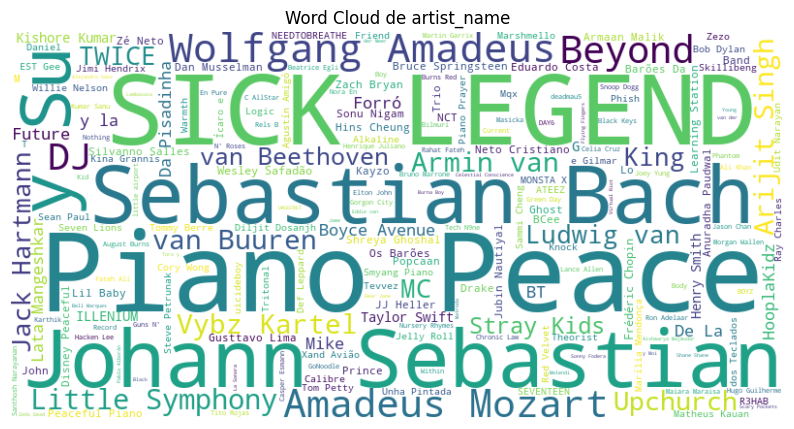

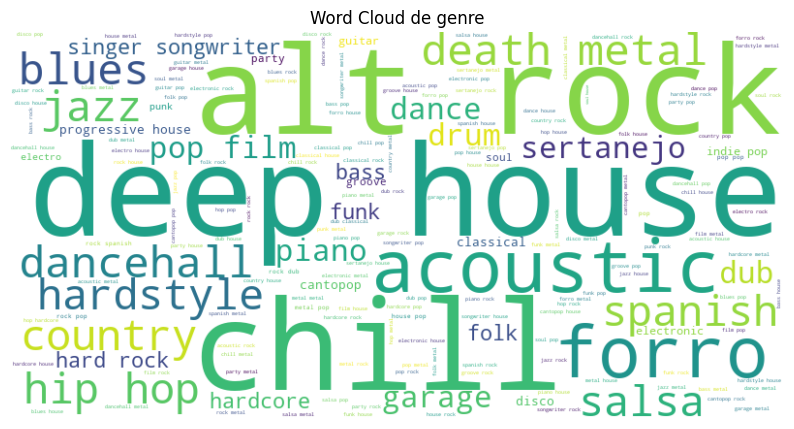

In [34]:
features_categorical_no_year = ['artist_name', 'genre']
bt.plot_wordclouds_for_categorical(train_set,features_categorical_no_year)

In [35]:
grouped_by_genre = train_set.groupby('genre')['artist_name'].agg(lambda x: ', '.join(x.unique()))
print("Artists by genre:")
print(grouped_by_genre)

Artists by genre:
genre
acoustic             NEEDTOBREATHE, Amos Lee, Steve Petrunak, Noah ...
alt-rock             Slaughter Beach, Dog, Egypt Central, HIMALAYAS...
blues                Tommy Castro, Bobby Rush, The Damned, Gov't Mu...
cantopop             Mr., Serrini, JW, Hins Cheung, Sammi Cheng, 曾樂...
chill                Blood Orange, Philanthrope, Elijah Who, Jaeden...
classical            Ian Wong, Oliver Brouwer, Holly Jones, Florian...
country              Riley Green, Jelly Roll, Lindsay Ell, George S...
dance                P!nk, Ruel, Zedd, The Chainsmokers, Rita Ora, ...
dancehall            DING DONG, Christopher Martin, Shenseea, Stone...
death-metal          War From A Harlots Mouth, Suodeth, Municipal W...
deep-house           Mark Knight, Volkan Uca, TCTS, Shavi, Tough Lo...
disco                Pete Tong, Sam Ruffillo, Anna Lunoe, Christin ...
drum-and-bass        SHY FX, Whiney, Ulterior Motive, Camo & Krooke...
dub                  Blanke, Badklaat, Effin, PEEKABO

##### Artist Word Cloud by genre

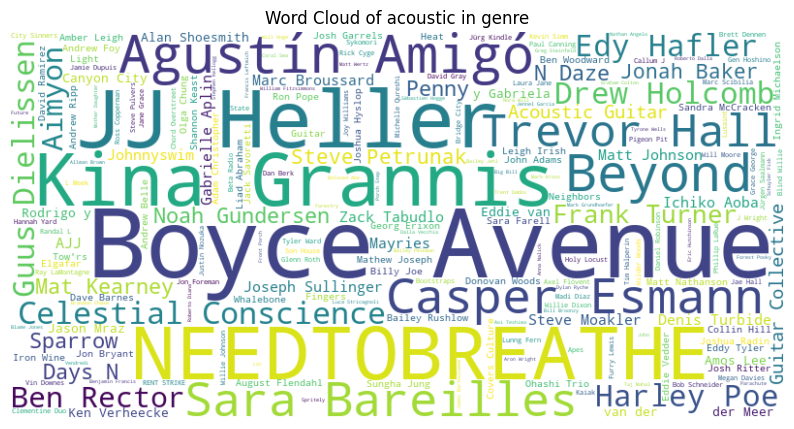

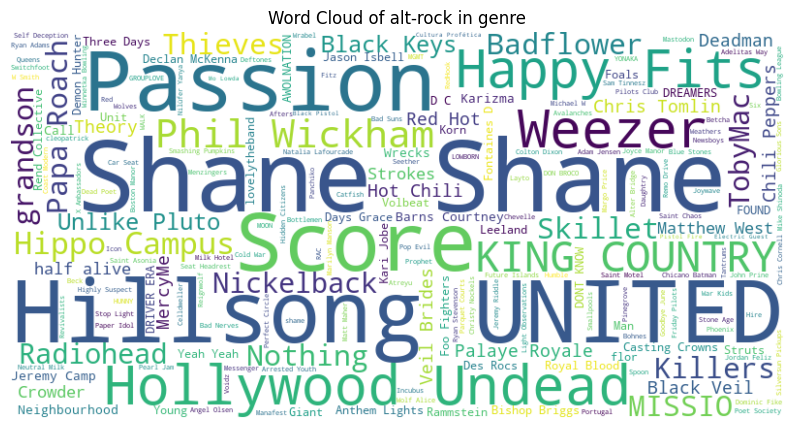

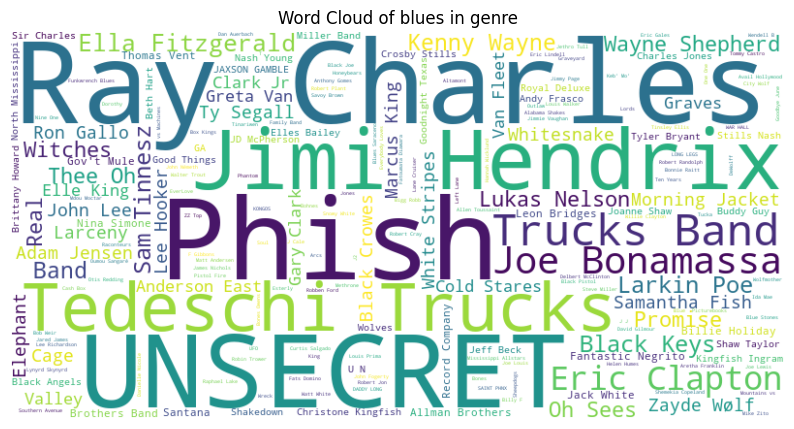

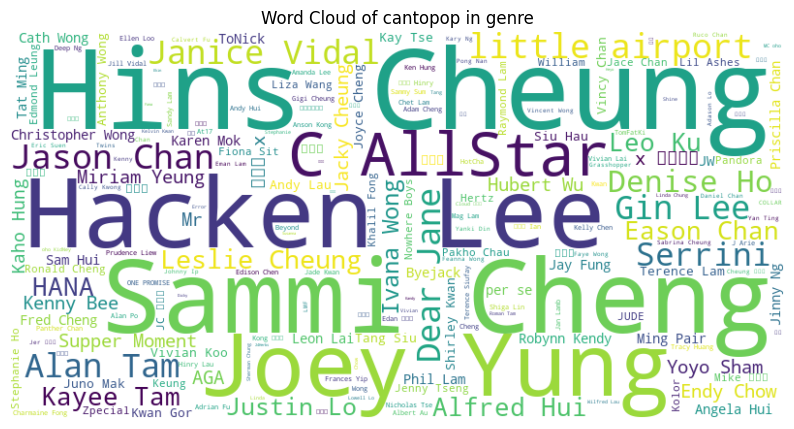

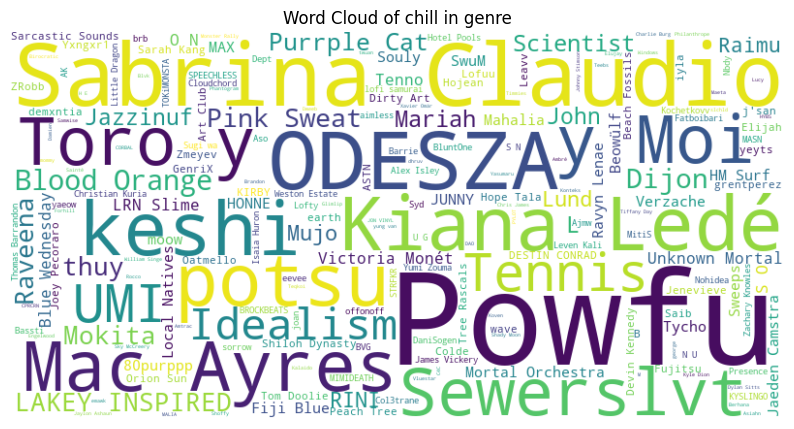

...

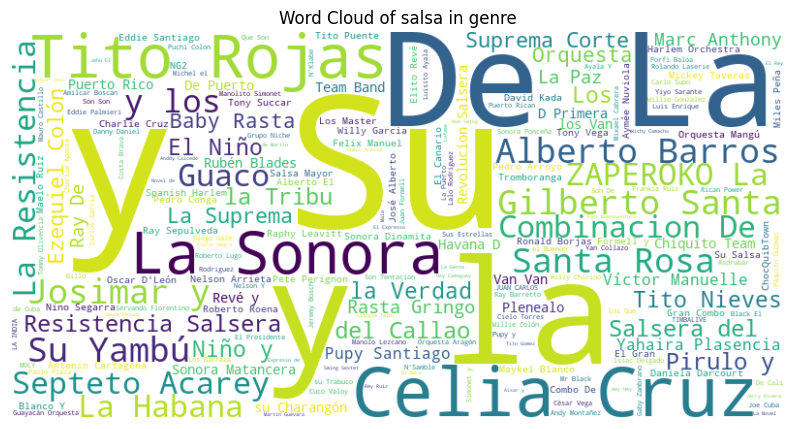

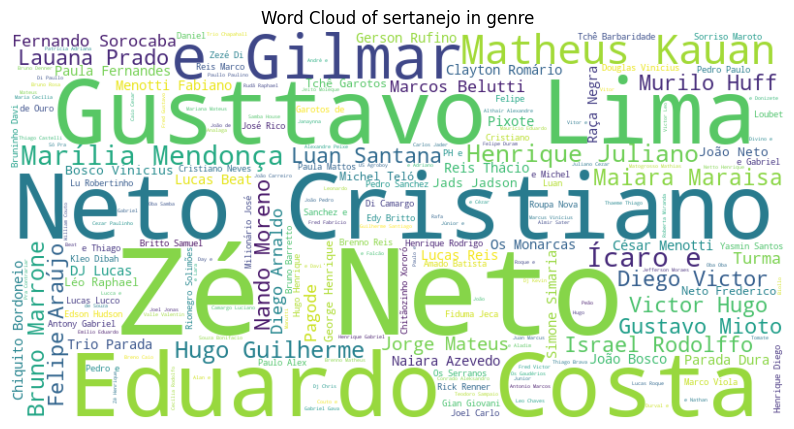

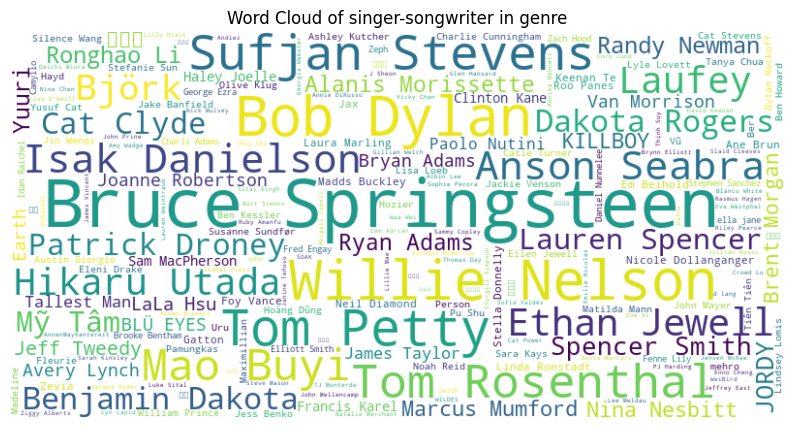

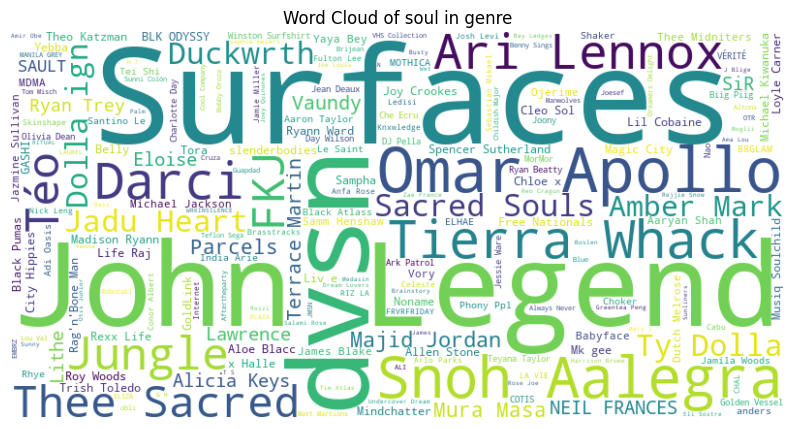

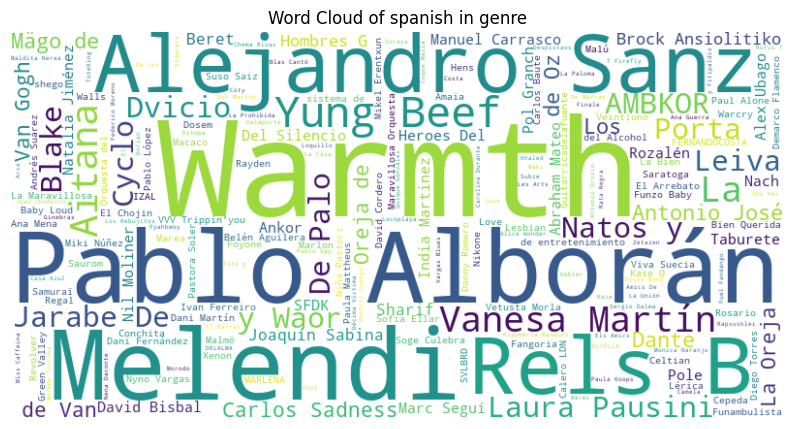

In [36]:
bt.plot_wordclouds_for_categorical_by_group(train_set, group_column='genre', categorical_col='artist_name')


##### TOP 25
High number of rows, we analyse top 25

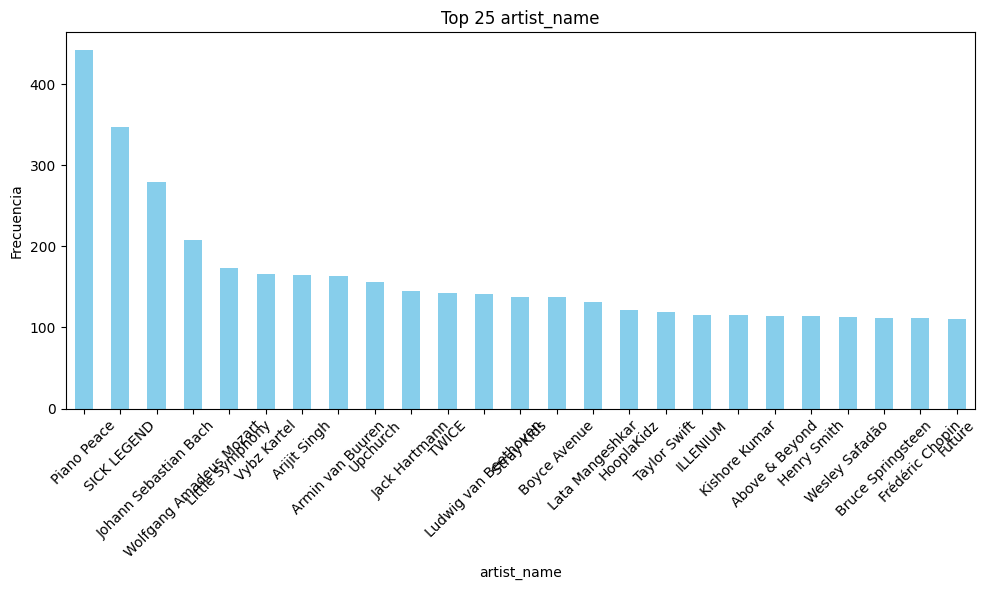

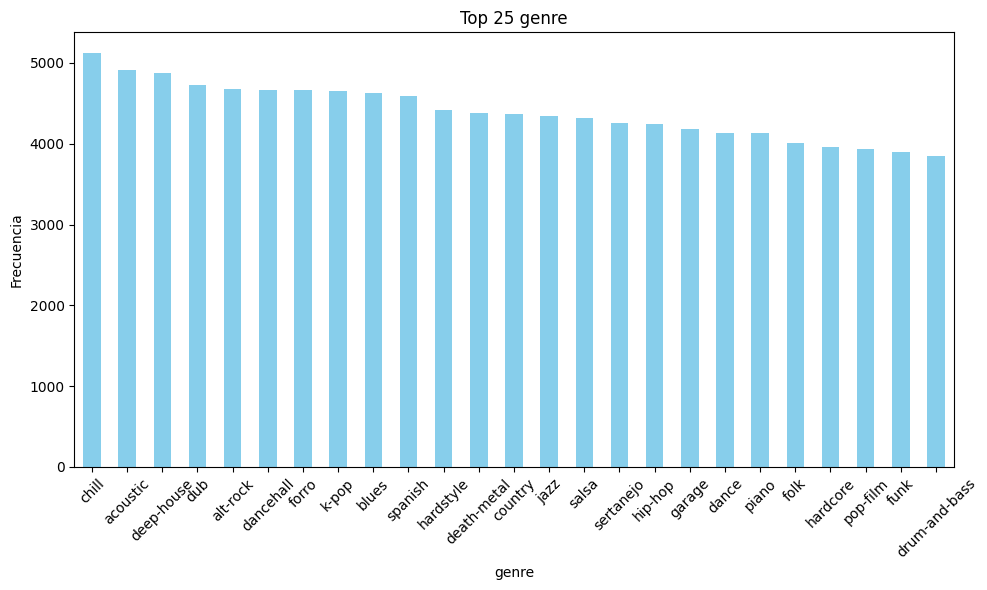

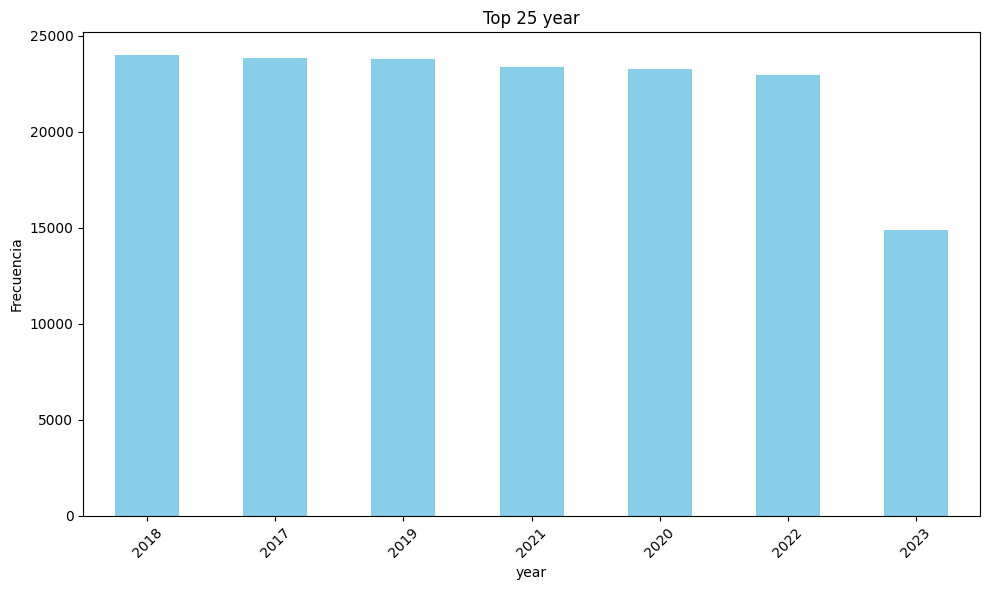

In [37]:
bt.plot_top_n_categories(train_set, features_categorical, n=25)

For the moment, we observe a huge dataset with a large variety of artist, genres and tracks, this may add complexity to the EDA study, although we hope will enrich the study. In adittion, in bivariant analysis we may consider drop categorical columns such as tracks or even we may consider, only a consideration, artist.

#### **4.1.2. Numerical**

Histograms and boxplot are a good starting point. We find out the following insights that we will study more in detail.

* Mode has a binary distribution, no ouliers and with not balanced, frequency higher in 1.
* Danceabililty distribution is similar to a normal distribution and there are significant outliers from 0 to 0.10.
* Energy distribution is similar to a "cola a la izquierda" more values with higher energy. There are no significant outliers.
* Key distribution is similar to a multimodal distribution with several peaks and there are no significant outliers.
* Loudeness distribution shape is a "normal distribution" orientated on the right as there are few instances around -50. From -50 to -15 we have outliers to analyse.
* Speechiness shape is a cola a la derecha, almost a normal distribution except by those values bigger than 0.2. The are outliers to analyse from 0.2 to 0.98.
* Acousticness and Instrumentaless shape are quite similar, with a "cola larga a la derecha" distribution. Oustands a large tail. The are no outliers to analyse. Colinearity betwwen both may be.
* Liveness shapes is a quite different to previous. Can be interpretated as a "multimodal" with different peaks o a "cola larga a la derecha" with a peak arround 0.35, although you can find similar to normal distribution when filtering 0 to 0.3 liveness values. There are outliers to analyse from 0.7 to 1.
* Valence shape can be interpretated as a "multimodal" with different peaks. There are no outliers to analyse.
* Tempo shape can be interpretated as a "normal" with different peaks. There are  outliers to analyse less than 50 and more than 200.* Time_signature shape can be interpretated as a "multimodal" although is concentrated in value 4, other values are outliers. Not consider a relevant feature to deep dive.
* Duration_dms shape can be interpretated as a "normal". There are lots of outliers to analyse from 0.5 to 5.78

.......................................................................................................................................................................

As far as now, outliers will be keep in the data. In previous EDA, some genres were outliers, such as comedy genre and drop in the cleaning.

.......................................................................................................................................................................

* Popularity as TARGET,

##### Train set Histogram

(14, 2)


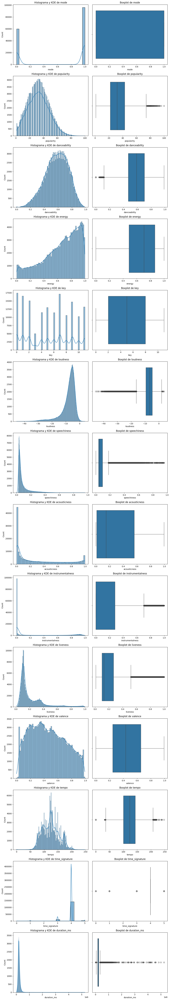

In [38]:
bt.plot_combined_graphs(train_set, numerical_columns, whisker_width=1.5, bins=None)

Save image

In [39]:
fig_train_set_plot_combined_general = plt.gcf()
fig_train_set_plot_combined_general.savefig('train_set_boxplot_general.png')
current_directory = os.getcwd()
print(f"File saved in: {current_directory}")

File saved in: c:\Users\mfm-8\Downloads


<Figure size 640x480 with 0 Axes>

##### 4.1.2.1. Danceability analysis: distribution and outliers
*  Main results:
    * mean is 0.57
    * std is 0.16 -seems to be relatively high-.
    * Values range 0-0.99
    * Percentils insights: median is 0.59 and 75% of values are less than 0.71. More than 25% have a 0.47 danceability value.
* Histogram shape is similar to a normal distribution orientated to the right, as we have seen mostly all values are higher than 0.41. The are signficant ouliers, from 0-0.10 that we will check following.

In [6]:
percentiles = train_set['danceability'].describe(percentiles=[.25, .5, .75])
print("Percentils danceability':")
print(percentiles)

Percentils danceability':
count    155962.000000
mean          0.579604
std           0.164767
min           0.000000
25%           0.469000
50%           0.590000
75%           0.703000
max           0.988000
Name: danceability, dtype: float64


Outliers are less than 1% of the train_set, mainly are classical, guitar genres

In [8]:
outlier_danceability = train_set[train_set['danceability'] < 0.1]
print("Rows'danceability' less than 1:")
print(f'{len(outlier_danceability)} values')
print(f'{round(len(outlier_danceability) / len(train_set) * 100)} % values')
outlier_danceability

Rows'danceability' less than 1:
272 values
0 % values


,artist_name,popularity,year,genre,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,genre_group
38269,Mammoth Grinder,11,2018,death-metal,0.0880,0.95600,10,-5.444,0,0.0758,0.000004,0.723,0.5010,0.5390,170.256,143501,4,Rock and Metal
8379,Kardashev,18,2017,death-metal,0.0616,0.52900,0,-7.978,0,0.0452,0.000080,0.586,0.3880,0.0331,72.401,225886,4,Rock and Metal
186530,Robert Fripp,11,2023,guitar,0.0762,0.04660,10,-25.408,1,0.0436,0.987000,0.942,0.0827,0.0319,178.119,381880,4,Country and Folk
46565,Little Symphony,6,2018,guitar,0.0763,0.00385,2,-23.121,1,0.0504,0.864000,0.939,0.1080,0.1320,171.249,112500,1,Country and Folk
76445,Little Symphony,15,2019,guitar,0.0831,0.03580,7,-28.113,1,0.0429,0.920000,0.956,0.1060,0.0559,170.961,93750,5,Country and Folk
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
76329,Little Symphony,15,2019,guitar,0.0761,0.03080,7,-27.652,1,0.0447,0.901000,0.688,0.1140,0.0486,79.330,63750,3,Country and Folk
59189,Warmth,17,2018,spanish,0.0632,0.12700,5,-24.615,0,0.0431,0.887000,0.963,0.0929,0.0309,65.613,517920,4,Regional and Ethnic
4748,Igor Stravinsky,23,2017,classical,0.0626,0.07550,11,-26.842,1,0.0420,0.940000,0.709,0.3310,0.0354,64.321,314160,3,Jazz and Classical
76213,Little Symphony,15,2019,guitar,0.0846,0.00174,7,-28.015,1,0.0497,0.954000,0.989,0.1110,0.0578,165.270,102875,1,Country and Folk


In [9]:
outliers_by_genre = outlier_danceability.groupby('genre').size()
outliers_by_genre = outliers_by_genre.sort_values(ascending=False)
print("Frequency outliers by genre:")
print(outliers_by_genre)

Frequency outliers by genre:
genre
classical      83
guitar         57
death-metal    32
spanish        28
hardcore       17
garage         15
piano           9
chill           7
jazz            5
hard-rock       5
alt-rock        2
folk            2
punk            2
hip-hop         1
indie-pop       1
dub             1
metal           1
blues           1
pop             1
soul            1
acoustic        1
dtype: int64


##### 4.1.2.2. Energy analysis: distribution and outliers
*  Main results:
    * mean is 0.65
    * std is 0.26 -seems to be relatively high-.
    * Values range 0-1
    * Percentils insights: median is 0.70 and 75% of values are less than 0.87. More than 25% have a 0.48 energy value.
* Histogram shape is "cola a la izquierda" distribution orientated to increase on the right, more values with higher energy. The are no ouliers to analyse.

In [10]:
percentiles = train_set['energy'].describe(percentiles=[.25, .5, .75])
print("Percentils energy':")
print(percentiles)

Percentils energy':
count    155962.000000
mean          0.650797
std           0.259490
min           0.000020
25%           0.487000
50%           0.706000
75%           0.866000
max           1.000000
Name: energy, dtype: float64


##### 4.1.2.3. Key analysis: distribution and outliers
*  Main results:
    * mean is 5.3
    * std is 3.5 -seems to be relatively high-.
    * Values range 0-11
    * Percentils insights: median is 5 and 75% of values are less than 9. More than 25% have a 2 key value.
* Histogram shape is a "multimodal" with different peaks. The are no ouliers to analyse.

In [11]:
percentiles = train_set['key'].describe(percentiles=[.25, .5, .75])
print("Percentils key':")
print(percentiles)

Percentils key':
count    155962.000000
mean          5.301695
std           3.577915
min           0.000000
25%           2.000000
50%           5.000000
75%           8.000000
max          11.000000
Name: key, dtype: float64


##### 4.1.2.4. Loudness analysis: distribution and outliers
*  Main results:
    * mean is -7
    * std is 5.2 -seems to be relatively high-.
    * Values range -45-3.7
    * Percentils insights: median is -6.5 and 75% of values are -4.8. More than 25% have a -9.3 value.
* Histogram shape is a "normal distribution" orientated on the right as there are few instances around -50. From -50 to -15 we have ouliers to analyse.

In [12]:
percentiles = train_set['loudness'].describe(percentiles=[.25, .5, .75])
print("Percentils loudeness':")
print(percentiles)

Percentils loudeness':
count    155962.000000
mean         -7.954737
std           5.273807
min         -45.568000
25%          -9.348000
50%          -6.565000
75%          -4.728000
max           3.795000
Name: loudness, dtype: float64


Interesting to find out that 9% of instance are loudness outliers to be taken into account depending in the correlation of popularity with loudness. Genre categories of this outliers are mostly  classical, new age or piano.

In [15]:
outlier_loudness = train_set[train_set['loudness'] < -15]
print("Rows'loudness' less than -15:")
print(f'{len(outlier_loudness)} values')
print(f'{round(len(outlier_loudness) / len(train_set) * 100)} % values')
outlier_loudness.head(5)

Rows'loudness' less than -15:
13549 values
9 % values


,artist_name,popularity,year,genre,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,genre_group
53400,Piano Peace,24,2018,piano,0.383,0.0777,1,-20.718,0,0.0450,0.986,0.9270,0.1080,0.101,105.979,263349,4,Jazz and Classical
64418,Ian Wong,25,2019,classical,0.587,0.0346,6,-24.676,1,0.0807,0.995,0.9350,0.1160,0.233,121.603,123870,4,Jazz and Classical
71503,Chelsea Cutler,56,2019,electro,0.718,0.1660,6,-15.820,0,0.0344,0.887,0.0216,0.1310,0.237,97.947,219067,4,Electronic and Dance
189863,keseki,5,2023,jazz,0.692,0.2360,0,-17.377,1,0.0415,0.902,0.9560,0.1470,0.113,73.996,190095,4,Jazz and Classical
4665,Oliver Brouwer,32,2017,classical,0.419,0.0014,9,-35.550,1,0.0525,0.994,0.9370,0.0936,0.458,65.740,100625,3,Jazz and Classical


In [16]:
outliers_by_genre = outlier_loudness.groupby('genre').size()
outliers_by_genre = outliers_by_genre.sort_values(ascending=False)
print("Frequency outliers by genre:")
print(outliers_by_genre)

Frequency outliers by genre:
genre
piano                3532
classical            3063
guitar               1487
jazz                 1323
acoustic             1017
chill                 708
folk                  471
singer-songwriter     344
cantopop              174
spanish               171
indie-pop             152
electronic            120
blues                 119
garage                111
pop-film               87
party                  74
salsa                  71
funk                   66
dub                    58
soul                   57
disco                  36
deep-house             32
country                30
groove                 29
electro                25
dancehall              24
alt-rock               22
pop                    21
k-pop                  15
hip-hop                14
punk                   12
hardcore               11
drum-and-bass          10
hard-rock              10
sertanejo              10
death-metal             9
forro                   9
roc

##### Loudness outliers histogram

To have more information we draw outlier loudness histograms and boxplots'

(14, 2)


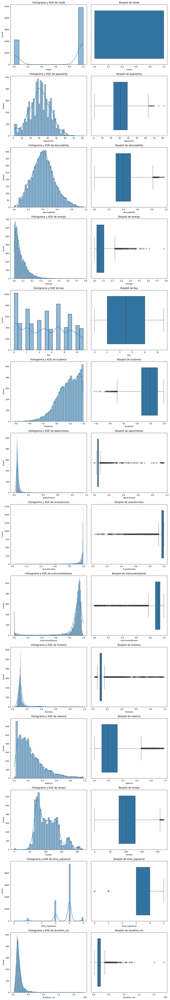

In [48]:
bt.plot_combined_graphs(outlier_loudness, numerical_columns, whisker_width=1.5, bins = None)

To anticipate let´s take a look to ouliers loudness with popularity higher than 60, mainly are sleep genre.

In [49]:
outlier_loudness_greater_60 = outlier_loudness[outlier_loudness['popularity'] >60]
outlier_loudness_greater_60

,artist_name,popularity,year,genre,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,genre_group
169922,Gente di Toscana,61,2022,piano,0.4640,0.03200,1,-28.106,1,0.0560,0.983,0.954000,0.1090,0.2080,69.306,95734,4,Jazz and Classical
169919,Christian Peterson-Bergling,63,2022,piano,0.3520,0.04640,1,-27.631,1,0.0307,0.973,0.879000,0.1070,0.3390,98.943,176557,4,Jazz and Classical
64045,Peter Cavallo,61,2019,classical,0.3230,0.02550,3,-34.641,1,0.0355,0.994,0.848000,0.1120,0.1980,130.380,202500,4,Jazz and Classical
64039,Franz Schubert,62,2019,classical,0.2730,0.00573,9,-39.245,1,0.0493,0.994,0.913000,0.0857,0.1740,91.621,193320,3,Jazz and Classical
169920,Hideyuki Hashimoto,62,2022,piano,0.4450,0.03670,1,-31.319,1,0.0433,0.991,0.944000,0.0896,0.1300,75.396,150833,3,Jazz and Classical
169923,Doris Casella,61,2022,piano,0.2160,0.05750,7,-25.960,0,0.0501,0.994,0.951000,0.1090,0.1510,206.686,118500,4,Jazz and Classical
121667,Beowülf,67,2021,chill,0.8320,0.18100,11,-20.989,1,0.0603,0.835,0.030400,0.1170,0.2130,106.032,110943,4,Electronic and Dance
121683,boy in skirt,64,2021,chill,0.7960,0.06170,7,-22.034,0,0.0754,0.768,0.895000,0.1110,0.1660,96.440,116921,4,Electronic and Dance
140970,Ever So Blue,61,2021,piano,0.2510,0.09020,7,-25.186,1,0.0418,0.971,0.868000,0.0871,0.1280,65.816,177813,3,Jazz and Classical
83503,Billie Eilish,68,2019,pop,0.1530,0.13800,6,-21.877,0,0.0503,0.837,0.550000,0.2540,0.0503,74.318,119410,3,Pop and Alternative


In [50]:
outliers_by_genre = outlier_loudness_greater_60.groupby('genre').size()
outliers_by_genre = outliers_by_genre.sort_values(ascending=False)
print("Frequency outliers by genre:")
print(outliers_by_genre)

Frequency outliers by genre:
genre
piano                16
classical            11
chill                 6
folk                  2
indie-pop             2
pop                   2
singer-songwriter     1
spanish               1
dtype: int64


##### 4.1.2.5. Speechiness analysis: distribution and outliers
*  Main results:
    * mean is 0.08
    * std is 0.08-seems to be relatively not high-.
    * Values range 0-0,971
    * Percentils insights: median is 0.05 and 75% of values are less than 0.09. More than 25% have a 0.03 speechiness value.
* Histogram shape is a cola a la derecha, almost a normal distribution except by those values bigger than 0.2. The are ouliers to analyse from 0.2 to 0.98

In [18]:
percentiles = train_set['speechiness'].describe(percentiles=[.25, .5, .75])
print("Percentils speechiness':")
print(percentiles)

Percentils speechiness':
count    155962.000000
mean          0.087795
std           0.089158
min           0.000000
25%           0.037700
50%           0.052000
75%           0.094200
max           0.958000
Name: speechiness, dtype: float64


10% of outliers is a figure to deep dive. Genres as hiphop, dance hall are the main ones.

In [20]:
outlier_speechiness = train_set[train_set['speechiness'] > 0.20]
print("Rows'speechiness' more than 0.2:")
print(f'{len(outlier_speechiness)} values')
print(f'{round(len(outlier_speechiness) / len(train_set) * 100)} % values')
outlier_speechiness.head(5)

Rows'speechiness' more than 0.2:
15663 values
10 % values


,artist_name,popularity,year,genre,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,genre_group
89054,Kase.O,30,2019,spanish,0.657,0.671,9,-8.834,1,0.304,0.4030,0.000000,0.967,0.287,93.139,378853,4,Regional and Ethnic
36743,Christopher Martin,35,2018,dancehall,0.540,0.736,1,-5.040,0,0.278,0.2800,0.000000,0.241,0.641,88.976,195333,4,Hip-Hop and Urban
84344,Jassie Gift,5,2019,pop-film,0.661,0.932,7,-6.891,1,0.321,0.2050,0.000002,0.184,0.609,94.868,301600,4,Pop and Alternative
99312,SHY FX,41,2020,drum-and-bass,0.677,0.781,2,-2.236,1,0.238,0.0783,0.004670,0.110,0.354,172.022,273488,4,Electronic and Dance
83858,Dhanush,45,2019,pop-film,0.730,0.904,7,-4.223,1,0.247,0.1800,0.000348,0.121,0.464,160.070,239990,4,Pop and Alternative


In [21]:
outliers_by_genre = outlier_speechiness.groupby('genre').size()
outliers_by_genre = outliers_by_genre.sort_values(ascending=False)
print("Frequency outliers by genre:")
print(outliers_by_genre)

Frequency outliers by genre:
genre
hip-hop              2236
dancehall            2189
dub                  1078
hardstyle             909
hardcore              902
funk                  845
chill                 663
spanish               645
dance                 501
drum-and-bass         489
k-pop                 477
death-metal           436
soul                  334
jazz                  319
party                 266
electronic            260
pop-film              236
sertanejo             196
metal                 183
indie-pop             177
hard-rock             175
deep-house            174
country               170
disco                 154
pop                   141
progressive-house     140
alt-rock              138
groove                131
blues                 125
electro               116
salsa                 110
forro                 109
cantopop              104
garage                102
singer-songwriter     100
punk                   71
acoustic               59
fol

To have more information we draw outlier loudness histograms and boxplots'

##### Histogram

(14, 2)


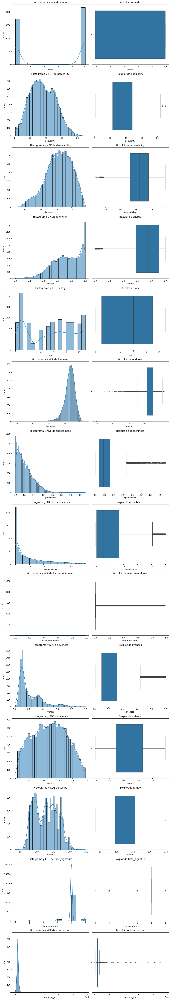

In [54]:
bt.plot_combined_graphs(outlier_speechiness, numerical_columns, whisker_width=1.5, bins = None)

##### 4.1.2.6. Acousticness & Instrumentalness analysis: distribution and outliers
*  Main results Acousticness:
    * mean is 0.3
    * std is 0.33 -seems to be relatively high-.
    * Values range 0-0.99
    * Percentils insights: median is 0.15 and 75% of values are less than 0.57.
*  Main results Instrumentalness:
    * mean is 0.20
    * std is 0.34 -seems to be relatively high-.
    * Values range 0-1
    * Percentils insights: median is 0.00 and 75% of values are less than 0.28.
* Histogram shape is a "cola larga a la derecha" with a large tail. The are no ouliers to analyse, although is interesting to see the high frequency of 0 accousticness, although is just 0% of the train_set.

In [22]:
percentiles = train_set['acousticness'].describe(percentiles=[.25, .5, .75])
print("Percentils acousticness':")
print(percentiles)

Percentils acousticness':
count    155962.000000
mean          0.303838
std           0.334691
min           0.000000
25%           0.012800
50%           0.150000
75%           0.561000
max           0.996000
Name: acousticness, dtype: float64


In [23]:
percentiles = train_set['instrumentalness'].describe(percentiles=[.25, .5, .75])
print("Percentils instrumentalness':")
print(percentiles)

Percentils instrumentalness':
count    155962.000000
mean          0.202555
std           0.341242
min           0.000000
25%           0.000000
50%           0.000256
75%           0.281000
max           0.997000
Name: instrumentalness, dtype: float64


In [25]:
zero_acousticness = train_set[train_set['acousticness'] == 0]
print("Rows'acousticness' 0:")
print(f'{len(zero_acousticness)} values')
print(f'{round(len(zero_acousticness) / len(train_set) * 100)} % values')
zero_acousticness

Rows'acousticness' 0:
12 values
0 % values


,artist_name,popularity,year,genre,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,genre_group
18035,Converge,28,2017,hardcore,0.242,0.946,1,-4.436,1,0.0632,0.0,0.925,0.1780,0.2920,135.177,239883,4,Rock and Metal
97374,Napalm Death,11,2020,death-metal,0.190,0.979,1,-4.429,1,0.1520,0.0,0.906,0.3930,0.2280,117.477,216509,4,Rock and Metal
187905,Brain Tourniquet,16,2023,hardcore,0.133,0.916,6,-4.997,1,0.1300,0.0,0.898,0.3580,0.3420,162.255,77335,4,Rock and Metal
37843,At The Gates,22,2018,death-metal,0.409,0.974,6,-5.781,1,0.0689,0.0,0.913,0.0815,0.2660,99.965,245853,4,Rock and Metal
47236,KEN Mode,13,2018,hard-rock,0.216,0.986,1,-6.327,1,0.0808,0.0,0.917,0.1000,0.2850,162.300,228880,4,Rock and Metal
106982,Public Acid,24,2020,hardcore,0.205,0.985,11,-4.824,1,0.1230,0.0,0.963,0.7020,0.0468,92.311,101477,4,Rock and Metal
96986,Pig Destroyer,31,2020,death-metal,0.328,0.941,1,-5.290,1,0.0580,0.0,0.685,0.2470,0.0449,107.461,228827,4,Rock and Metal
164332,God Mother,36,2022,hardcore,0.329,0.981,2,-5.400,0,0.0862,0.0,0.969,0.4380,0.1050,157.907,93853,4,Rock and Metal
11763,Godflesh,18,2017,dub,0.389,0.820,2,-8.247,1,0.0345,0.0,0.890,0.0907,0.3490,176.005,229125,4,Electronic and Dance
77678,Fuming Mouth,22,2019,hardcore,0.167,0.970,1,-3.640,0,0.0949,0.0,0.964,0.3940,0.1890,143.892,170973,4,Rock and Metal


##### 4.1.2.7. Liveness analysis: distribution and outliers
*  Main results:
    * mean is 0.2
    * std is 0.17 -seems to be relatively high-.
    * Values range 0-1
    * Percentils insights: median is 0.13 and 75% of values are less than 0.27. More than 25% have a 0.09 value.
* Histogram shape is a quite different to previous. Can be interpretated as a "multimodal" with different peaks o a "cola larga a la derecha" with a peak arround 0.35, although you can find similar to normal distribution when filtering 0 to 0.3 liveness values. There are outliers to analyse from 0.5 to 1.

In [26]:
percentiles = train_set['liveness'].describe(percentiles=[.25, .5, .75])
print("Percentils liveness':")
print(percentiles)

Percentils liveness':
count    155962.000000
mean          0.206296
std           0.178202
min           0.009950
25%           0.098800
50%           0.128000
75%           0.267000
max           1.000000
Name: liveness, dtype: float64


7% of outliers, mainly related to certain genres: forro, sertanejo,etc

In [28]:
outlier_liveness = train_set[train_set['liveness'] > 0.50]
print("Rows'liveness' more than 0.2:")
print(f'{len(outlier_liveness)} values')
print(f'{round(len(outlier_liveness) / len(train_set) * 100)} % values')
outlier_liveness

Rows'liveness' more than 0.2:
11165 values
7 % values


,artist_name,popularity,year,genre,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,genre_group
89054,Kase.O,30,2019,spanish,0.657,0.671,9,-8.834,1,0.3040,0.403000,0.000000,0.967,0.2870,93.139,378853,4,Regional and Ethnic
99556,Camo & Krooked,22,2020,drum-and-bass,0.395,0.841,0,-4.819,0,0.0418,0.039000,0.094800,0.672,0.0421,87.620,219432,4,Electronic and Dance
78857,Dreamville,55,2019,hip-hop,0.525,0.725,7,-5.318,1,0.6290,0.529000,0.000000,0.598,0.6930,175.630,210467,4,Hip-Hop and Urban
29601,Alejandro Sanz,21,2017,spanish,0.356,0.809,2,-5.680,1,0.0506,0.211000,0.000026,0.933,0.2690,153.932,366853,4,Regional and Ethnic
62427,Gov't Mule,11,2019,blues,0.281,0.798,1,-5.276,0,0.0401,0.013200,0.113000,0.934,0.2220,113.655,594587,4,Jazz and Classical
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
174073,Brenno & Matheus,46,2022,sertanejo,0.748,0.798,9,-3.228,1,0.1100,0.085500,0.000000,0.511,0.7140,126.923,178384,4,Regional and Ethnic
56886,Lucas Reis & Thácio,40,2018,sertanejo,0.688,0.814,8,-5.421,1,0.1480,0.660000,0.000000,0.522,0.9580,78.907,169937,4,Regional and Ethnic
126324,Waste,14,2021,death-metal,0.355,0.901,10,-5.526,0,0.1310,0.000558,0.066300,0.908,0.1700,119.979,226533,4,Rock and Metal
87498,Lauren Spencer Smith,34,2019,singer-songwriter,0.490,0.253,7,-9.439,1,0.0361,0.929000,0.000001,0.750,0.2000,110.182,275456,4,Country and Folk


In [29]:
outliers_by_genre = outlier_liveness.groupby('genre').size()
outliers_by_genre = outliers_by_genre.sort_values(ascending=False)
print("Frequency outliers by genre:")
print(outliers_by_genre)

Frequency outliers by genre:
genre
sertanejo            1569
forro                 643
hard-rock             581
blues                 569
hardstyle             551
cantopop              473
dub                   429
death-metal           387
hardcore              368
progressive-house     313
drum-and-bass         307
spanish               294
alt-rock              284
funk                  257
garage                253
salsa                 250
hip-hop               241
party                 221
deep-house            220
pop-film              214
disco                 212
singer-songwriter     209
metal                 170
dance                 165
acoustic              162
chill                 161
country               160
k-pop                 157
groove                155
electronic            148
punk                  137
folk                  129
piano                 115
dancehall             104
jazz                   99
soul                   92
indie-pop              84
gui

Curiosity aim, make us analyze those instances making a peak in liveness distribution from 0.2 to 0.4. We identifiy in 0.325 to 0.355 the main peak. Are 4% of the trainset and related to genres of metal.

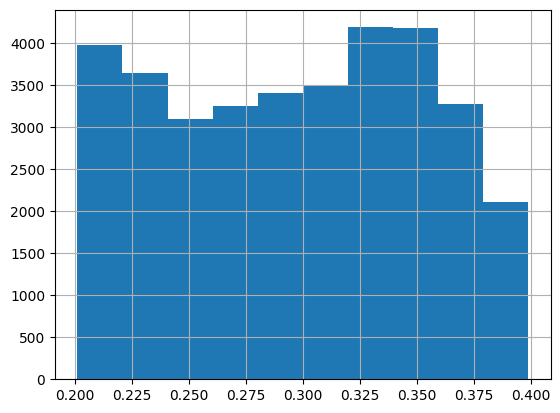

In [30]:
liveness_filter_peak_general = train_set[(train_set['liveness'] > 0.20) & (train_set['liveness'] < 0.40)]
liveness_filter_peak_general['liveness'].hist();

In [34]:
liveness_filter_peak = train_set[(train_set['liveness'] > 0.325) & (train_set['liveness'] < 0.355)]
print("Rows'liveness' more than 0.2 less than 0.4:")
print(f'{len(liveness_filter_peak)} values')
print(f'{round(len(liveness_filter_peak) / len(train_set) * 100)} % values')
liveness_filter_peak.head(5)

Rows'liveness' more than 0.2 less than 0.4:
6122 values
4 % values


,artist_name,popularity,year,genre,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,genre_group
136026,Brennan Heart,47,2021,hardstyle,0.486,0.846,0,-3.310,1,0.0777,0.062200,0.004030,0.345,0.162,153.038,241033,4,Electronic and Dance
82550,Die jungen Zillertaler,6,2019,party,0.780,0.934,5,-3.258,1,0.1160,0.285000,0.000084,0.343,0.891,126.019,161427,4,Hip-Hop and Urban
114703,Yuu Miyashita,51,2020,rock,0.726,0.740,11,-7.133,0,0.1440,0.061700,0.019200,0.351,0.914,138.979,292762,4,Rock and Metal
90529,Egypt Central,58,2020,alt-rock,0.173,0.941,5,-3.371,0,0.1610,0.000094,0.007600,0.330,0.393,194.553,173399,3,Rock and Metal
20424,Alvvays,36,2017,indie-pop,0.276,0.929,5,-3.233,1,0.0521,0.000554,0.506000,0.335,0.474,166.090,197202,4,Pop and Alternative


In [35]:
outliers_by_genre = liveness_filter_peak.groupby('genre').size()
outliers_by_genre = outliers_by_genre.sort_values(ascending=False)
print("Frequency outliers by genre:")
print(outliers_by_genre)

Frequency outliers by genre:
genre
hardstyle            392
death-metal          340
hardcore             274
forro                248
k-pop                224
dub                  216
hard-rock            203
garage               198
alt-rock             190
deep-house           189
blues                176
party                173
sertanejo            169
country              169
spanish              167
salsa                167
progressive-house    165
metal                165
dance                159
dancehall            155
drum-and-bass        151
disco                150
pop-film             143
funk                 135
hip-hop              125
chill                124
groove               110
punk                 105
singer-songwriter     98
indie-pop             94
electronic            93
cantopop              88
acoustic              80
folk                  79
soul                  74
jazz                  68
electro               59
rock                  43
piano          

##### 4.1.2.8. Valence analysis: distribution and outliers
*  Main results:
    * mean is 0.46
    * std is 0.21 -seems to be relatively high-.
    * Values range 0-1
    * Percentils insights: median is 0.43 and 75% of values are less than 0.65. More than 25% have a 0.24 value.
* Histogram shape can be interpretated as a "multimodal" with different peaks. There are no outliers to analyse.

In [36]:
percentiles = train_set['valence'].describe(percentiles=[.25, .5, .75])
print("Percentils valence':")
print(percentiles)

Percentils valence':
count    155962.000000
mean          0.455726
std           0.251882
min           0.000000
25%           0.245000
50%           0.434000
75%           0.654000
max           0.992000
Name: valence, dtype: float64


##### 4.1.2.9. Tempo analysis: distribution and outliers
*  Main results:
    * mean is 123
    * std is 30 -seems to be relatively high-.
    * Values range 0-1
    * Percentils insights: median is 123 and 75% of values are less than 144. More than 25% have a 99.9 value.
* Histogram shape can be interpretated as a "normal" with different peaks. There are  outliers to analyse less than 50 and more than 200.

In [37]:
percentiles = train_set['tempo'].describe(percentiles=[.25, .5, .75])
print("Percentils tempo':")
print(percentiles)

Percentils tempo':
count    155962.000000
mean        123.247133
std          29.910960
min           0.000000
25%          99.985000
50%         123.007000
75%         143.002750
max         247.465000
Name: tempo, dtype: float64


Outliers greater than 200 in tempo are related to various styles represent less than 0% of the data set

In [40]:
outlier_tempo_200 = train_set[train_set['tempo'] > 200]
print("Rows'tempo' more than 200:")
print(f'{len(outlier_tempo_200)} values')
print(f'{round(len(outlier_tempo_200) / len(train_set) * 100)} % values')
outlier_tempo_200.head(3)

Rows'tempo' more than 200:
766 values
0 % values


,artist_name,popularity,year,genre,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,genre_group
62247,Bobby Rush,16,2019,blues,0.566,0.700,5,-4.312,1,0.0519,0.107,0.000169,0.273,0.9620,200.085,253047,4,Jazz and Classical
189317,khai dreams,43,2023,indie-pop,0.461,0.633,9,-5.526,1,0.0347,0.491,0.000000,0.454,0.3960,200.024,168453,4,Pop and Alternative
89948,Aron Wright,31,2020,acoustic,0.210,0.413,4,-8.397,0,0.0348,0.863,0.131000,0.126,0.0908,205.719,308155,4,Country and Folk


In [41]:
outliers_by_genre = outlier_tempo_200.groupby('genre').size()
outliers_by_genre = outliers_by_genre.sort_values(ascending=False)
print("Frequency outliers by genre:")
print(outliers_by_genre)

Frequency outliers by genre:
genre
piano                49
acoustic             46
dancehall            40
garage               39
death-metal          33
blues                32
classical            31
country              30
sertanejo            29
singer-songwriter    28
k-pop                28
guitar               25
cantopop             25
folk                 22
chill                20
spanish              19
hard-rock            19
jazz                 18
alt-rock             18
dance                17
metal                17
hardcore             17
punk                 16
hardstyle            15
indie-pop            13
pop                  12
funk                 11
soul                 11
salsa                11
hip-hop              10
electronic           10
pop-film             10
rock                  7
dub                   7
party                 6
disco                 5
deep-house            4
groove                4
electro               4
forro                 3
progr

Outliers less than 50 in tempo are related to classical etc represent less than 0% of the data set

In [42]:
outlier_tempo_50 = train_set[train_set['tempo'] < 50]
print("Rows'tempo' less than 50:")
print(f'{len(outlier_tempo_50)} values')
print(f'{round(len(outlier_tempo_50) / len(train_set) * 100)} % values')
outlier_tempo_50.head(3)

Rows'tempo' less than 50:
132 values
0 % values


,artist_name,popularity,year,genre,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,genre_group
175938,Guitarricadelafuente,39,2022,spanish,0.4800,0.2440,6,-9.381,1,0.0347,0.760,0.000014,0.111,0.2950,44.785,50375,3,Regional and Ethnic
4375,Dweeb,32,2017,chill,0.8380,0.0474,1,-9.782,1,0.4090,0.312,0.946000,0.111,0.3860,38.513,49870,3,Electronic and Dance
46183,Little Symphony,18,2018,guitar,0.0581,0.1060,2,-23.457,1,0.0579,0.978,0.968000,0.673,0.0478,36.960,181935,4,Country and Folk


In [43]:
outliers_by_genre = outlier_tempo_50.groupby('genre').size()
outliers_by_genre = outliers_by_genre.sort_values(ascending=False)
print("Frequency outliers by genre:")
print(outliers_by_genre)

Frequency outliers by genre:
genre
piano                32
jazz                 15
guitar               15
classical            14
chill                11
singer-songwriter     4
hardcore              4
funk                  3
folk                  3
hip-hop               3
spanish               3
dancehall             3
garage                2
drum-and-bass         2
indie-pop             2
punk                  2
blues                 2
soul                  2
acoustic              2
electronic            1
electro               1
alt-rock              1
death-metal           1
dance                 1
k-pop                 1
country               1
pop                   1
dtype: int64


##### 4.1.2.10. Time_signature analysis: distribution and outliers
*  Main results:
    * mean is 3.9
    * std is 0.42 -seems to be relatively high-.
    * Values range 0-5
    * Percentils insights: median is 4 and 75% of values are less than 5. More than 25% have a 4 value.
* Time_signature shape can be interpretated as a "multimodal" although is concentrated in value 4, other values are outliers. Not consider a relevant feature to deep dive.

In [44]:
percentiles = train_set['time_signature'].describe(percentiles=[.25, .5, .75])
print("Percentils time_signature':")
print(percentiles)

Percentils time_signature':
count    155962.000000
mean          3.923930
std           0.383416
min           0.000000
25%           4.000000
50%           4.000000
75%           4.000000
max           5.000000
Name: time_signature, dtype: float64


##### 4.1.2.11. Duration_ms analysis: distribution and outliers
*  Main results:
    * mean is 1.55e5
    * std is 2.19e5 -seems to be relatively high-.
    * Values range 2.9e4-5.2e6
    * Percentils insights: median is 2e5 and 75% of values are less than 2.4e5. More than 25% have a 1.7e3 value.
* Histogram shape can be interpretated as a "normal". There are lots of outliers to analyse from 0.5 to 5.78

In [45]:
percentiles = train_set['duration_ms'].describe(percentiles=[.25, .5, .75])
print("Percentils Duration_ms':")
print(percentiles)

Percentils Duration_ms':
count    1.559620e+05
mean     2.195869e+05
std      9.775300e+04
min      2.946700e+04
25%      1.734248e+05
50%      2.070270e+05
75%      2.485798e+05
max      5.237296e+06
Name: duration_ms, dtype: float64


Duration outliers represent the 2% of the data, mainly classical and metal music are the ones with higher duration_ms

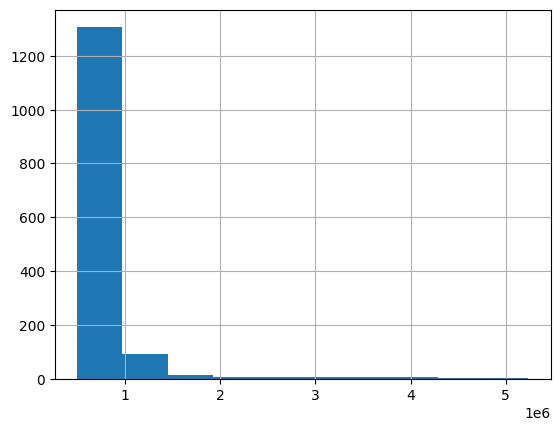

In [46]:
outlier_duration = train_set[(train_set['duration_ms'] > 0.5e6)]
outlier_duration['duration_ms'].hist();

In [47]:
print("Rows'duration' more than 0.5e6:")
print(f'{len(outlier_duration)} values')
print(f'{round(len(outlier_duration) / len(train_set) * 100)} % values')
outlier_duration.head(3)

Rows'duration' more than 0.5e6:
1459 values
1 % values


,artist_name,popularity,year,genre,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,genre_group
62427,Gov't Mule,11,2019,blues,0.281,0.798,1,-5.276,0,0.0401,0.01320,0.113,0.9340,0.222,113.655,594587,4,Jazz and Classical
38905,DJ Koze,25,2018,deep-house,0.839,0.404,0,-13.525,1,0.1090,0.00605,0.474,0.0720,0.803,117.990,590196,3,Electronic and Dance
50444,Fred Hersch Trio,37,2018,jazz,0.415,0.167,8,-19.701,1,0.0365,0.88600,0.819,0.0926,0.295,110.300,514897,4,Jazz and Classical


In [48]:
outliers_by_genre = outlier_duration.groupby('genre').size()
outliers_by_genre = outliers_by_genre.sort_values(ascending=False)
print("Frequency outliers by genre:")
print(outliers_by_genre)

Frequency outliers by genre:
genre
classical            208
blues                147
pop-film             112
salsa                 96
death-metal           86
hard-rock             78
deep-house            63
guitar                58
jazz                  53
disco                 53
funk                  45
electronic            42
drum-and-bass         35
spanish               32
alt-rock              28
cantopop              26
singer-songwriter     26
folk                  25
progressive-house     22
metal                 22
forro                 20
groove                20
garage                19
dub                   19
piano                 17
acoustic              14
hardcore              12
dancehall             10
sertanejo              9
country                8
punk                   8
hardstyle              7
rock                   6
k-pop                  5
chill                  5
party                  5
house                  4
pop                    3
hip-hop        

Classical music seems to be an outlier, we keep it in the model but to be taken into account

##### 4.1.2.12. TARGET= Popularity analysis: distribution and outliers
*  Main results:
    * mean is 32
    * std is 15 -seems to be relatively medium high-.
    * Values range 1-100
    * Percentils insights: median is 32 and 75% of values are less than 44. More than 25% have a 22 value.
    * Percentils results seem to show us rara avis with high popularity, this will may make difficult to predict higher popularity values
* Histogram shape can be interpretated as a "cola larga a la derecha". There are ouliers to analyse with popularity higher than 70.

In [11]:
percentiles = train_set['popularity'].describe(percentiles=[.25, .5, .75])
print("Percentils popularity':")
print(percentiles)

Percentils popularity':
count    155962.000000
mean         32.883407
std          15.198929
min           1.000000
25%          22.000000
50%          32.000000
75%          43.000000
max         100.000000
Name: popularity, dtype: float64


<Axes: xlabel='popularity', ylabel='Count'>

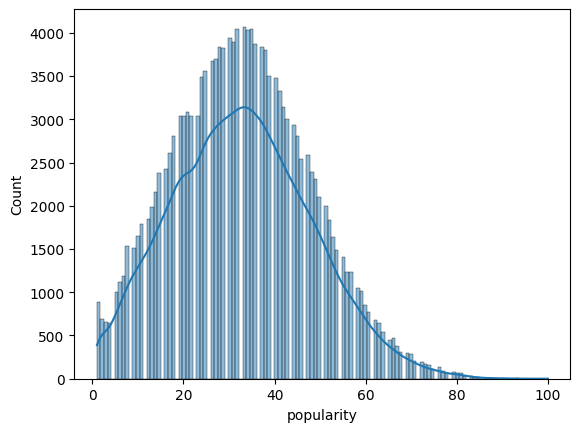

In [76]:
sns.histplot(train_set[target], kde = True)

Two statements affect to popularity, in general de latest song have more popularity and genres as pop are more popular than others

In general, popularity is increasing except for 2022

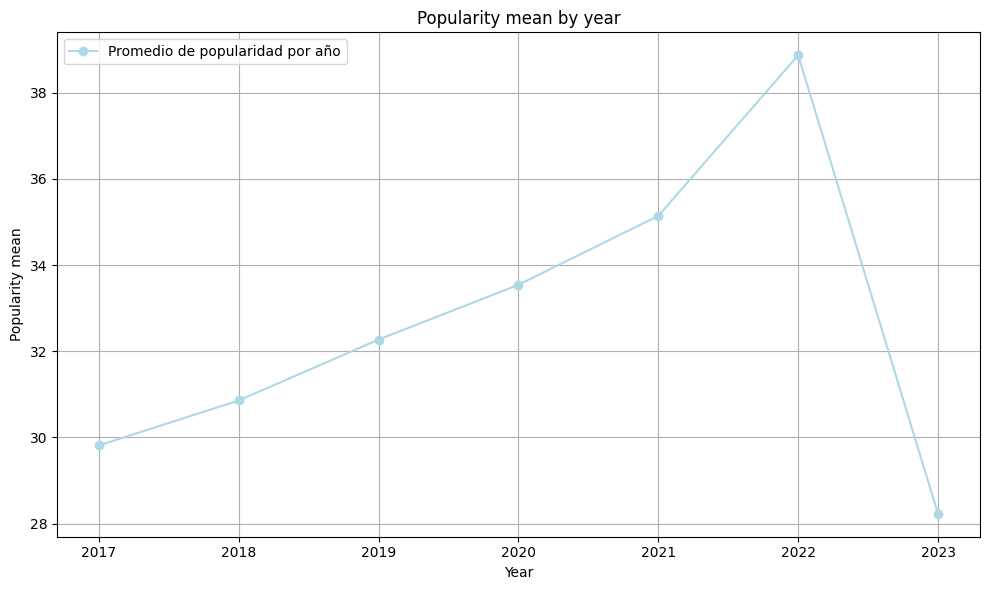

In [77]:
average_popularity = train_set.groupby('year')['popularity'].mean().reset_index()
average_popularity = average_popularity.sort_values(by='year')

plt.figure(figsize=(10, 6))
color = 'lightblue'
plt.plot(average_popularity['year'], average_popularity['popularity'], marker='o', linestyle='-', color=color, label='Promedio de popularidad por año')
plt.title('Popularity mean by year')
plt.xlabel('Year')
plt.ylabel('Popularity mean')
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

Genres as pop, rock or hip hop are the main popular

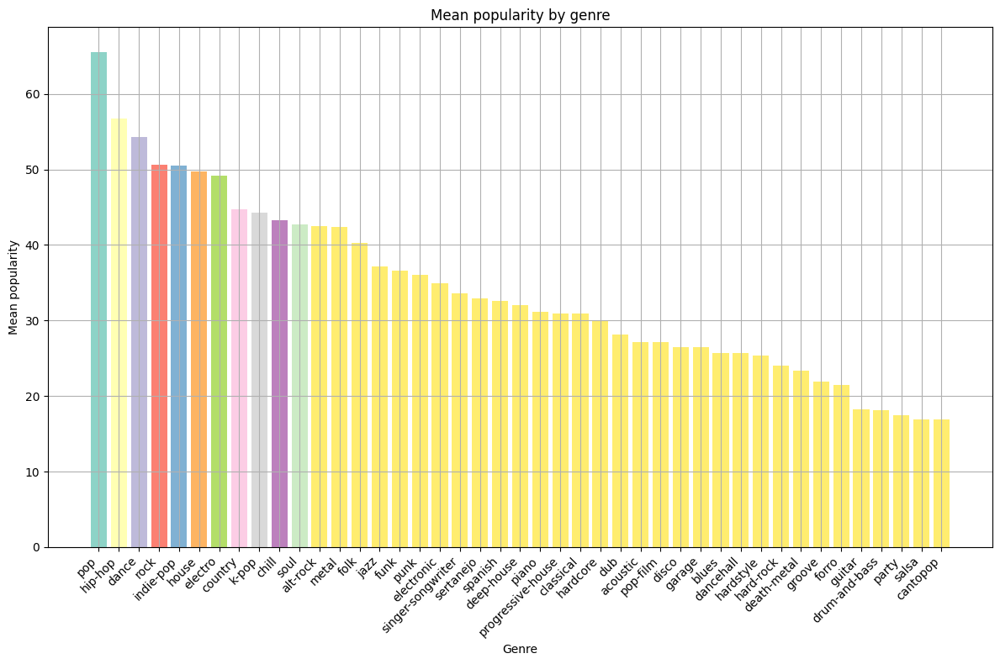

In [78]:
average_popularity_genre = train_set.groupby('genre')['popularity'].mean().reset_index()
average_popularity_genre = average_popularity_genre.sort_values(by='popularity', ascending=False)
plt.figure(figsize=(12, 8))
colors = plt.cm.Set3(range(len(average_popularity_genre)))
plt.bar(average_popularity_genre['genre'], average_popularity_genre['popularity'], color=colors)
plt.title('Mean popularity by genre')
plt.xlabel('Genre')
plt.ylabel('Mean popularity')
plt.xticks(rotation=45, ha='right')
plt.grid(True)
plt.tight_layout()
plt.show()

##### Popularity ouliers':

Important to be mentionated, the business case target is related to achieve high popularity, this data set only 1% of values have popularity greater than 60. This problem can be solved by the size of the data, more than 13.000 values have popularity >70

Histogram showed ouliers with popularity higher than 70,we will explore outliers -values with popularity higher than 70-. But first, let´s understand the lowest popularity values.

Filtering by popularity less than 5 we don´t find any relevant insight or definitive pattern

In [12]:
bt.value_table_filtered(train_set, 'popularity', 'less_than', 5, None)

year - popularity less than 5:
-----------------------------------------------------
year                 Count      %         
-----------------------------------------------------
2023.0               1213.0     42.12     
2017.0               464.0      16.11     
2018.0               427.0      14.83     
2019.0               273.0      9.48      
2020.0               229.0      7.95      
2022.0               138.0      4.79      
2021.0               136.0      4.72      


danceability - popularity less than 5:
-----------------------------------------------------
danceability         Count      %         
-----------------------------------------------------
0.595                15.0       0.52      
0.505                13.0       0.45      
0.599                13.0       0.45      
0.717                12.0       0.42      
0.611                12.0       0.42      
0.492                12.0       0.42      
0.675                11.0       0.38      
0.504                11.

{'year':    year  Count          %
 0  2023   1213  42.118056
 1  2017    464  16.111111
 2  2018    427  14.826389
 3  2019    273   9.479167
 4  2020    229   7.951389
 5  2022    138   4.791667
 6  2021    136   4.722222,
 'danceability':      danceability  Count         %
 0           0.595     15  0.520833
 2           0.505     13  0.451389
 1           0.599     13  0.451389
 3           0.717     12  0.416667
 4           0.611     12  0.416667
 ..            ...    ...       ...
 612         0.376      1  0.034722
 613         0.180      1  0.034722
 614         0.191      1  0.034722
 615         0.269      1  0.034722
 706         0.299      1  0.034722
 
 [707 rows x 3 columns],
 'energy':      energy  Count         %
 0    0.9140     11  0.381944
 2    0.8190     11  0.381944
 3    0.9010     11  0.381944
 4    0.9890     11  0.381944
 5    0.7180     11  0.381944
 ..      ...    ...       ...
 780  0.0467      1  0.034722
 779  0.0359      1  0.034722
 778  0.2430      1 

Popularity outliers, >70

Describe() shows the high values of percentiles in danceability. Energy seems to have a pattern of positive correlation, with more difference in percentiles. Meanwhile valence, key or loudness have a lot of differente values with popularity higher than 70.

In [13]:
popularity_greater_than_60 = train_set[(train_set['popularity'] > 70)]
popularity_greater_than_60.describe()

,popularity,year,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
count,1487.000000,1487.000000,1487.000000,1487.000000,1487.000000,1487.000000,1487.000000,1487.000000,1487.000000,1487.000000,1487.000000,1487.000000,1487.000000,1487.000000,1487.000000
mean,75.751849,2020.392065,0.662389,0.633125,5.347007,-6.355024,0.585743,0.103622,0.261777,0.017722,0.189018,0.496330,121.647075,197421.293880,3.932751
std,4.341374,1.925326,0.140260,0.177030,3.590865,2.580283,0.492759,0.099564,0.260525,0.097994,0.157145,0.222527,28.767728,44662.866464,0.349269
min,71.000000,2017.000000,0.215000,0.040000,0.000000,-23.023000,0.000000,0.023200,0.000055,0.000000,0.021500,0.034800,58.814000,51914.000000,1.000000
25%,72.000000,2019.000000,0.572500,0.518000,2.000000,-7.675000,0.000000,0.039800,0.048950,0.000000,0.096250,0.324500,98.310000,170053.500000,4.000000
50%,75.000000,2021.000000,0.671000,0.649000,5.000000,-5.943000,1.000000,0.058400,0.168000,0.000000,0.124000,0.489000,120.077000,193832.000000,4.000000
75%,78.000000,2022.000000,0.765500,0.768000,8.000000,-4.607000,1.000000,0.128500,0.418500,0.000089,0.225000,0.664000,140.062000,220283.500000,4.000000
max,100.000000,2023.000000,0.970000,0.989000,11.000000,1.295000,1.000000,0.595000,0.981000,0.957000,0.979000,0.965000,210.164000,613027.000000,5.000000


In the latest years popularity has increased, except 2023

In [14]:
bt.value_table_filtered(train_set, 'popularity', 'greater_than', 70)

year - popularity greater than 70:
-----------------------------------------------------
year                 Count      %         
-----------------------------------------------------
2022.0               441.0      29.66     
2021.0               213.0      14.32     
2019.0               186.0      12.51     
2018.0               169.0      11.37     
2023.0               163.0      10.96     
2017.0               159.0      10.69     
2020.0               156.0      10.49     


danceability - popularity greater than 70:
-----------------------------------------------------
danceability         Count      %         
-----------------------------------------------------
0.676                11.0       0.74      
0.707                10.0       0.67      
0.704                9.0        0.61      
0.584                8.0        0.54      
0.575                8.0        0.54      
0.695                8.0        0.54      
0.795                8.0        0.54      
0.509           

{'year':    year  Count          %
 0  2022    441  29.657028
 1  2021    213  14.324143
 2  2019    186  12.508406
 3  2018    169  11.365165
 4  2023    163  10.961668
 5  2017    159  10.692670
 6  2020    156  10.490921,
 'danceability':      danceability  Count         %
 0           0.676     11  0.739744
 1           0.707     10  0.672495
 2           0.704      9  0.605245
 3           0.584      8  0.537996
 4           0.575      8  0.537996
 ..            ...    ...       ...
 416         0.511      1  0.067249
 418         0.570      1  0.067249
 419         0.379      1  0.067249
 420         0.900      1  0.067249
 520         0.351      1  0.067249
 
 [521 rows x 3 columns],
 'energy':      energy  Count         %
 0     0.546      8  0.537996
 1     0.713      8  0.537996
 2     0.768      7  0.470746
 3     0.649      7  0.470746
 4     0.585      7  0.470746
 ..      ...    ...       ...
 471   0.654      1  0.067249
 472   0.316      1  0.067249
 473   0.346      1 

In [18]:
outlier_popularity = train_set[train_set['popularity'] > 70]
print("Rows'popularity' greater than 60:")
print(f'{len(outlier_popularity)} values')
print(f'{round(len(outlier_popularity) / len(train_set) * 100)} % values')
outlier_popularity.head(10)

Rows'popularity' greater than 60:
1487 values
1 % values


,artist_name,popularity,year,genre,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,genre_group
179797,P!nk,81,2023,dance,0.636,0.888,8,-3.889,1,0.0945,0.001620,0.000216,0.1470,0.2500,122.032,237200,4,Electronic and Dance
35731,The Chainsmokers,72,2018,dance,0.575,0.571,1,-7.906,1,0.0439,0.055800,0.000000,0.0912,0.4490,105.049,197947,4,Electronic and Dance
152396,Jordan Davis,74,2022,country,0.675,0.726,2,-6.459,1,0.0461,0.105000,0.000000,0.1530,0.6710,124.872,186791,4,Country and Folk
150750,keshi,82,2022,chill,0.577,0.366,8,-11.792,1,0.0368,0.879000,0.000078,0.1370,0.0841,129.923,212785,4,Electronic and Dance
173817,Gusttavo Lima,71,2022,sertanejo,0.541,0.713,0,-4.313,1,0.0368,0.586000,0.000000,0.6610,0.2850,110.414,187381,4,Regional and Ethnic
189106,Måneskin,71,2023,indie-pop,0.684,0.759,1,-4.780,0,0.0259,0.000902,0.000179,0.0486,0.6870,114.014,191856,4,Pop and Alternative
112989,Miley Cyrus,78,2020,pop,0.699,0.805,4,-5.535,0,0.0345,0.001610,0.001770,0.2490,0.2320,109.976,223280,4,Pop and Alternative
179552,Morgan Wallen,80,2023,country,0.498,0.764,4,-5.006,1,0.0309,0.123000,0.000031,0.1190,0.4890,147.984,191231,4,Country and Folk
71423,Billie Eilish,81,2019,electro,0.701,0.425,7,-10.965,1,0.3750,0.328000,0.130000,0.1000,0.5620,135.128,194088,4,Electronic and Dance
161274,Mc Jacaré,79,2022,funk,0.921,0.550,3,-4.736,0,0.3690,0.196000,0.000014,0.0947,0.8480,129.847,122995,4,Electronic and Dance


Genres as hip-hop, pop or dance are more common with higher popularity

In [19]:
outliers_by_genre = outlier_popularity.groupby('genre').size()
outliers_by_genre = outliers_by_genre.sort_values(ascending=False)
print("Frequency outliers by genre:")
print(outliers_by_genre)

Frequency outliers by genre:
genre
pop                  428
hip-hop              308
dance                248
k-pop                 89
country               88
indie-pop             59
funk                  46
electro               44
sertanejo             40
chill                 22
rock                  17
alt-rock              14
singer-songwriter     12
house                 11
folk                  10
metal                  9
pop-film               7
forro                  5
soul                   4
acoustic               4
jazz                   4
spanish                3
piano                  2
hardstyle              2
hard-rock              2
punk                   2
disco                  2
deep-house             2
blues                  2
garage                 1
dtype: int64


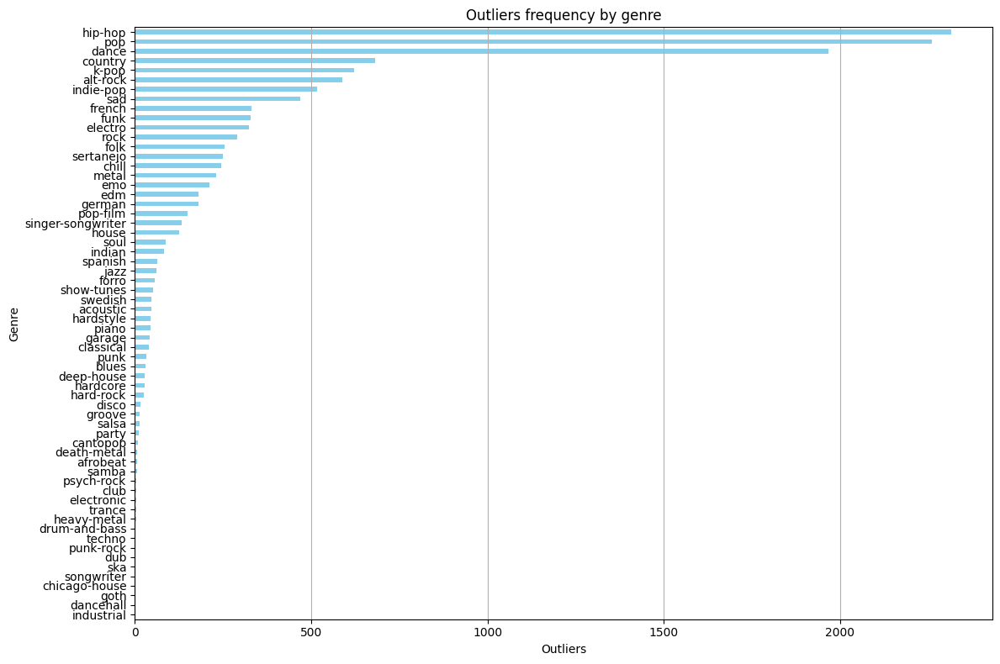

In [84]:
# Figure
plt.figure(figsize=(12, 8))
outliers_by_genre.sort_values().plot(kind='barh', color='skyblue')
plt.title('Outliers frequency by genre')
plt.xlabel('Outliers')
plt.ylabel('Genre')
plt.grid(axis='x')
plt.tight_layout()
plt.show()

Artist as Taylor Swift, Drake or BTS are more common with higher popularity

In [85]:
outliers_by_artist = outlier_popularity.groupby('artist_name').size()
outliers_by_artist = outliers_by_genre.sort_values(ascending=False)
print("Frequency outliers by artist_name:")
print(outliers_by_artist)

Frequency outliers by artist_name:
genre
hip-hop          2316
pop              2260
dance            1967
country           682
k-pop             623
                 ... 
chicago-house       2
goth                2
techno              2
dancehall           1
industrial          1
Length: 62, dtype: int64


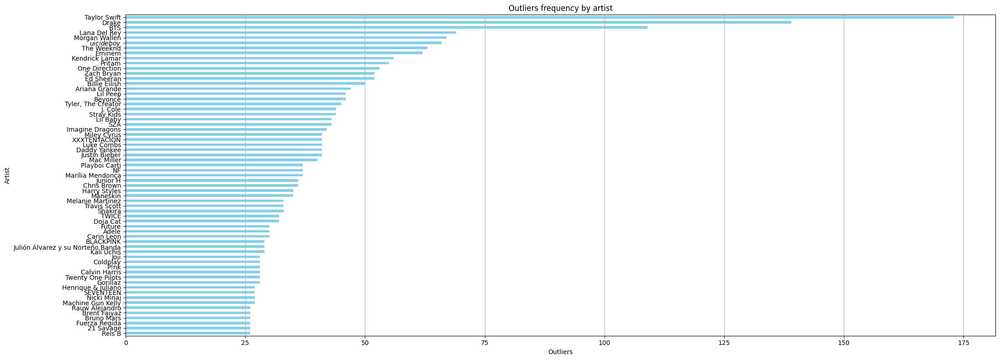

In [86]:
outlier_popularity['artist_name'] = outlier_popularity['artist_name'].str.replace('Joey Bada$$', 'Joey Badas$') # Artist error in figure execution adjustment
outliers_by_artist = outlier_popularity['artist_name'].value_counts()
filtered_outliers_by_artist = outliers_by_artist[outliers_by_artist > 25] # TOP 25
plt.figure(figsize=(22, 8))
filtered_outliers_by_artist.sort_values().plot(kind='barh', color='skyblue')
plt.title('Outliers frequency by artist')
plt.xlabel('Outliers')
plt.ylabel('Artist')
plt.grid(axis='x')
plt.tight_layout()
plt.show()

### **4.2. Bivariate  / Multivariete**
.............................................................................................................................
#### **Planification:**

4.2.1. Bivariant/Multivariant:
* Popularity vs numerical features. As far as we have seen, we already see artist, genre and year influence on popularity.
* Regression
* Colinearity matrix


4.2.2.Features selection

.............................................................................................................................

#### **4.2.1. Bivariant/Multivariant**

Some more inputs related to popularity and genre, main input is that percentile 25 and 50% of genres more popular are higher.

##### Describe popularity/genre

In [87]:
pd.set_option('display.max_rows', None)
train_set.groupby("genre")["popularity"].describe()

,count,mean,std,min,25%,50%,75%,max
genre,,,,,,,,
acoustic,4914.0,27.111925,11.575542,1.0,19.0,26.0,35.0,79.0
alt-rock,4681.0,42.484512,8.602364,1.0,36.0,42.0,48.0,84.0
blues,4632.0,25.740501,9.392703,1.0,19.0,25.0,31.0,74.0
cantopop,3335.0,16.888156,11.796303,1.0,8.0,14.0,24.0,69.0
chill,5123.0,43.239508,8.634302,1.0,38.0,42.0,48.0,82.0
classical,3597.0,30.891854,10.534003,1.0,25.0,30.0,37.0,66.0
country,4371.0,44.751544,10.833081,5.0,37.0,43.0,51.0,88.0
dance,4133.0,54.249940,10.048826,1.0,48.0,53.0,60.0,93.0
dancehall,4670.0,25.735760,9.813379,1.0,18.0,25.0,32.0,61.0


##### Popularity evolution

How popularity evolutionates in each genre, shown by genre group because of the size of genres, prevalence of hip-hop of urban popularity. Latest years there are less instances and year 2022 with less instances than 2021 go down in popularity

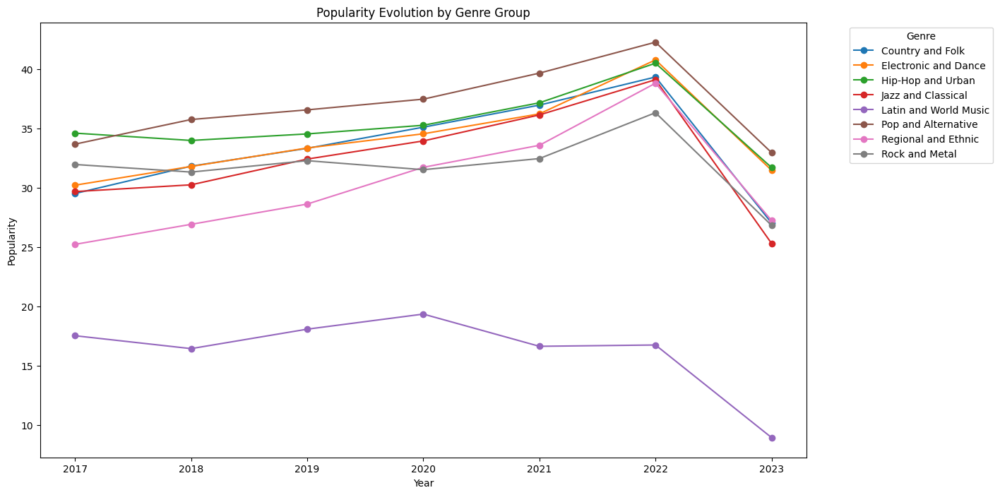

In [88]:
genre_popularity_year = train_set.groupby(['genre_group', 'year'])['popularity'].mean().unstack(level=0)
fig, ax = plt.subplots(figsize=(14, 8))
genre_popularity_year.plot(marker='o', linestyle='-', ax=ax)
ax.set_xlabel('Year')
ax.set_ylabel('Popularity')
ax.set_title('Popularity Evolution by Genre Group')
ax.legend(title='Genre', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

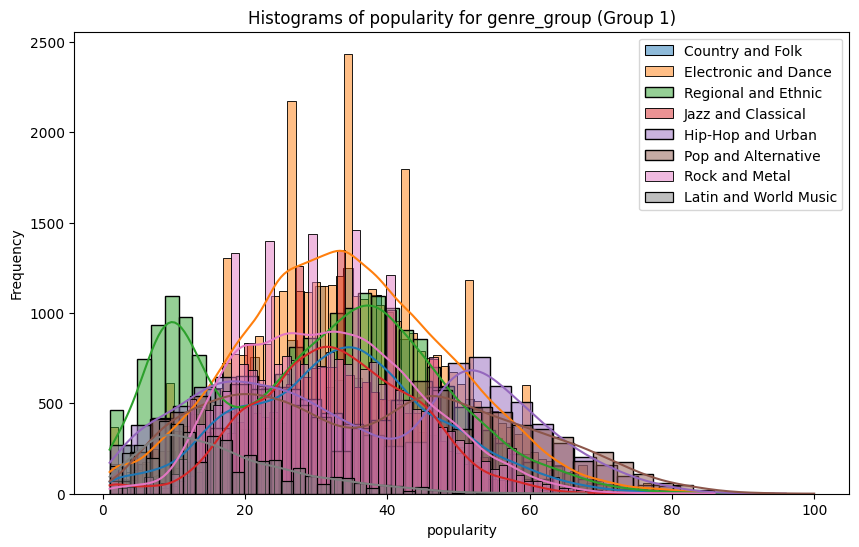

In [89]:
bt.plot_grouped_histograms(train_set,"genre_group","popularity",group_size=11)

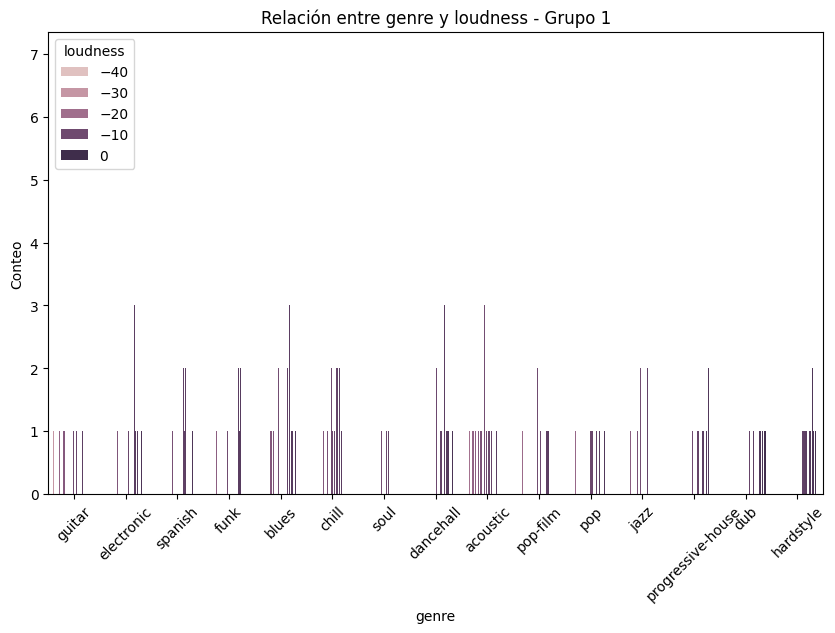

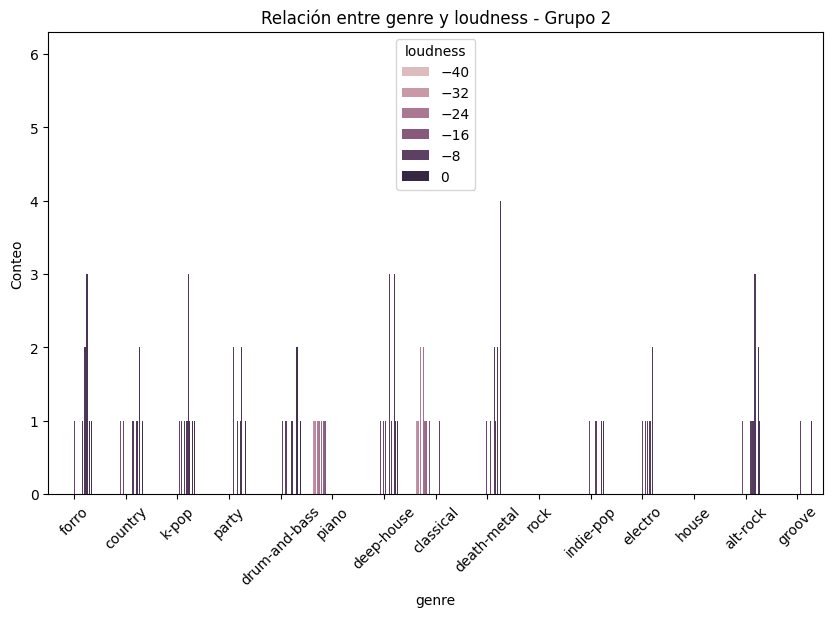

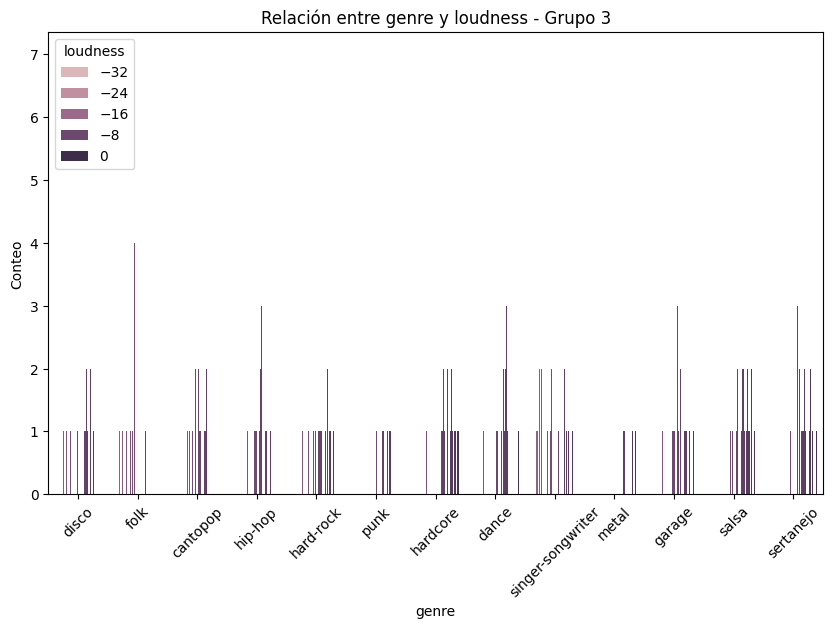

In [90]:
bt.plot_categorical_relationship_fin(train_set,'genre', 'loudness', relative_freq=False, show_values=False, size_group = 15)

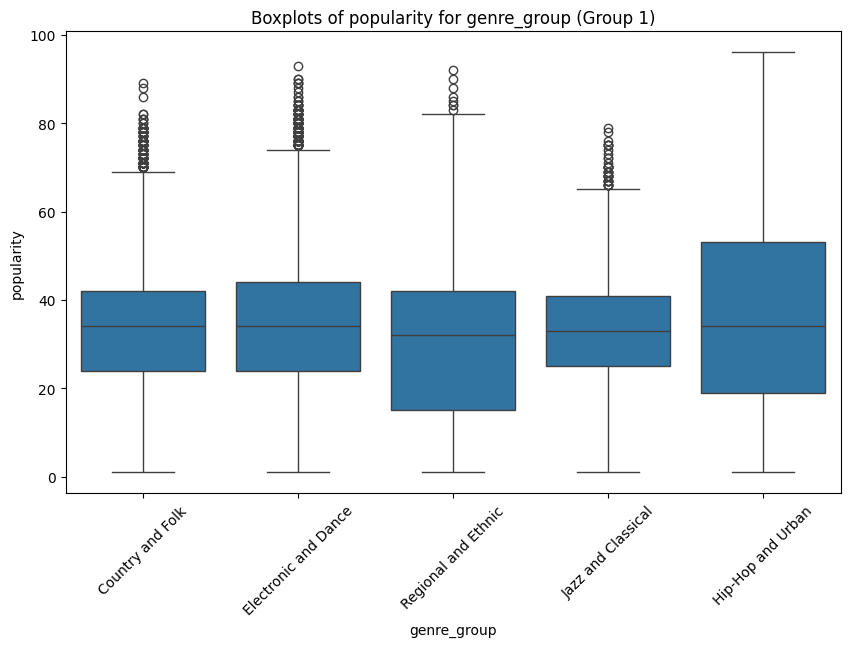

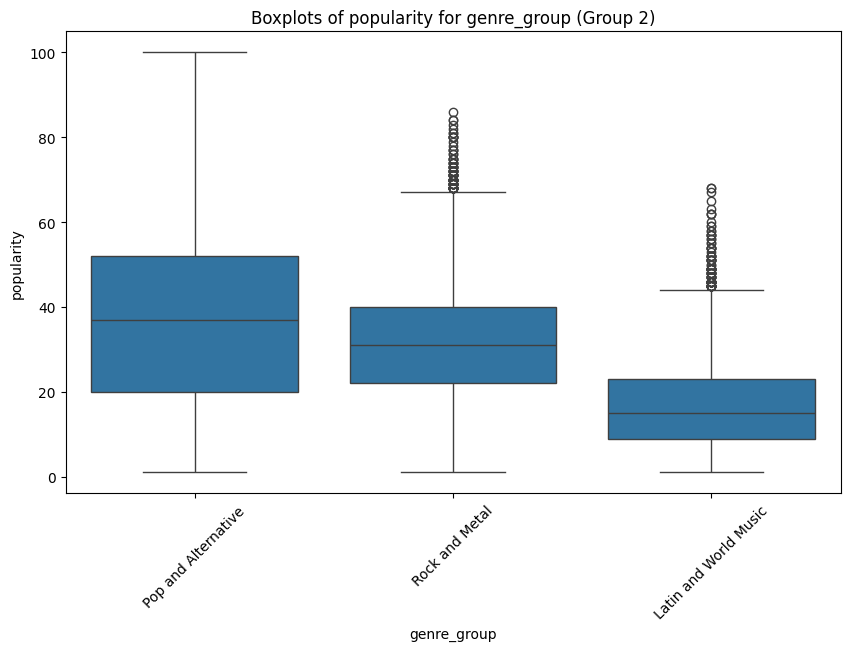

In [91]:
bt.plot_grouped_boxplots(train_set, "genre_group", "popularity")

As shown in next plot features visual relationship with popularity is difficult to provide conclusions due to larga ranges values

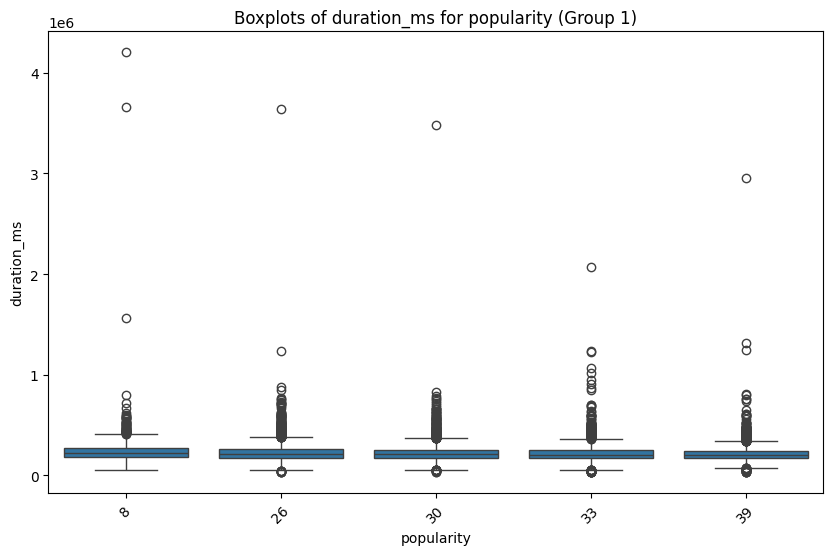

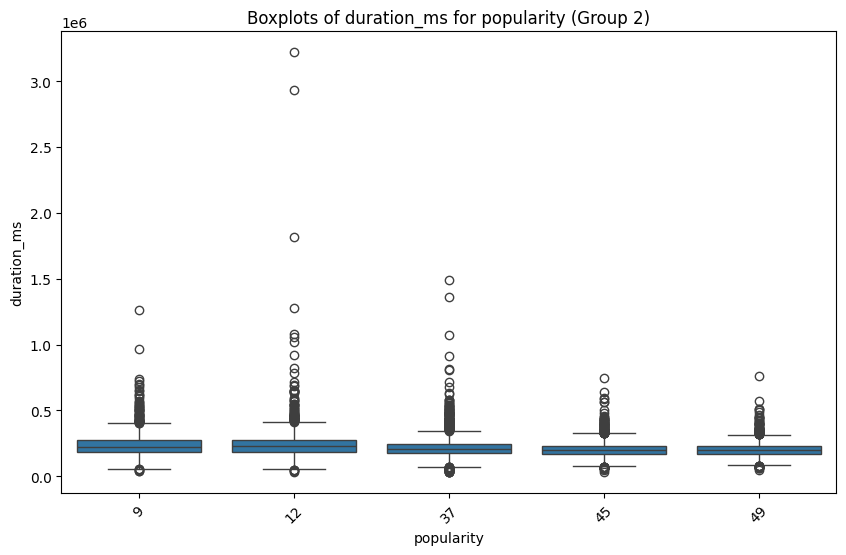

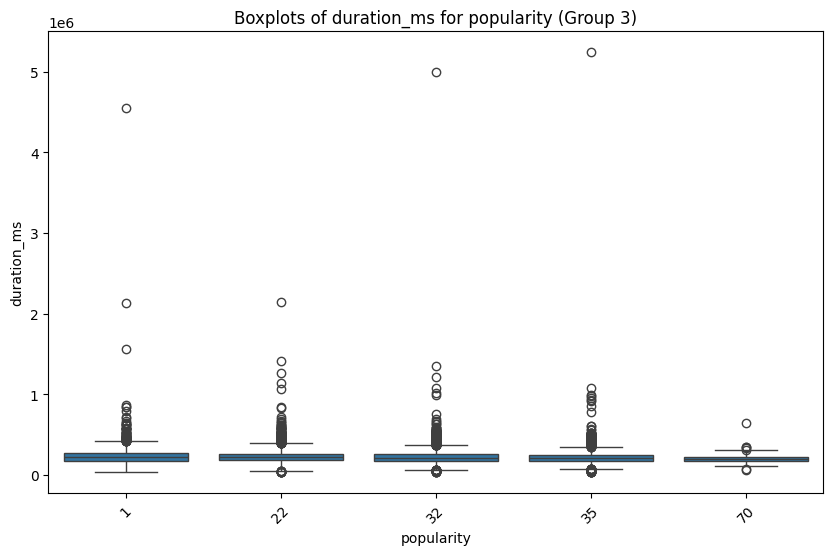

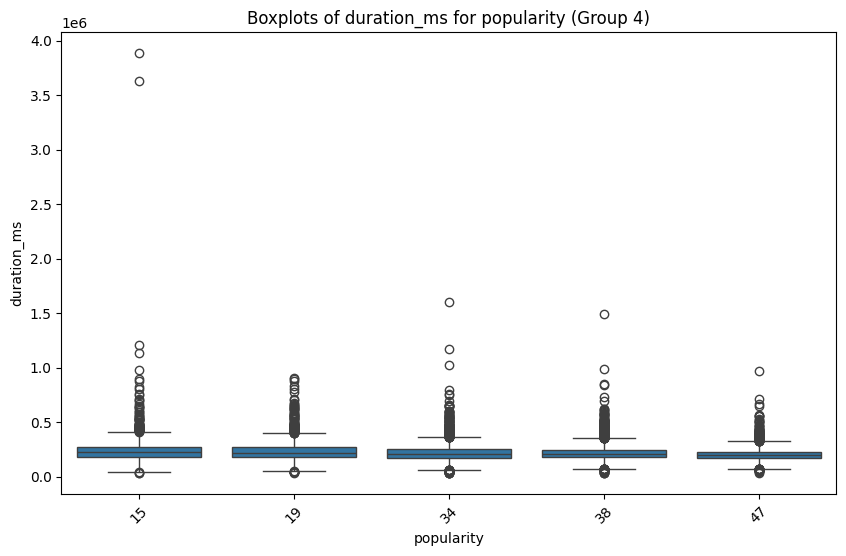

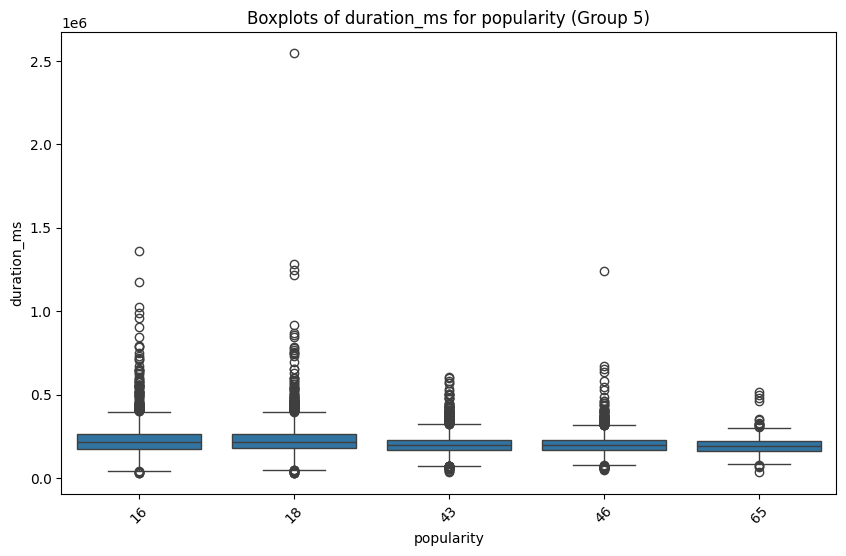

...

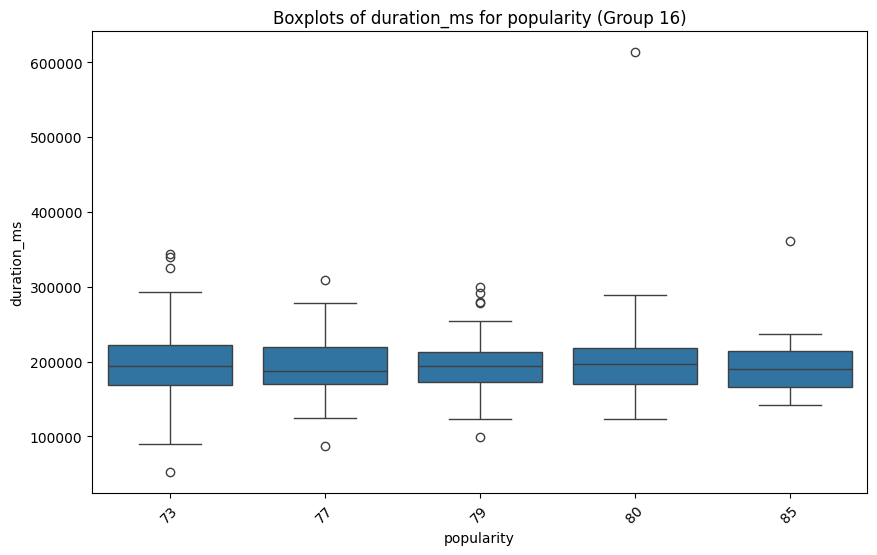

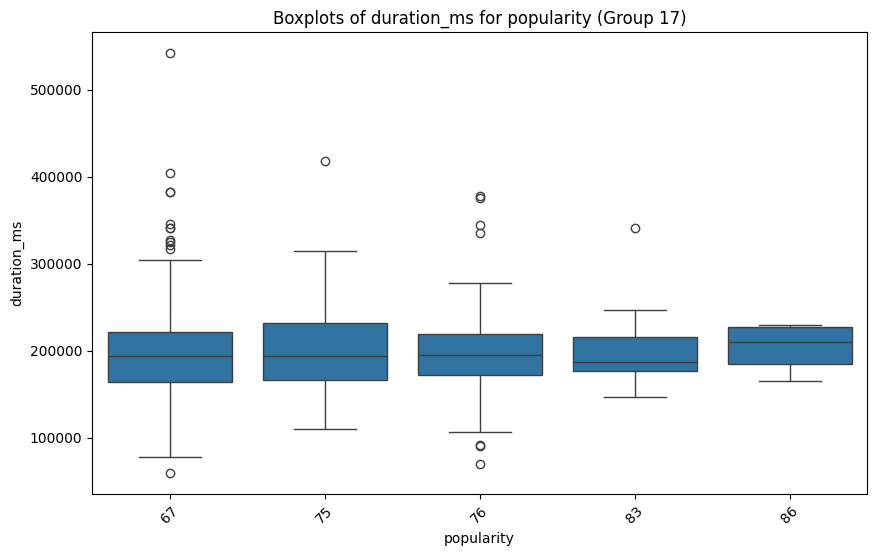

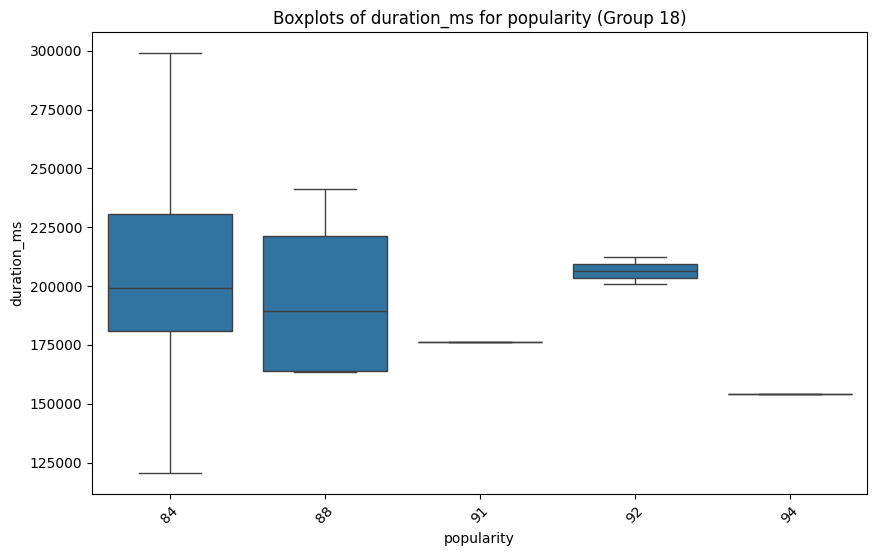

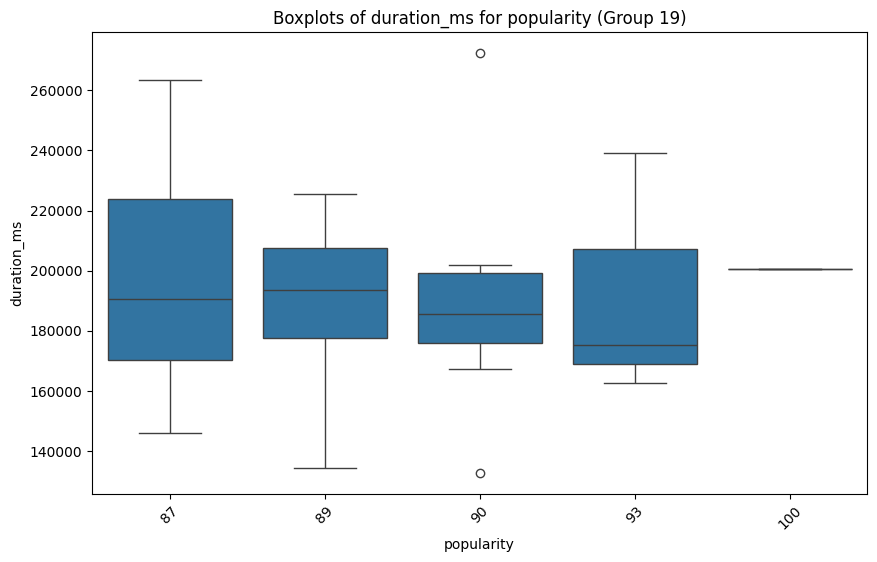

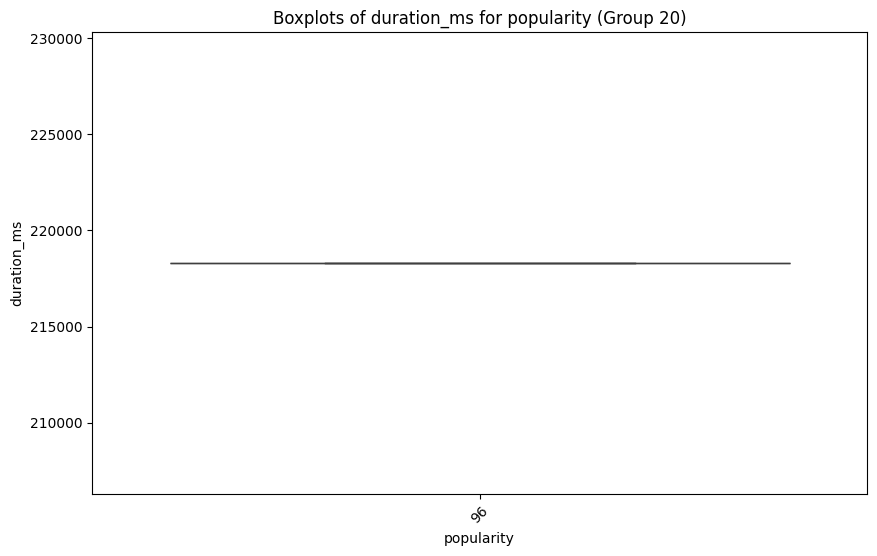

In [24]:
bt.plot_grouped_boxplots(train_set,  "popularity","duration_ms")

Let´s start correlation analysis

Popularity is vinculated to year, instrumental, duration, danceability and liveness mainly

In [92]:
print(" Correlation with target")
corr = train_set.corr(numeric_only= True)
correlations_with_target = np.abs(np.abs(corr[target]).sort_values(ascending=False))
correlations_with_target

 Correlation with target


popularity          1.000000
duration_ms         0.145454
instrumentalness    0.141190
danceability        0.127397
year                0.098867
liveness            0.081357
energy              0.077282
speechiness         0.051018
tempo               0.040681
loudness            0.035239
acousticness        0.027037
mode                0.021486
valence             0.019238
time_signature      0.013796
key                 0.000790
Name: popularity, dtype: float64

In [93]:
print(" Correlation with target above 0.03")
target= 'popularity'
correlations_with_target = correlations_with_target.drop(target)
features_above_threshold = correlations_with_target[correlations_with_target > 0.03]
features_above_threshold

 Correlation with target above 0.03


duration_ms         0.145454
instrumentalness    0.141190
danceability        0.127397
year                0.098867
liveness            0.081357
energy              0.077282
speechiness         0.051018
tempo               0.040681
loudness            0.035239
Name: popularity, dtype: float64

Pearson correlation manual to have the sense (+ or - ) and p value, high evidence agaisnt nule hypothesis, therefore there is correlation:

In [94]:
numerical_columns_list = train_set.select_dtypes(include=[np.number]).columns.tolist()
results = {}
for col in numerical_columns_list:
    coef_pearson, p_valor = pearsonr(train_set["popularity"], train_set[col])
    results[col] = {'coef_pearson': coef_pearson, 'p_valor': p_valor}
for col, result in results.items():
    print(f"Pearson coef for '{col}': {result['coef_pearson']:.4f},  p-value: {result['p_valor']:.4f}")

Pearson coef for 'popularity': 1.0000,  p-value: 0.0000
Pearson coef for 'year': 0.0989,  p-value: 0.0000
Pearson coef for 'danceability': 0.1274,  p-value: 0.0000
Pearson coef for 'energy': -0.0773,  p-value: 0.0000
Pearson coef for 'key': 0.0008,  p-value: 0.7550
Pearson coef for 'loudness': 0.0352,  p-value: 0.0000
Pearson coef for 'mode': -0.0215,  p-value: 0.0000
Pearson coef for 'speechiness': 0.0510,  p-value: 0.0000
Pearson coef for 'acousticness': -0.0270,  p-value: 0.0000
Pearson coef for 'instrumentalness': -0.1412,  p-value: 0.0000
Pearson coef for 'liveness': -0.0814,  p-value: 0.0000
Pearson coef for 'valence': -0.0192,  p-value: 0.0000
Pearson coef for 'tempo': -0.0407,  p-value: 0.0000
Pearson coef for 'duration_ms': -0.1455,  p-value: 0.0000
Pearson coef for 'time_signature': 0.0138,  p-value: 0.0000


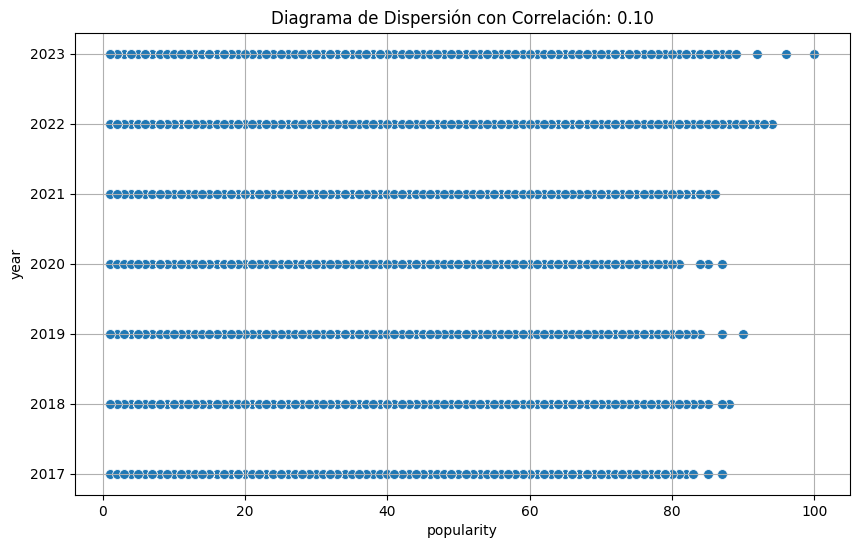

Pearson coef: 0.09886684890222408
P-value 0.0


In [95]:
bt.grafico_dispersion_con_correlacion(train_set, "popularity", "year", 50, mostrar_correlacion=True)
correlacion_pearson = train_set[["popularity", "year"]].corr()
coef_pearson, p_valor = pearsonr(train_set["popularity"], train_set["year"])
print("Pearson coef:", coef_pearson)
print("P-value", p_valor)

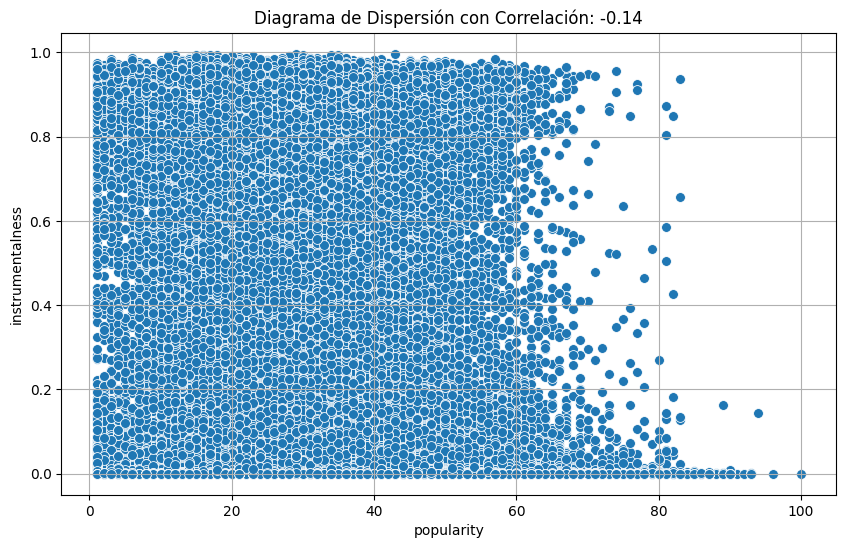

Pearson coef: -0.14118988158590853
P-value 0.0


In [96]:
bt.grafico_dispersion_con_correlacion(train_set, "popularity", "instrumentalness", 50, mostrar_correlacion=True)
correlacion_pearson = train_set[["popularity", "instrumentalness"]].corr()
coef_pearson, p_valor = pearsonr(train_set["popularity"], train_set["instrumentalness"])
print("Pearson coef:", coef_pearson)
print("P-value", p_valor)

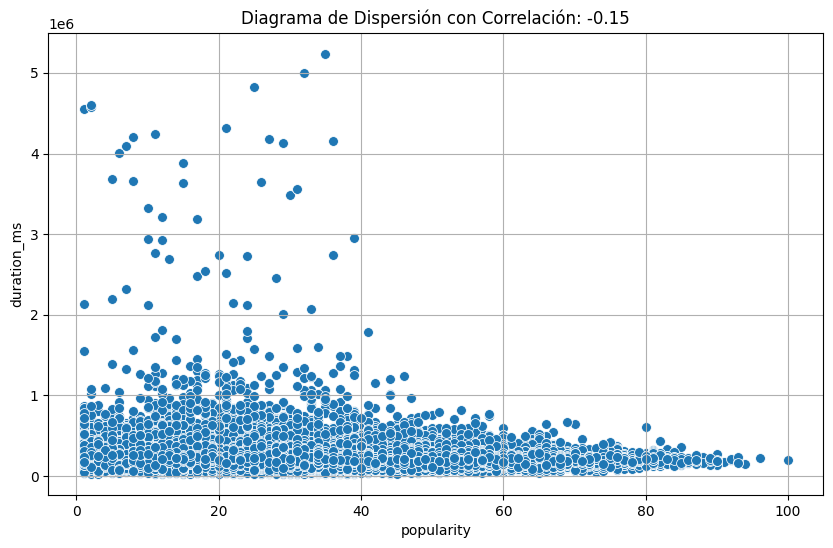

Pearson coef: -0.1454540155595302
P-value 0.0


In [97]:
bt.grafico_dispersion_con_correlacion(train_set, "popularity", "duration_ms", 50, mostrar_correlacion=True)
correlacion_pearson = train_set[["popularity", "duration_ms"]].corr()
coef_pearson, p_valor = pearsonr(train_set["popularity"], train_set["duration_ms"])
print("Pearson coef:", coef_pearson)
print("P-value", p_valor)

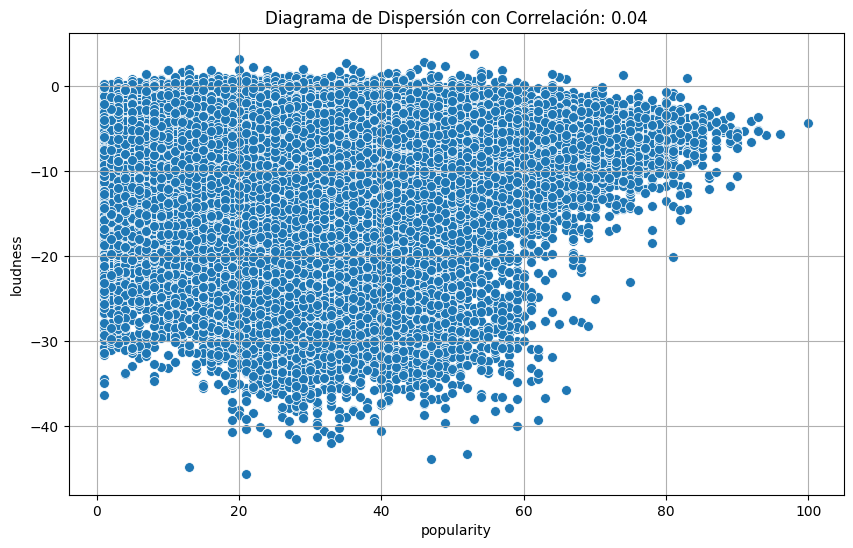

Pearson coef: 0.035239398792388646
P-value 4.724890240591167e-44


In [98]:
bt.grafico_dispersion_con_correlacion(train_set, "popularity", "loudness", 50, mostrar_correlacion=True)
correlacion_pearson = train_set[["popularity", "loudness"]].corr()
coef_pearson, p_valor = pearsonr(train_set["popularity"], train_set["loudness"])
print("Pearson coef:", coef_pearson)
print("P-value", p_valor)

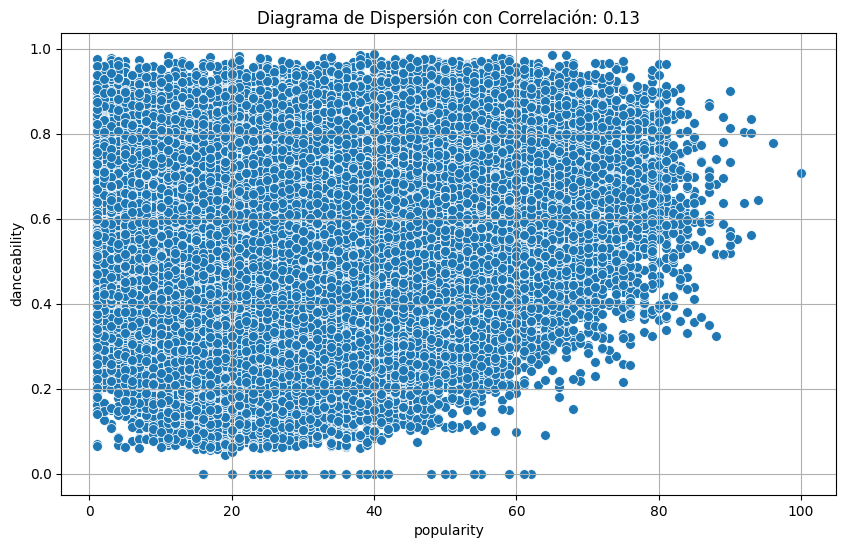

Pearson coef: 0.12739654210135787
P-value 0.0


In [99]:
bt.grafico_dispersion_con_correlacion(train_set, "popularity", "danceability", 50, mostrar_correlacion=True)
correlacion_pearson = train_set[["popularity", "danceability"]].corr()
coef_pearson, p_valor = pearsonr(train_set["popularity"], train_set["danceability"])
print("Pearson coef:", coef_pearson)
print("P-value", p_valor)

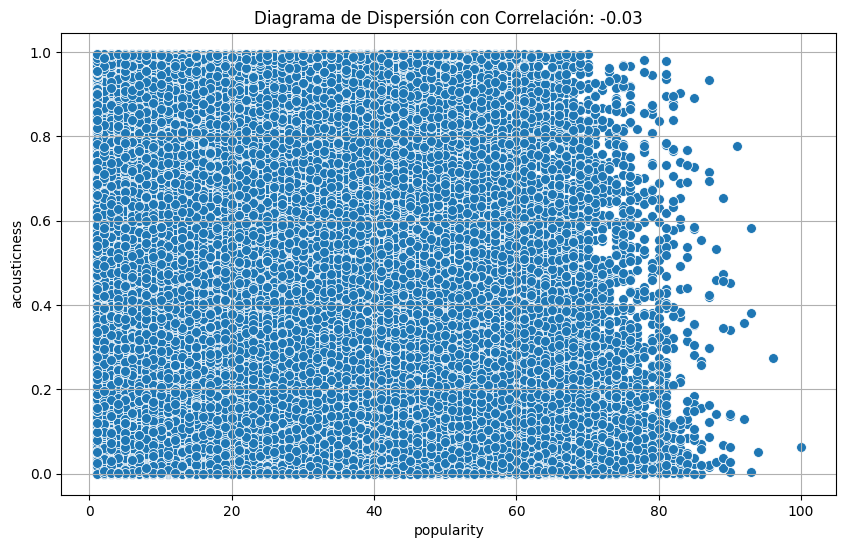

Pearson coef: -0.02703668547714258
P-value 1.2736328824796383e-26


In [100]:
bt.grafico_dispersion_con_correlacion(train_set, "popularity", "acousticness", 50, mostrar_correlacion=True)
correlacion_pearson = train_set[["popularity", "acousticness"]].corr()
coef_pearson, p_valor = pearsonr(train_set["popularity"], train_set["acousticness"])
print("Pearson coef:", coef_pearson)
print("P-value", p_valor)

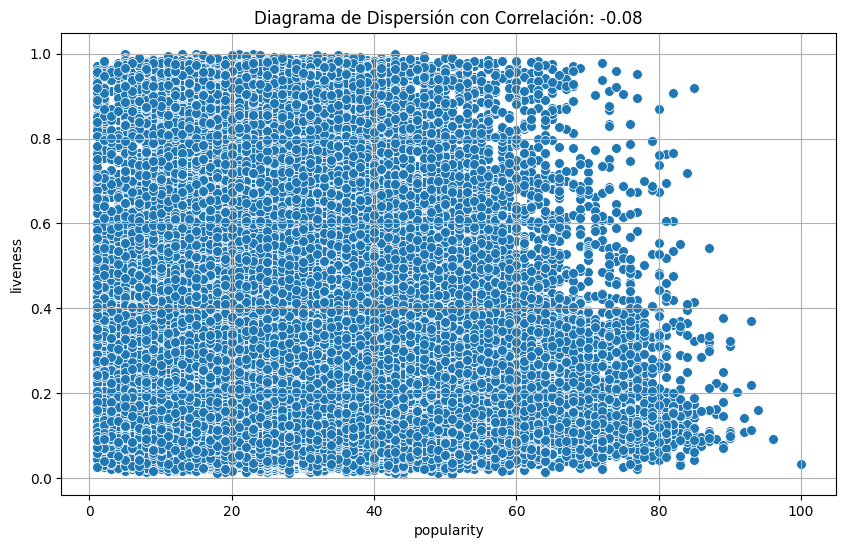

Pearson coef: -0.08135702115800145
P-value 3.088413046225133e-227


In [101]:
bt.grafico_dispersion_con_correlacion(train_set, "popularity", "liveness", 50, mostrar_correlacion=True)
correlacion_pearson = train_set[["popularity", "liveness"]].corr()
coef_pearson, p_valor = pearsonr(train_set["popularity"], train_set["liveness"])
print("Pearson coef:", coef_pearson)
print("P-value", p_valor)

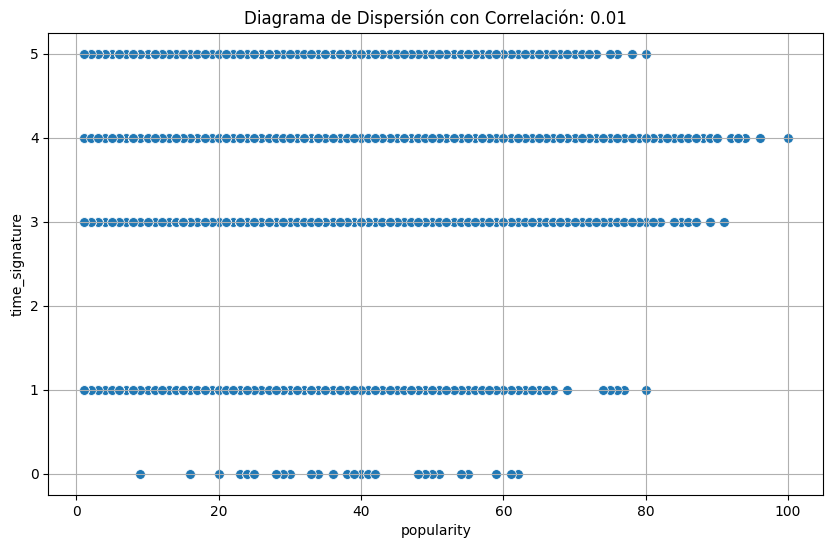

Pearson coef: 0.01379604831626382
P-value 5.07808637956426e-08


In [102]:
bt.grafico_dispersion_con_correlacion(train_set, "popularity", "time_signature", 50, mostrar_correlacion=True)
correlacion_pearson = train_set[["popularity", "time_signature"]].corr()
coef_pearson, p_valor = pearsonr(train_set["popularity"], train_set["time_signature"])
print("Pearson coef:", coef_pearson)
print("P-value", p_valor)

Other relationships to see:

In [103]:
np.abs(corr)

,popularity,year,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
popularity,1.000000,0.098867,0.127397,0.077282,0.000790,0.035239,0.021486,0.051018,0.027037,0.141190,0.081357,0.019238,0.040681,0.145454,0.013796
year,0.098867,1.000000,0.012101,0.001495,0.000341,0.019888,0.000300,0.007457,0.000440,0.028298,0.005748,0.012456,0.015713,0.073978,0.000523
danceability,0.127397,0.012101,1.000000,0.077754,0.020010,0.202764,0.069337,0.110319,0.110979,0.172795,0.125555,0.466539,0.104787,0.095147,0.166305
energy,0.077282,0.001495,0.077754,1.000000,0.035212,0.815634,0.088984,0.181960,0.773520,0.287305,0.234212,0.239599,0.254723,0.061825,0.168625
key,0.000790,0.000341,0.020010,0.035212,1.000000,0.027586,0.157281,0.020316,0.026285,0.009548,0.002004,0.026188,0.005717,0.001433,0.007531
loudness,0.035239,0.019888,0.202764,0.815634,0.027586,1.000000,0.056025,0.160971,0.661909,0.499237,0.167503,0.252961,0.214928,0.025737,0.168782
mode,0.021486,0.000300,0.069337,0.088984,0.157281,0.056025,1.000000,0.062055,0.096904,0.022801,0.017945,0.007290,0.011059,0.016057,0.028138
speechiness,0.051018,0.007457,0.110319,0.181960,0.020316,0.160971,0.062055,1.000000,0.154596,0.136041,0.090719,0.030644,0.081999,0.088737,0.064364
acousticness,0.027037,0.000440,0.110979,0.773520,0.026285,0.661909,0.096904,0.154596,1.000000,0.232137,0.130395,0.090644,0.206496,0.068908,0.155460
instrumentalness,0.141190,0.028298,0.172795,0.287305,0.009548,0.499237,0.022801,0.136041,0.232137,1.000000,0.116525,0.279661,0.054178,0.038327,0.089132


ANOVA for categorical

The extremely low p-value (0.0) indicates strong statistical evidence to reject the null hypothesis. This means that at least one of the groups in genre, genre group, and artist has significantly different popularity compared to the other groups.

In [104]:
f_val_genre, p_val_genre = stats.f_oneway(*[group['popularity'] for name, group in train_set.groupby('genre')])
print("F value Popularity (genre):", f_val_genre)
print("p value Popularity (genre):", p_val_genre)

F value Popularity (genre): 3643.1424768821707
p value Popularity (genre): 0.0


In [105]:
f_val_genre, p_val_genre = stats.f_oneway(*[group['popularity'] for name, group in train_set.groupby('artist_name')])
print("F value Popularity (artist):", f_val_genre)
print("p value Popularity (artist):", p_val_genre)

F value Popularity (artist): 14.936720445061573
p value Popularity (artist): 0.0


In [106]:
f_val_genre, p_val_genre = stats.f_oneway(*[group['popularity'] for name, group in train_set.groupby('genre_group')])
print("F value Popularity (genre_group):", f_val_genre)
print("p value Popularity (genre_group):", p_val_genre)

F value Popularity (genre_group): 1067.4491587161926
p value Popularity (genre_group): 0.0


##### Colinearity

Strong relationship between:
* energy & loudness
* energy  & acousticness
* loudness & acousticness

If we consider to drop any of these because of colinearity we will need to consider de correlation with target. Loudness seems to correlate higher with target. As acousticness has negative correlation we keep it and drop energy.

<Axes: >

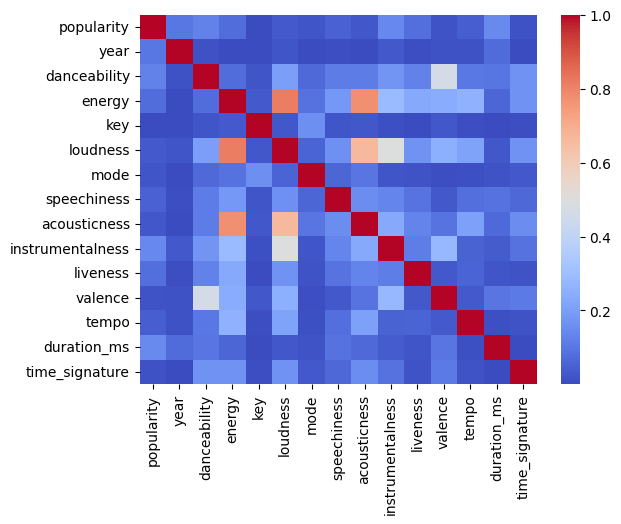

In [107]:
sns.heatmap(np.abs(corr),cmap='coolwarm')

<Axes: >

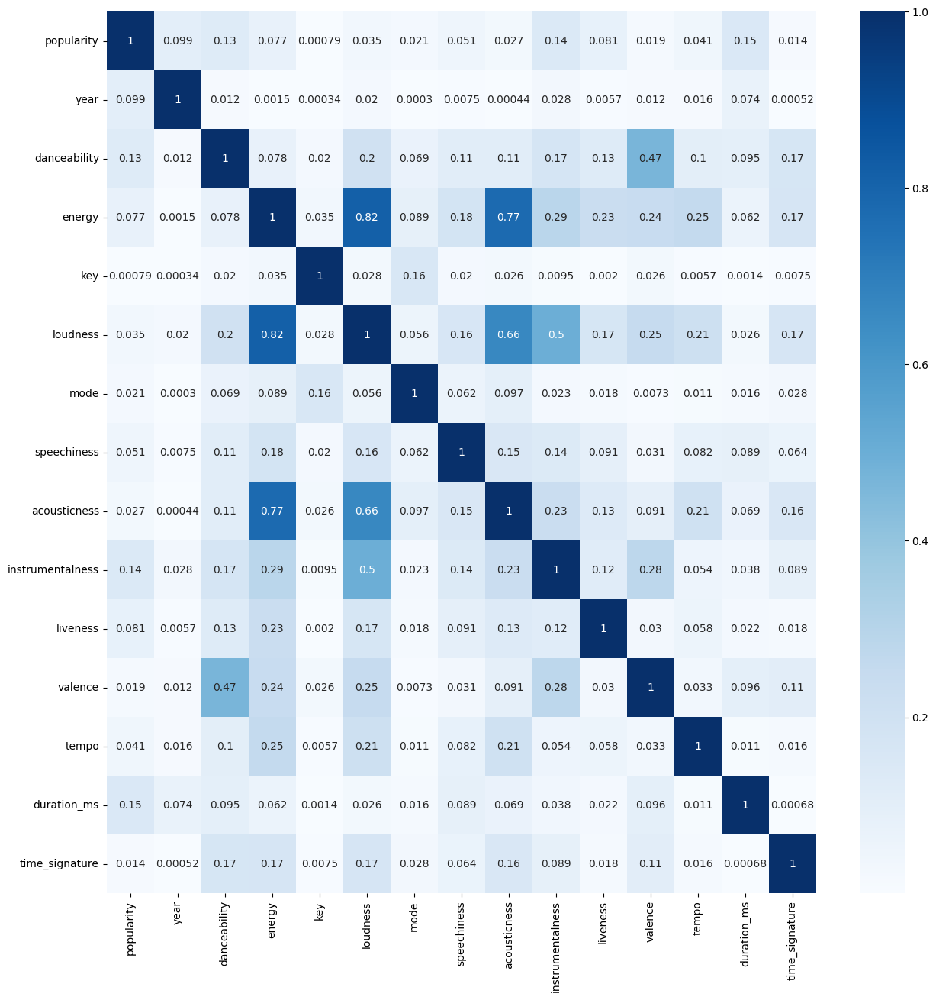

In [108]:
plt.figure(figsize= (15,15))
sns.heatmap(np.abs(corr), annot= True, cmap = "Blues")

Energy and loudness have highly colinearity to loudness 
acousticness has highly colinearity to loudness
we can drop loudness

In [109]:
features_above_threshold

duration_ms         0.145454
instrumentalness    0.141190
danceability        0.127397
year                0.098867
liveness            0.081357
energy              0.077282
speechiness         0.051018
tempo               0.040681
loudness            0.035239
Name: popularity, dtype: float64

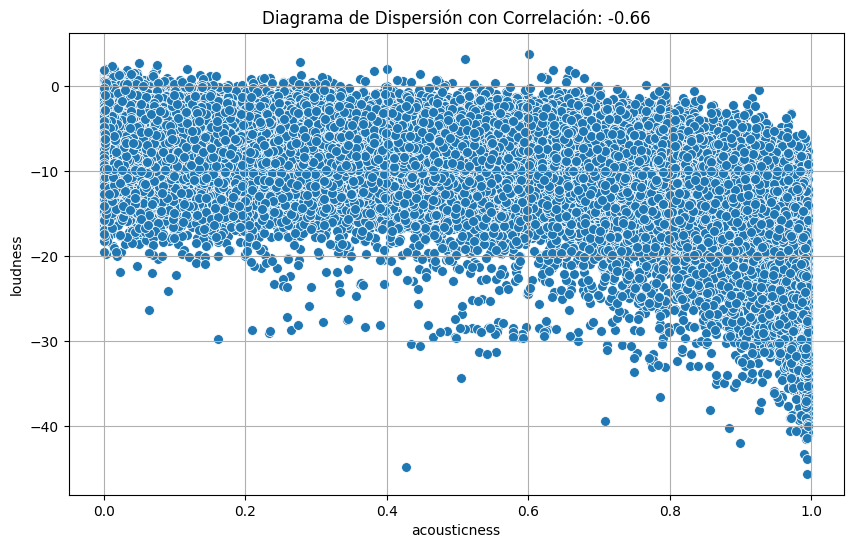

Pearson coef: -0.6619093091191185
P-value 0.0


In [110]:
bt.grafico_dispersion_con_correlacion(train_set, "acousticness", "loudness", 50, mostrar_correlacion=True)
correlacion_pearson = train_set[["acousticness", "loudness"]].corr()
coef_pearson, p_valor = pearsonr(train_set["acousticness"], train_set["loudness"])
print("Pearson coef:", coef_pearson)
print("P-value", p_valor)

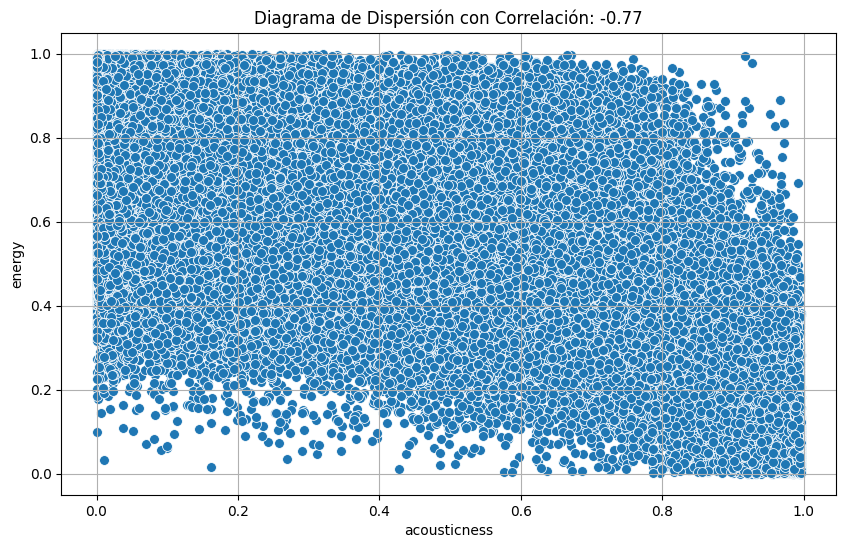

Pearson coef: -0.7735198502474647
P-value 0.0


In [111]:
bt.grafico_dispersion_con_correlacion(train_set, "acousticness", "energy", 50, mostrar_correlacion=True)
correlacion_pearson = train_set[["acousticness", "energy"]].corr()
coef_pearson, p_valor = pearsonr(train_set["acousticness"], train_set["energy"])
print("Pearson coef:", coef_pearson)
print("P-value", p_valor)

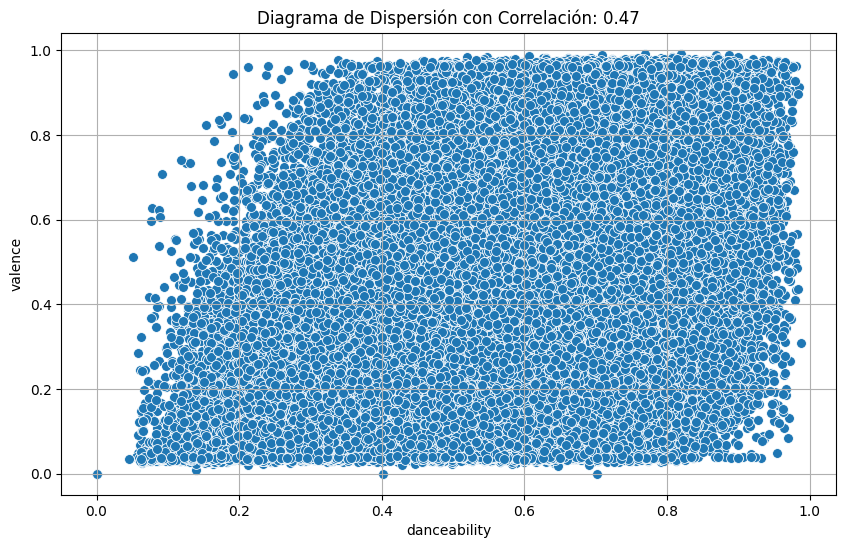

Pearson coef: 0.4665386602405027
P-value 0.0


In [112]:
bt.grafico_dispersion_con_correlacion(train_set, "danceability", "valence", 50, mostrar_correlacion=True)
correlacion_pearson = train_set[["danceability", "valence"]].corr()
coef_pearson, p_valor = pearsonr(train_set["danceability"], train_set["valence"])
print("Pearson coef:", coef_pearson)
print("P-value", p_valor)

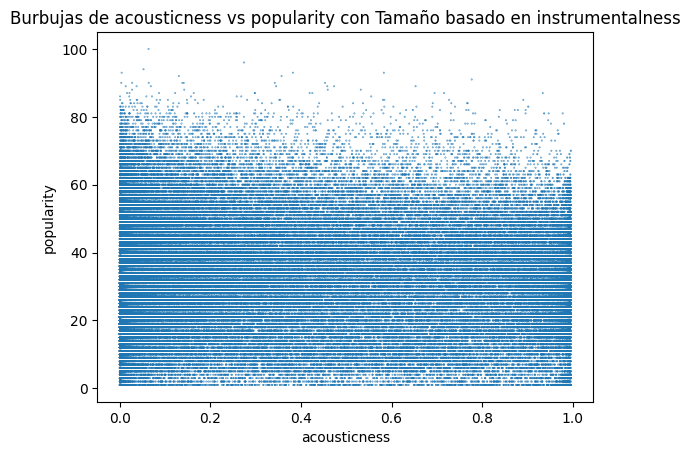

In [113]:
bt.bubble_plot(train_set, "acousticness", "popularity","instrumentalness",scale = 10)

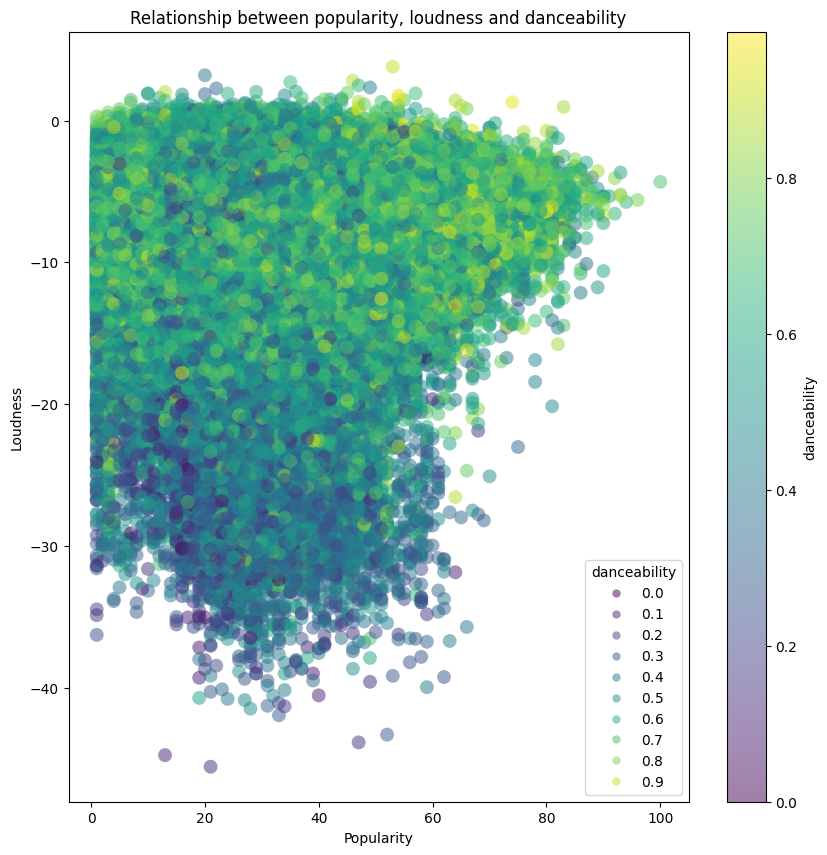

In [114]:
popularity_data = train_set["popularity"]
loudness_data = train_set["loudness"]
liveness_data = train_set["danceability"]

plt.figure(figsize=(10, 10))
scatter = plt.scatter(popularity_data, loudness_data, c=liveness_data, cmap="viridis", s=100, linewidth=0, alpha=0.5)

plt.xlabel("Popularity")
plt.ylabel("Loudness")
plt.colorbar(label="danceability")
plt.title("Relationship between popularity, loudness and danceability")
plt.legend(*scatter.legend_elements(), title="danceability")
plt.show()

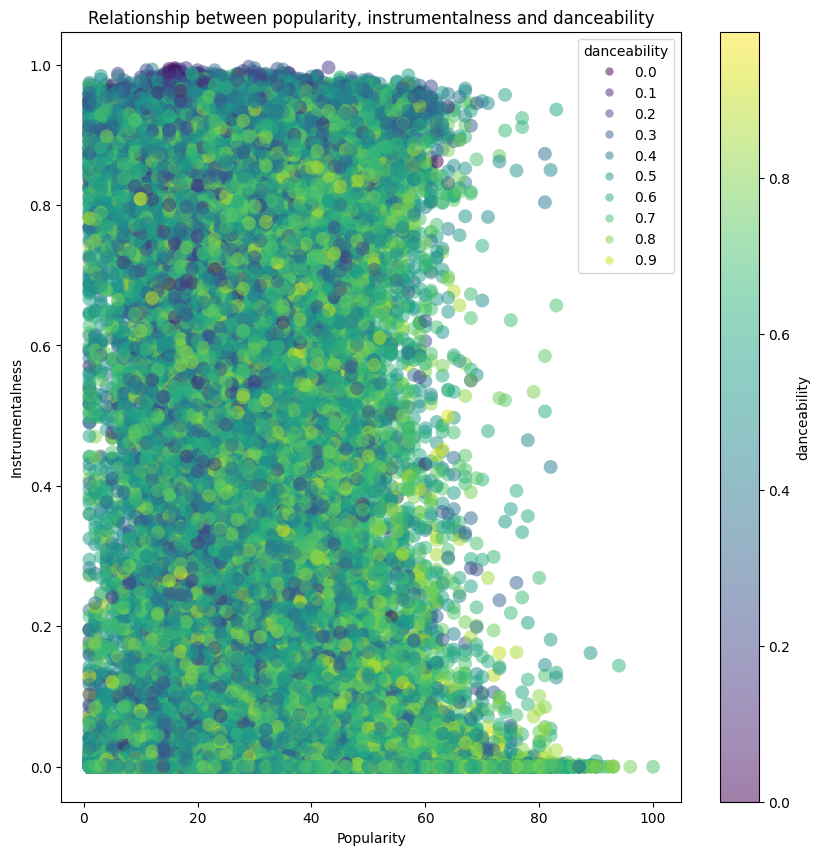

In [115]:
popularity_data = train_set["popularity"]
instrumentalness_data = train_set["instrumentalness"]
dance_data = train_set["danceability"]

plt.figure(figsize=(10, 10))
scatter = plt.scatter(popularity_data, instrumentalness_data, c=dance_data, cmap="viridis", s=100, linewidth=0, alpha=0.5)

plt.xlabel("Popularity")
plt.ylabel("Instrumentalness")
plt.colorbar(label="danceability")
plt.title("Relationship between popularity, instrumentalness and danceability")
plt.legend(*scatter.legend_elements(), title="danceability")
plt.show()

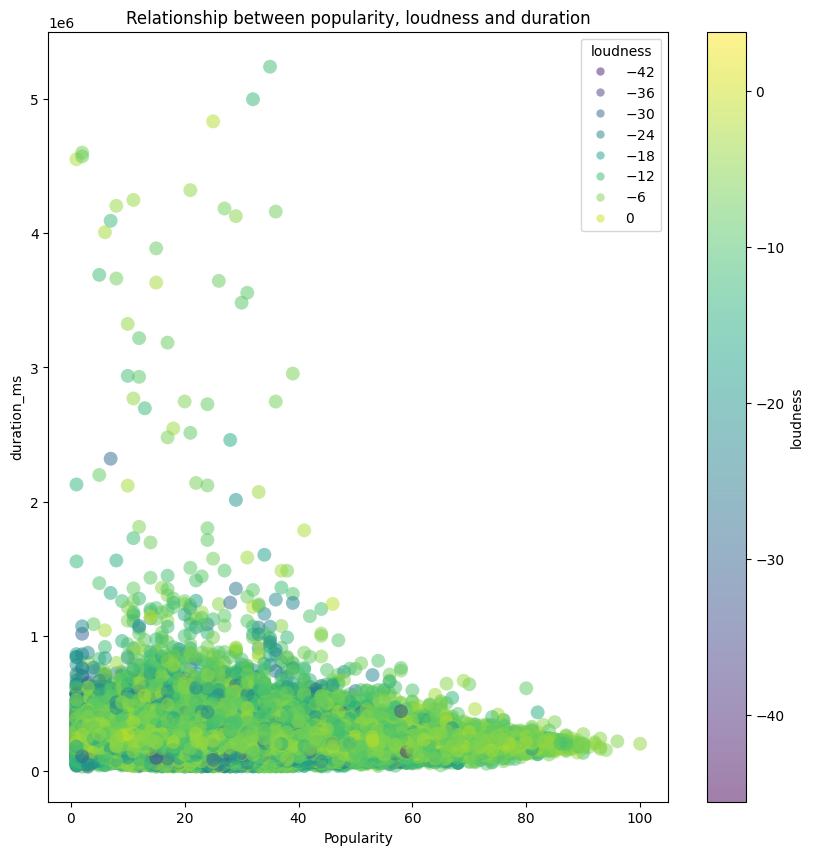

In [116]:
popularity_data = train_set["popularity"]
loudness_data = train_set["loudness"]
duration_data = train_set["duration_ms"]

plt.figure(figsize=(10, 10))
scatter = plt.scatter(popularity_data, duration_data, c=loudness_data, cmap="viridis", s=100, linewidth=0, alpha=0.5)

plt.xlabel("Popularity")
plt.ylabel("duration_ms")
plt.colorbar(label="loudness")
plt.title("Relationship between popularity, loudness and duration")
plt.legend(*scatter.legend_elements(), title="loudness")
plt.show()

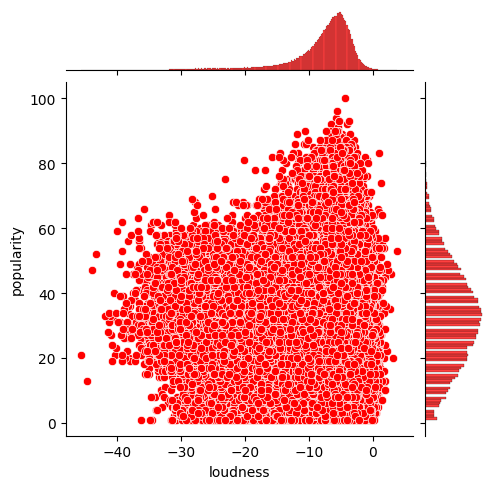

In [117]:
sns.jointplot(x=train_set["loudness"],
              y=train_set["popularity"],
              color='red',
              height=5)

## **Libraries import and notebook prep**

# **5. FEATURE SELECTION AND SPLIT TRAIN TEST**


 **5.1.   Features selection**

 **5.2.   Train test split**


# **6. FEATURES TRANSFORMATION**

* **Normalizing numerical features**

* **Features categorical: pd dummies for year**

* **Features categorical: one hot for artist**

# **7. K-MEANS**

**7.1. Elbow**

**7.2. K-Means**

# **8. MODELS**


 **8.1.   Models selected to be analysed**

 **8.2.   Linear regression**

 **8.3.   Gradient Boosting**

 **8.4.   XGBoost**


# **9 New input**


# **10 Conclusions**

Light GBM and XG Boost are the best models with a MAPE arround 0.475, genre is quite relevant as feature, as well as duration danceability or latest years
Models have already been saved, nevertheless we finish saving both again

In [ ]:
# Folder model if not existing
models_dir = 'models'
if not os.path.exists(models_dir):
    os.makedirs(models_dir)

results_file_path= os.path.join(models_dir, 'mejor_modelo_xbg_reg_short.pkl')
with open(results_file_path, 'wb') as file:
    pickle.dump(best_xgb_reg_short, file)

    print(f"Results saved to {results_file_path}")

In [ ]:
# Folder model if not existing
models_dir = 'models'
if not os.path.exists(models_dir):
    os.makedirs(models_dir)

results_file_path= os.path.join(models_dir, 'mejor_modelo_lgb_reg_short.pkl')
with open(results_file_path, 'wb') as file:
    pickle.dump(best_lgb_reg_short, file)

    print(f"Results saved to {results_file_path}")

#### **9.1. Input_test**

We provide a ***new input for predicting*** in the model, already normalized,etc

In [ ]:
reg= train_set.iloc[0]
reg

artist_name         Eddie van der Meer
popularity                           8
year                              2017
genre                           guitar
danceability                      0.49
energy                           0.304
key                                  2
loudness                         -9.61
mode                                 0
speechiness                     0.0515
acousticness                     0.836
instrumentalness                 0.912
liveness                        0.0923
valence                          0.343
tempo                          118.472
duration_ms                     139474
time_signature                       4
Name: 16883, dtype: object

In [ ]:
# Sample instance
primer_registro = train_set_encoded.iloc[0]
columnas = list(train_set_encoded.columns)

# Crear new_input como una lista de tuplas (nombre_columna, valor)
new_input = [(columna, primer_registro[columna]) for columna in columnas]
print("Nombres de las columnas y valores del primer registro:")
for nombre, valor in new_input:
    print(f"{nombre}: {valor}")


Nombres de las columnas y valores del primer registro:
artist_name: 5965
popularity: 8
genre: 21
danceability: 0.49
energy: 0.304
key: 2
loudness: 0.7284403298016733
mode: 0
speechiness: 0.0515
acousticness: 0.836
instrumentalness: 0.912
liveness: 0.0923
valence: 0.343
tempo: 0.47874244842705027
duration_ms: 11.845640652713728
time_signature: 0.8
year_2018: False
year_2019: False
year_2020: False
year_2021: False
year_2022: False
year_2023: False


In [ ]:
# Input
new_input = {
    'artist_name': 5965,
    'genre': 21,
    'danceability': 0.49,
    'energy': 0.304,
    'key': 2,
    'loudness': 0.7284403298016733,
    'mode': 0,
    'speechiness': 0.0515,
    'acousticness': 0.836,
    'instrumentalness': 0.912,
    'liveness': 0.0923,
    'valence': 0.343,
    'tempo': 0.47874244842705027,
    'duration_ms': 11.845640652713728,
    'time_signature': 0.8,
    'year_2017': 1,
    'year_2018': 0,
    'year_2019': 0,
    'year_2020': 0,
    'year_2021': 0,
    'year_2022': 0,
    'year_2023': 0
}



In [ ]:
#  input to DataFrame
new_input_df = pd.DataFrame([new_input])

### **9.2.Prediction**

#### **9.2.1. LR prediction**

In [ ]:
new_prediction_reg = linear_reg_short.predict(new_input_df[selected_features])

print("Nueva predicción:", new_prediction_reg)


Nueva predicción: [28.99177231]


In [ ]:
# Folder model if not existing
models_dir = 'preds'
if not os.path.exists(models_dir):
    os.makedirs(models_dir)

results_file_path= os.path.join(models_dir, 'pred_reg.pkl')
with open(results_file_path, 'wb') as file:
    pickle.dump(new_prediction_reg, file)

    print(f"Results saved to {results_file_path}")

Results saved to preds/pred_reg.pkl


#### **9.2.2. GB prediction**

In [ ]:
new_prediction_gb = best_gb_reg_short.predict(new_input_df[selected_features])

print("Nueva predicción:", new_prediction_gb)


Nueva predicción: [16.08135267]


In [ ]:
# Folder model if not existing
models_dir = 'preds'
if not os.path.exists(models_dir):
    os.makedirs(models_dir)

results_file_path= os.path.join(models_dir, 'pred_gb.pkl')
with open(results_file_path, 'wb') as file:
    pickle.dump(new_prediction_gb, file)

    print(f"Results saved to {results_file_path}")

Results saved to preds/pred_gb.pkl


#### **9.2.3.  XGB prediction**

In [ ]:
new_prediction_xgb = best_xgb_reg_short.predict(new_input_df[selected_features])

print("Nueva predicción:", new_prediction_xgb)

Nueva predicción: [15.956667]


In [ ]:
# Folder model if not existing
models_dir = 'preds'
if not os.path.exists(models_dir):
    os.makedirs(models_dir)

results_file_path= os.path.join(models_dir, 'pred_xbg.pkl')
with open(results_file_path, 'wb') as file:
    pickle.dump(new_prediction_xgb, file)

    print(f"Results saved to {results_file_path}")

Results saved to preds/pred_xbg.pkl


#### **9.2.4.  LGB prediction**

In [ ]:
new_prediction_lgb = best_lgb_reg_short.predict(new_input_df[selected_features])

print("Nueva predicción:", new_prediction_lgb)

Nueva predicción: [15.27421991]


In [ ]:
# Folder model if not existing
models_dir = 'preds'
if not os.path.exists(models_dir):
    os.makedirs(models_dir)

results_file_path= os.path.join(models_dir, 'pred_lgb.pkl')
with open(results_file_path, 'wb') as file:
    pickle.dump(new_prediction_lgb, file)

    print(f"Results saved to {results_file_path}")

Results saved to preds/pred_lgb.pkl


### **8.1.   Models selected to be analysed**

   8.1.1 X train/test train CV different features lists'
   
   8.1.2. Fitting preparation


#### **8.1.1.   X train/test train CV different features lists'**


Cross validation for different features lists

In [ ]:
# x y train/test
X_train = train_set_encoded.drop(columns=['popularity'])
y_train = train_set_encoded['popularity']
X_test = test_set_encoded.drop(columns=['popularity'])
y_test = test_set_encoded['popularity']

In [ ]:
xgb_reg = XGBRegressor(max_depth=10, random_state=42)
lgb_reg = LGBMRegressor(max_depth=10, random_state=42, verbose=0)
gbr_reg = GradientBoostingRegressor(max_depth=10, random_state=42)
linear_reg = LinearRegression()

# Models dic
modelos = {
    "Lightgbm": lgb_reg,
    "XGBoost": xgb_reg,
    "Gradient Boosting": gbr_reg,
    "Linear Regression": linear_reg
}

In [ ]:
# Features list
features_set = ['minimum', 'minimum_with_artist', 'minimum_with_genre']

# Dic
X_train_dict = {}
X_test_dict = {}

# Features for dic
features_corr = [
    'duration_ms',
    'instrumentalness',
    'danceability',
    'liveness',
    'energy',
    'speechiness',
    'tempo',
    'year_2018', 'year_2019', 'year_2020', 'year_2021', 'year_2022', 'year_2023'
]

features_corr_artist = [
    'duration_ms',
    'instrumentalness',
    'danceability',
    'liveness',
    'energy',
    'speechiness',
    'tempo',
    'year_2018', 'year_2019', 'year_2020', 'year_2021', 'year_2022', 'year_2023',
    'artist_name'
]

features_corr_genre = [
    'duration_ms',
    'instrumentalness',
    'danceability',
    'liveness',
    'energy',
    'speechiness',
    'tempo',
    'year_2018', 'year_2019', 'year_2020', 'year_2021', 'year_2022', 'year_2023',
    'genre'
]

# Filter existing columns
def filter_existing_columns(df, columns):
    filtered_columns = [col for col in columns if col in df.columns]
    missing_columns = set(columns) - set(filtered_columns)
    if missing_columns:
        print(f"Columnas faltantes en el dataframe: {missing_columns}")
    return filtered_columns

# Filter features
features_corr_filtered = filter_existing_columns(train_set_encoded, features_corr)
features_corr_artist_filtered = filter_existing_columns(train_set_encoded, features_corr_artist)
features_corr_genre_filtered = filter_existing_columns(train_set_encoded, features_corr_genre)

# Divide data
for nombre, feature_list in zip(features_set, [features_corr_filtered, features_corr_artist_filtered, features_corr_genre_filtered]):
    X_train_dict[nombre] = train_set_encoded[feature_list]
    X_test_dict[nombre] = test_set_encoded[feature_list]

# check
print("Conjuntos de características de entrenamiento:")
for nombre, data in X_train_dict.items():
    print(f"{nombre}: {data.shape}")

print("\nConjuntos de características de prueba:")
for nombre, data in X_test_dict.items():
    print(f"{nombre}: {data.shape}")


Conjuntos de características de entrenamiento:
minimum: (155962, 13)
minimum_with_artist: (155962, 14)
minimum_with_genre: (155962, 14)

Conjuntos de características de prueba:
minimum: (38991, 13)
minimum_with_artist: (38991, 14)
minimum_with_genre: (38991, 14)


In [ ]:
# CV
def evaluate_models():
    results = {}
    for features_set, X_train in X_train_dict.items():
        results[features_set] = {}
        print(f"For SET {features_set}:")
        for tipo, modelo in modelos.items():
            print(f"{tipo}: ", end=" ")
            scores = cross_val_score(modelo, X_train, y_train, cv=5, scoring="neg_mean_absolute_error", n_jobs=-1)
            mean_score = np.mean(scores)
            print(f"Mean MAE: {mean_score:.4f}")
            results[features_set][tipo] = mean_score
        print("******")
    return results

results = evaluate_models()

For SET minimum:
Lightgbm:  Mean MAE: -10.9491
XGBoost:  Mean MAE: -11.2472
Gradient Boosting:  Mean MAE: -10.9033
Linear Regression:  Mean MAE: -11.4980
******
For SET minimum_with_artist:
Lightgbm:  Mean MAE: -10.7723
XGBoost:  Mean MAE: -10.6038
Gradient Boosting:  Mean MAE: -10.1149
Linear Regression:  Mean MAE: -11.4949
******
For SET minimum_with_genre:
Lightgbm:  Mean MAE: -7.7261
XGBoost:  Mean MAE: -7.7868
Gradient Boosting:  Mean MAE: -7.5338
Linear Regression:  Mean MAE: -11.4904
******


In [ ]:
# Folder model if not existing
models_dir = 'models'
if not os.path.exists(models_dir):
    os.makedirs(models_dir)

results_file_path= os.path.join(models_dir, 'results_evaluate_model_0pop.pkl')
with open(results_file_path, 'wb') as file:
    pickle.dump(results, file)

    print(f"Results saved to {results_file_path}")

Results saved to models/results_evaluate_model_0pop.pkl


#### **8.1.2.   Fitting preparation**


In [ ]:
selected_features = features_corr_genre

In [ ]:
#  X_train  X_test for features selected
X_train_selected = X_train[selected_features]
X_test_selected = X_test[selected_features]

### **8.2.  Linear regression**


In [ ]:
linear_reg_short = LinearRegression()
linear_reg_short.fit(X_train_selected, y_train)
y_pred = linear_reg_short.predict(X_test_selected)

# MAPE
mape_adjusted = mean_absolute_percentage_error(y_test, y_pred)
print("MAPE ajustado:", mape_adjusted.round(4))

MAPE ajustado: 0.7926


In [ ]:
# Folder model if not existing
models_dir = 'models'
if not os.path.exists(models_dir):
    os.makedirs(models_dir)

results_file_path= os.path.join(models_dir, 'modelo_linear_reg_min_year.pkl')
with open(results_file_path, 'wb') as file:
    pickle.dump(linear_reg, file)

    print(f"Results saved to {results_file_path}")

'''
## Cargar el modelo desde el archivo
with open('modelo_linear_reg.pkl', 'rb') as file:
    loaded_model = pickle.load(file)

# Hacer predicciones con el modelo cargado
y_pred_loaded = loaded_model.predict(X_test_selected)

# Calcular y mostrar el MAPE ajustado
mape_adjusted_loaded = mean_absolute_percentage_error(y_test, y_pred_loaded)
print("MAPE ajustado del modelo cargado:", mape_adjusted_loaded.round(4))
'''

Results saved to models/modelo_linear_reg_min_year.pkl


'\n## Cargar el modelo desde el archivo\nwith open(\'modelo_linear_reg.pkl\', \'rb\') as file:\n    loaded_model = pickle.load(file)\n\n# Hacer predicciones con el modelo cargado\ny_pred_loaded = loaded_model.predict(X_test_selected)\n\n# Calcular y mostrar el MAPE ajustado\nmape_adjusted_loaded = mean_absolute_percentage_error(y_test, y_pred_loaded)\nprint("MAPE ajustado del modelo cargado:", mape_adjusted_loaded.round(4))\n'

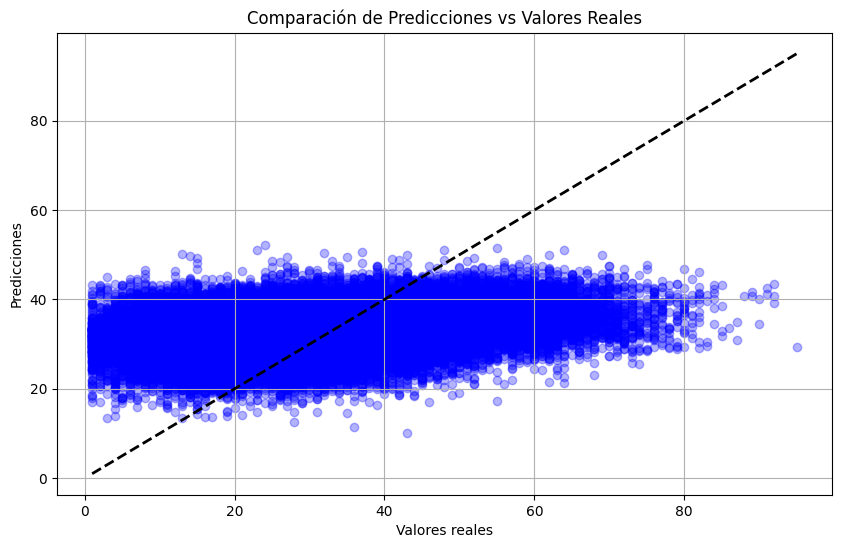

In [ ]:
# Plot pred vs real
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, color='blue', alpha=0.3)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Valores reales')
plt.ylabel('Predicciones')
plt.title('Comparación de Predicciones vs Valores Reales')
plt.grid(True)
plt.show()

### **8.3. Gradient Boosting**

In [ ]:
param_grid = {
    'n_estimators': [150,200],
    'learning_rate': [0.05, 0.1, 0.15],
    'max_depth': [3, 5]
}

gb_reg_short = GradientBoostingRegressor(random_state=42)

grid_search = GridSearchCV(estimator=gb_reg_short, param_grid=param_grid,
                           scoring='neg_mean_absolute_percentage_error',
                           cv=3, verbose=1, n_jobs=-1)

grid_search.fit(X_train_selected, y_train)

# Best hyperparameters
print("Mejores hiperparámetros encontrados:")
print(grid_search.best_params_)

# Best model
best_gb_reg_short = grid_search.best_estimator_

# Test pred
y_pred = best_gb_reg_short.predict(X_test_selected)

# MAPE
mape_adjusted = mean_absolute_percentage_error(y_test, y_pred)
print("MAPE ajustado:", mape_adjusted.round(4))

Fitting 3 folds for each of 12 candidates, totalling 36 fits
Mejores hiperparámetros encontrados:
{'learning_rate': 0.15, 'max_depth': 5, 'n_estimators': 200}
MAPE ajustado: 0.477


In [ ]:
# Folder model if not existing
models_dir = 'models'
if not os.path.exists(models_dir):
    os.makedirs(models_dir)

results_file_path= os.path.join(models_dir, 'mejor_modelo_gb_reg_short.pkl')
with open(results_file_path, 'wb') as file:
    pickle.dump(best_gb_reg_short, file)

    print(f"Results saved to {results_file_path}")

Results saved to models/mejor_modelo_gb_reg_short.pkl


'\n## Cargar el modelo desde el archivo\nwith open(\'modelo_linear_reg.pkl\', \'rb\') as file:\n    loaded_model = pickle.load(file)\n\n# Hacer predicciones con el modelo cargado\ny_pred_loaded = loaded_model.predict(X_test_selected)\n\n# Calcular y mostrar el MAPE ajustado\nmape_adjusted_loaded = mean_absolute_percentage_error(y_test, y_pred_loaded)\nprint("MAPE ajustado del modelo cargado:", mape_adjusted_loaded.round(4))\n'

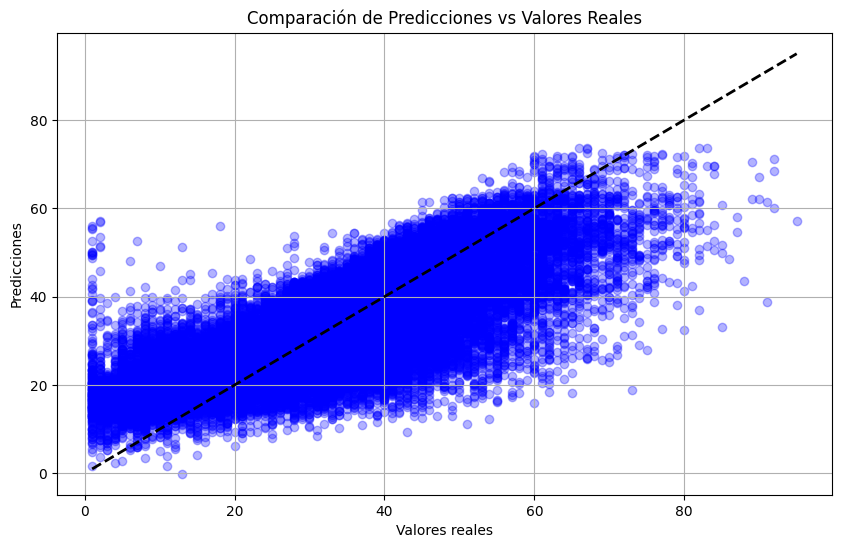

In [ ]:
# PLot pred vs real
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, color='blue', alpha=0.3)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Valores reales')
plt.ylabel('Predicciones')
plt.title('Comparación de Predicciones vs Valores Reales')
plt.grid(True)
plt.show()

             Feature  Importance
13             genre    0.756747
0        duration_ms    0.060659
11         year_2022    0.045960
1   instrumentalness    0.033138
4             energy    0.025215
2       danceability    0.013997
12         year_2023    0.013340
10         year_2021    0.012548
6              tempo    0.010576
3           liveness    0.009414
5        speechiness    0.008149
9          year_2020    0.006451
8          year_2019    0.002702
7          year_2018    0.001105


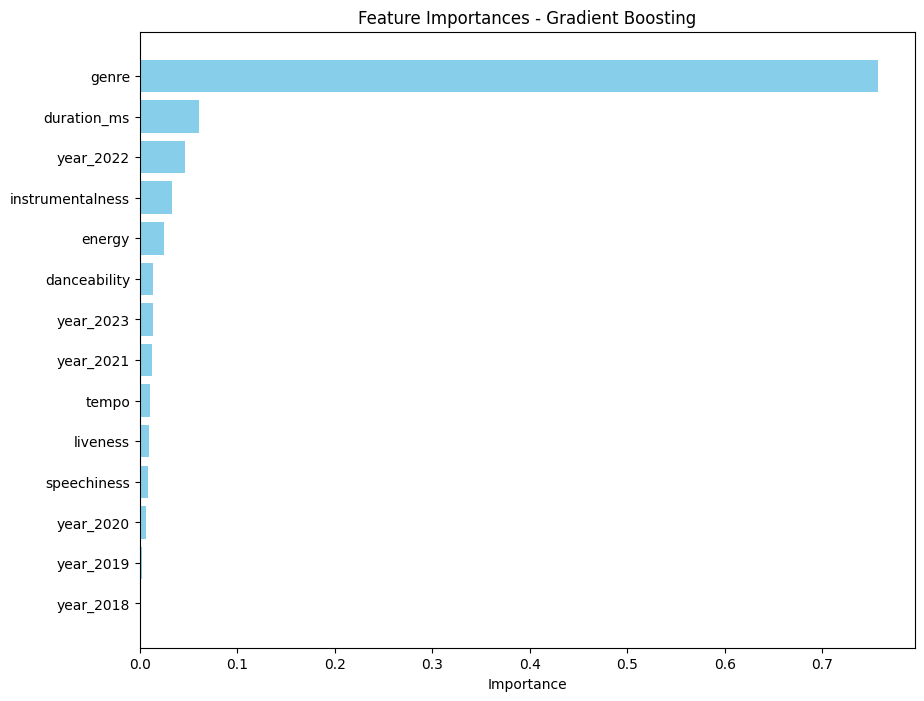

In [ ]:
# Feature importance
importances_gb = best_gb_reg_short.feature_importances_

feature_names = X_train_selected.columns
feature_importance_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': importances_gb
})

feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)
print(feature_importance_df)

# Plot feature importance
plt.figure(figsize=(10, 8))
plt.barh(feature_importance_df['Feature'], feature_importance_df['Importance'], color='skyblue')
plt.xlabel('Importance')
plt.title('Feature Importances - Gradient Boosting')
plt.gca().invert_yaxis()
plt.show()

### BEST MODELS 😀: similar results on light gbm and xgboost

---



### **8.4. XGBoost  - BEST MODEL**

In [ ]:
param_grid = {
    'n_estimators': [150,200],
    'learning_rate': [0.05, 0.1, 0.15],
    'max_depth': [3, 5]
}

xgb_reg_short = XGBRegressor(random_state=42)

grid_search = GridSearchCV(estimator=xgb_reg_short, param_grid=param_grid,
                           scoring='neg_mean_absolute_percentage_error',
                           cv=3, verbose=1, n_jobs=-1)

grid_search.fit(X_train_selected, y_train)

print("Mejores hiperparámetros encontrados:")
print(grid_search.best_params_)

best_xgb_reg_short = grid_search.best_estimator_

# Test pred
y_pred = best_xgb_reg_short.predict(X_test_selected)

# MAPE
mape_adjusted = mean_absolute_percentage_error(y_test, y_pred)
print("MAPE ajustado:", mape_adjusted.round(4))

Fitting 3 folds for each of 12 candidates, totalling 36 fits
Mejores hiperparámetros encontrados:
{'learning_rate': 0.15, 'max_depth': 5, 'n_estimators': 200}
MAPE ajustado: 0.475


In [ ]:
# Folder model if not existing
models_dir = 'models'
if not os.path.exists(models_dir):
    os.makedirs(models_dir)

results_file_path= os.path.join(models_dir, 'mejor_modelo_xbg_reg_short.pkl')
with open(results_file_path, 'wb') as file:
    pickle.dump(best_xgb_reg_short, file)

    print(f"Results saved to {results_file_path}")

Results saved to models/mejor_modelo_xbg_reg_short.pkl


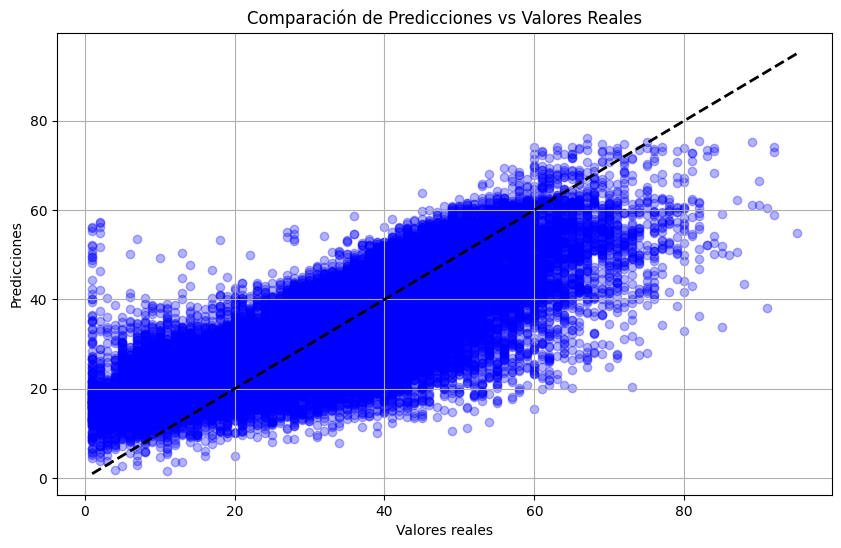

In [ ]:
# Plot pred vs real
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, color='blue', alpha=0.3)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Valores reales')
plt.ylabel('Predicciones')
plt.title('Comparación de Predicciones vs Valores Reales')
plt.grid(True)
plt.show()

             Feature  Importance
13             genre    0.282681
11         year_2022    0.251802
10         year_2021    0.110410
9          year_2020    0.067822
0        duration_ms    0.062504
8          year_2019    0.046949
1   instrumentalness    0.044998
12         year_2023    0.037936
4             energy    0.026227
2       danceability    0.018047
6              tempo    0.014313
7          year_2018    0.012842
5        speechiness    0.011898
3           liveness    0.011572


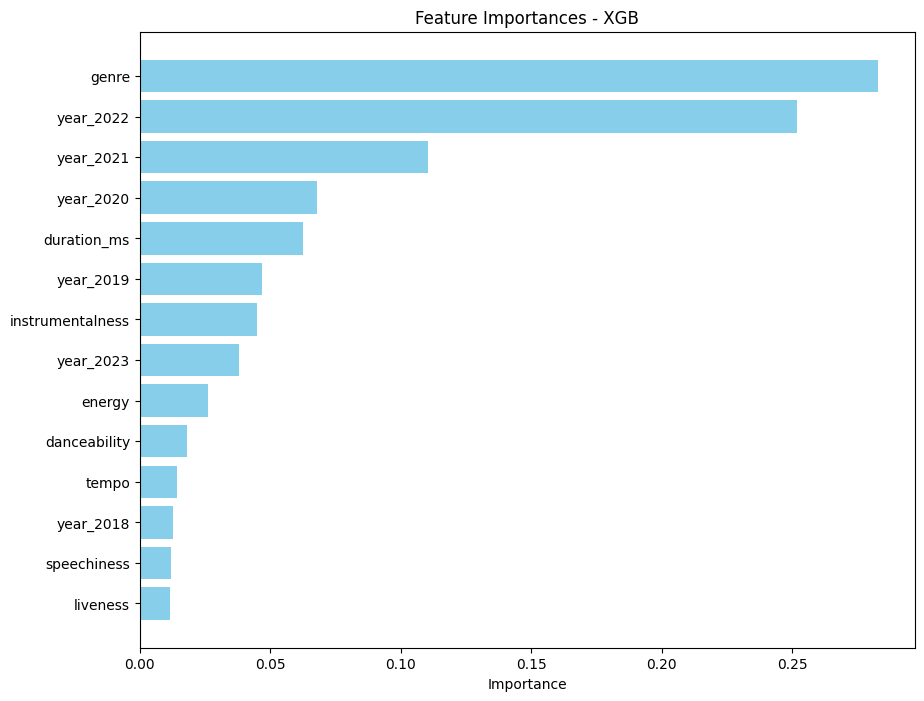

In [ ]:
# Feature importance
importances_xgb = best_xgb_reg_short.feature_importances_

feature_names = X_train_selected.columns
feature_importance_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': importances_xgb
})

feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

print(feature_importance_df)

# Plot features importance
plt.figure(figsize=(10, 8))
plt.barh(feature_importance_df['Feature'], feature_importance_df['Importance'], color='skyblue')
plt.xlabel('Importance')
plt.title('Feature Importances - XGB')
plt.gca().invert_yaxis()
plt.show()

### **8.5. LightGBM - BEST MODEL**

In [ ]:
param_grid = {
    'n_estimators': [150, 200],
    'learning_rate': [0.05, 0.1, 0.15],
    'max_depth': [3, 5],
    'num_leaves': [16, 32]
}

lgb_reg_short = LGBMRegressor(random_state=42)

grid_search = GridSearchCV(estimator=lgb_reg_short, param_grid=param_grid,
                           scoring='neg_mean_absolute_percentage_error',
                           cv=3, verbose=1, n_jobs=-1)

grid_search.fit(X_train_selected, y_train)

print("Mejores hiperparámetros encontrados:")
print(grid_search.best_params_)

best_lgb_reg_short = grid_search.best_estimator_

y_pred = best_lgb_reg_short.predict(X_test_selected)

mape_adjusted = mean_absolute_percentage_error(y_test, y_pred)
print("MAPE ajustado:", mape_adjusted.round(4))


Fitting 3 folds for each of 24 candidates, totalling 72 fits


/usr/local/lib/python3.10/dist-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000943 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1840
[LightGBM] [Info] Number of data points in the train set: 155962, number of used features: 14
[LightGBM] [Info] Start training from score 32.883407
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gai

In [ ]:
# Folder model if not existing
models_dir = 'models'
if not os.path.exists(models_dir):
    os.makedirs(models_dir)

results_file_path= os.path.join(models_dir, 'mejor_modelo_lgb_reg_short.pkl')
with open(results_file_path, 'wb') as file:
    pickle.dump(best_lgb_reg_short, file)

    print(f"Results saved to {results_file_path}")

Results saved to models/mejor_modelo_lgb_reg_short.pkl


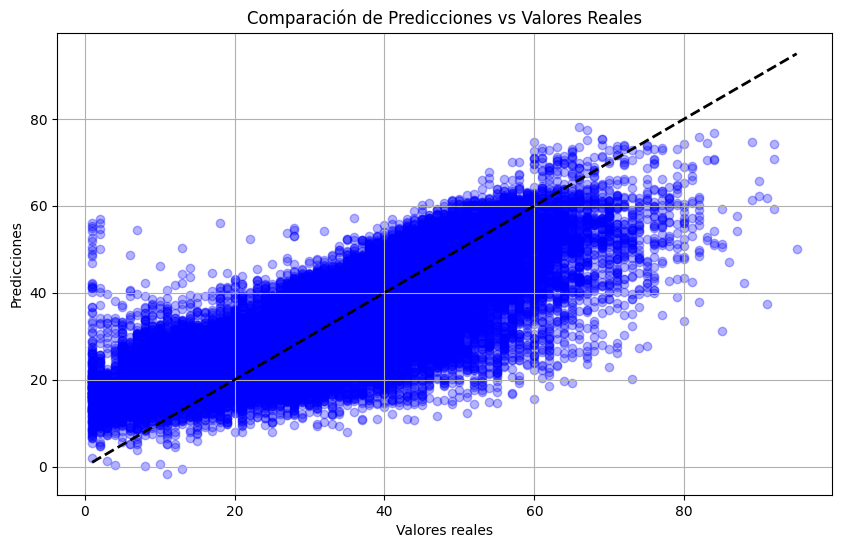

In [ ]:
# Pred vs real
plt.figure(figsize=(10, 6))
plt.scatter(y_test, y_pred, color='blue', alpha=0.3)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Valores reales')
plt.ylabel('Predicciones')
plt.title('Comparación de Predicciones vs Valores Reales')
plt.grid(True)
plt.show()

             Feature  Importance
13             genre        1738
0        duration_ms         633
4             energy         570
2       danceability         524
1   instrumentalness         464
6              tempo         454
3           liveness         420
5        speechiness         407
12         year_2023         237
11         year_2022         108
10         year_2021          75
7          year_2018          63
9          year_2020          59
8          year_2019          43


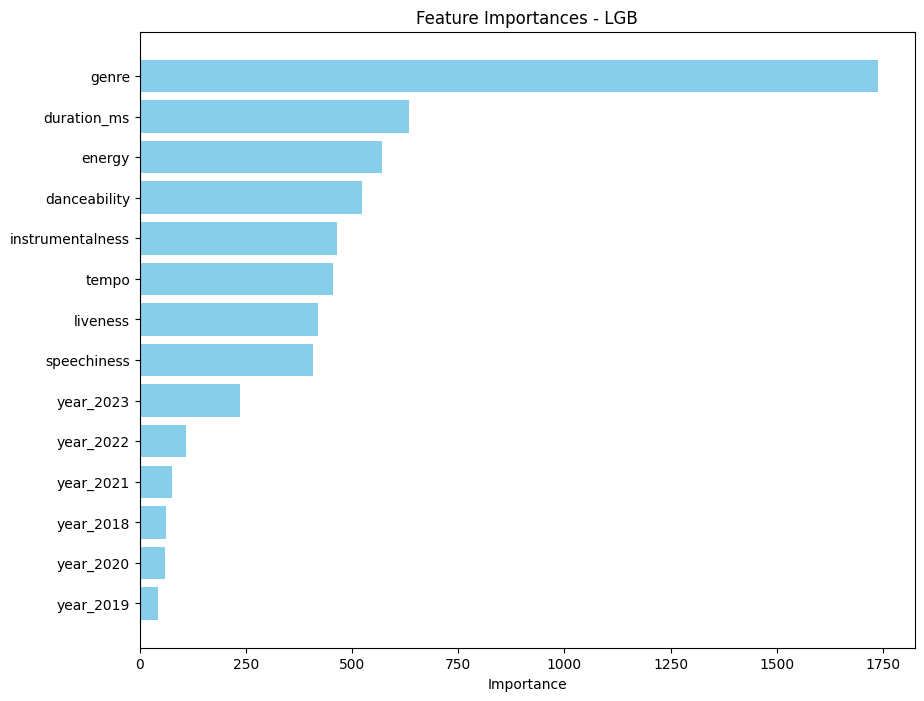

In [ ]:
# Feature importance
importances_lgb = best_lgb_reg_short.feature_importances_

feature_names = X_train_selected.columns
feature_importance_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': importances_lgb
})

feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

print(feature_importance_df)

# Plot
plt.figure(figsize=(10, 8))
plt.barh(feature_importance_df['Feature'], feature_importance_df['Importance'], color='skyblue')
plt.xlabel('Importance')
plt.title('Feature Importances - LGB')
plt.gca().invert_yaxis()
plt.show()

## **7.1. Elbow**

In [ ]:
ks = []
inertias = []

for k in range(1, 10):
    clustering = KMeans(n_clusters = k)
    clustering.fit(train_set_encoded)
    inertias.append(clustering.inertia_)
    ks.append(k)

In [ ]:
df_inertias = pd.DataFrame({'k': ks, 'inertia': inertias})
df_inertias['diff'] = df_inertias['inertia'] - df_inertias['inertia'].shift(1)
df_inertias

,k,inertia,diff
0,1,6.867902e+12,NaN
1,2,1.709023e+12,-5.158879e+12
2,3,7.580468e+11,-9.509761e+11
3,4,4.224340e+11,-3.356127e+11
4,5,2.680004e+11,-1.544336e+11
5,6,1.874779e+11,-8.052254e+10
6,7,1.348541e+11,-5.262373e+10
7,8,1.053342e+11,-2.951996e+10
8,9,8.226713e+10,-2.306706e+10


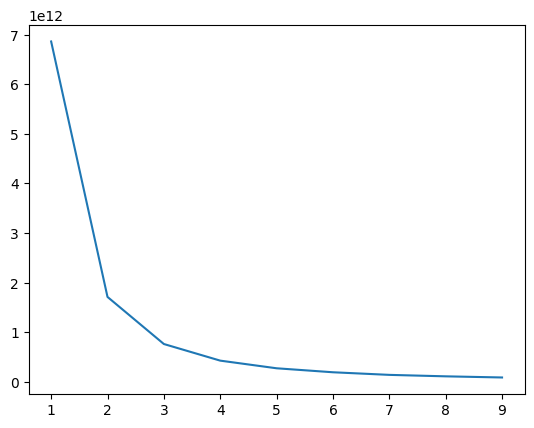

In [ ]:
plt.plot(ks, inertias);


## **7.2.  Kmeans**

In [ ]:
clustering_k3=  KMeans(n_clusters=3)
train_set_encoded_kmeans = train_set_encoded.copy()
clustering_k3.fit(train_set_encoded_kmeans[features_num])

KMeans(n_clusters=3)

In [ ]:
train_set_encoded_kmeans['cluster'] = clustering_k3.predict(train_set_encoded_kmeans[features_num])
train_set_encoded_kmeans.head(2)

,artist_name,popularity,genre,danceability,energy,key,loudness,mode,speechiness,acousticness,...,duration_ms,time_signature,year_2017,year_2018,year_2019,year_2020,year_2021,year_2022,year_2023,cluster
16883,5965,8,21,0.490,0.304,2,0.728440,0,0.0515,0.83600,...,11.845641,0.8,True,False,False,False,False,False,False,1
130122,2541,39,15,0.682,0.799,11,0.758443,0,0.0398,0.00901,...,12.910165,0.8,False,False,False,False,True,False,False,0


In [ ]:
train_set_encoded_kmeans['cluster'].value_counts(normalize=True)

cluster
1    0.346469
2    0.340435
0    0.313095
Name: proportion, dtype: float64

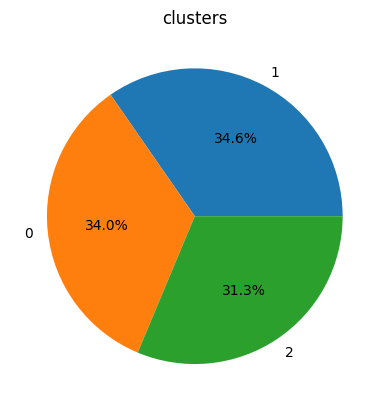

In [ ]:
plt.pie(train_set_encoded_kmeans['cluster'].value_counts(normalize=True), autopct= '%1.1f%%', labels=train_set_encoded_kmeans['cluster'].unique())
plt.title('clusters');


In [ ]:
train_set_encoded_kmeans.groupby('cluster').describe()

artist_name                                                            \
              count          mean          std  min     25%      50%      75%   
cluster                                                                         
0           48831.0  11424.292642  6641.974677  1.0  5654.0  11458.0  17168.0   
1           54036.0  11459.052298  6661.691045  0.0  5661.0  11508.0  17214.0   
2           53095.0  11450.268010  6604.111745  1.0  5702.0  11529.0  17124.0   

                 popularity             ... duration_ms             \
             max      count       mean  ...         75%        max   
cluster                                 ...                          
0        22864.0    48831.0  33.046139  ...   12.424256  15.203301   
1        22864.0    54036.0  32.891350  ...   12.419841  15.424011   
2        22866.0    53095.0  32.725662  ...   12.428033  15.471316   

        time_signature                                               
                 count      mean       std  min  25%  50%  75%  max  
cluster                                                              
0              48831.0  0.786099  0.075029  0.0  0.8  0.8  0.8  1.0  
1              54036.0  0.784351  0.077660  0.0  0.8  0.8  0.8  1.0  
2              53095.0  0.784021  0.077172  0.0  0.8  0.8  0.8  1.0  

[3 rows x 128 columns]

In [ ]:
features_categorical = ['artist_name', 'genre' , 'year']
features_binary = ['mode']
features_numeric_discrete = ['popularity', 'danceability', 'energy', 'key', 'loudness',
                         'speechiness', 'acousticness', 'instrumentalness', 'liveness',
                         'valence', 'tempo','time_signature']
features_numeric_continuous = ['duration_ms']
features_categorical_analyse_without_artist = ['genre', 'year']
features_categorical_analyse_dummies = ['year']

columns = features_categorical + features_binary + features_numeric_discrete +features_numeric_continuous
numerical_columns =  features_binary + features_numeric_discrete +features_numeric_continuous
features_num = pd.Index(numerical_columns)
features_num= features_num.drop('popularity')
features_num = features_num.tolist()


In [ ]:
def preprocess_data(train_set, test_set):
    train_set_scaled = train_set.copy()
    test_set_scaled = test_set.copy()

    # Features num to scale
    features_to_scale = ['loudness', 'tempo', 'time_signature']
    scaler = MinMaxScaler()
    train_set_scaled[features_to_scale] = scaler.fit_transform(train_set_scaled[features_to_scale])
    test_set_scaled[features_to_scale] = scaler.transform(test_set_scaled[features_to_scale])

    # Log to 'duration_ms'
    train_set_scaled['duration_ms'] = np.log1p(train_set_scaled['duration_ms'])
    test_set_scaled['duration_ms'] = np.log1p(test_set_scaled['duration_ms'])

    # Encode categorical features with one-hot encoding, 'year'
    train_set_encoded = pd.get_dummies(train_set_scaled, columns=['year'], drop_first=True)
    test_set_encoded = pd.get_dummies(test_set_scaled, columns=['year'], drop_first=True)

    # Encode artist name using LabelEncoder
    all_artists = pd.concat([train_set['artist_name'], test_set['artist_name']], axis=0).unique()
    label_encoder_artist = LabelEncoder()
    label_encoder_artist.fit(all_artists)
    train_set_encoded['artist_name'] = label_encoder_artist.transform(train_set['artist_name'])
    test_set_encoded['artist_name'] = label_encoder_artist.transform(test_set['artist_name'])

    # Encode year using LabelEncoder
    all_years = pd.concat([train_set['genre'], test_set['genre']], axis=0).unique()
    label_encoder_year = LabelEncoder()
    label_encoder_year.fit(all_years)
    train_set_encoded['genre'] = label_encoder_year.transform(train_set['genre'])
    test_set_encoded['genre'] = label_encoder_year.transform(test_set['genre'])

    # Align datasets to ensure the same columns in both
    train_set_encoded, test_set_encoded = train_set_encoded.align(test_set_encoded, join='left', axis=1, fill_value=0)

    return train_set_encoded, test_set_encoded

In [ ]:
# Execute the function with the example DataFrames
train_set_encoded, test_set_encoded = preprocess_data(train_set, test_set)

# Display the resulting DataFrames
train_set_encoded.head(3)

,artist_name,popularity,genre,danceability,energy,key,loudness,mode,speechiness,acousticness,...,valence,tempo,duration_ms,time_signature,year_2018,year_2019,year_2020,year_2021,year_2022,year_2023
16883,5965,8,21,0.490,0.304,2,0.728440,0,0.0515,0.83600,...,0.343,0.478742,11.845641,0.8,False,False,False,False,False,False
130122,2541,39,15,0.682,0.799,11,0.758443,0,0.0398,0.00901,...,0.626,0.501073,12.910165,0.8,False,False,False,True,False,False
89054,10577,30,42,0.657,0.671,9,0.744161,1,0.3040,0.40300,...,0.287,0.376372,12.844906,0.8,False,True,False,False,False,False


In [ ]:
train_set.describe()

,popularity,year,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
count,155962.000000,155962.000000,155962.000000,155962.000000,155962.000000,155962.000000,155962.000000,155962.000000,155962.000000,155962.000000,155962.000000,155962.000000,155962.000000,1.559620e+05,155962.000000
mean,32.883407,2019.811178,0.579604,0.650797,5.301695,-7.954737,0.615951,0.087795,0.303838,0.202555,0.206296,0.455726,123.247133,2.195869e+05,3.923930
std,15.198929,1.924229,0.164767,0.259490,3.577915,5.273807,0.486371,0.089158,0.334691,0.341242,0.178202,0.251882,29.910960,9.775300e+04,0.383416
min,1.000000,2017.000000,0.000000,0.000020,0.000000,-45.568000,0.000000,0.000000,0.000000,0.000000,0.009950,0.000000,0.000000,2.946700e+04,0.000000
25%,22.000000,2018.000000,0.469000,0.487000,2.000000,-9.348000,0.000000,0.037700,0.012800,0.000000,0.098800,0.245000,99.985000,1.734248e+05,4.000000
50%,32.000000,2020.000000,0.590000,0.706000,5.000000,-6.565000,1.000000,0.052000,0.150000,0.000256,0.128000,0.434000,123.007000,2.070270e+05,4.000000
75%,43.000000,2021.000000,0.703000,0.866000,8.000000,-4.728000,1.000000,0.094200,0.561000,0.281000,0.267000,0.654000,143.002750,2.485798e+05,4.000000
max,100.000000,2023.000000,0.988000,1.000000,11.000000,3.795000,1.000000,0.958000,0.996000,0.997000,1.000000,0.992000,247.465000,5.237296e+06,5.000000


In [ ]:
train_set_encoded.describe()

,artist_name,popularity,genre,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
count,155962.000000,155962.000000,155962.000000,155962.000000,155962.000000,155962.000000,155962.000000,155962.000000,155962.000000,155962.000000,155962.000000,155962.000000,155962.000000,155962.000000,155962.000000,155962.000000
mean,11445.178723,32.883407,19.521813,0.579604,0.650797,5.301695,0.761973,0.615951,0.087795,0.303838,0.202555,0.206296,0.455726,0.498039,12.238268,0.784786
std,6635.933488,15.198929,12.651896,0.164767,0.259490,3.577915,0.106837,0.486371,0.089158,0.334691,0.341242,0.178202,0.251882,0.120869,0.344478,0.076683
min,0.000000,1.000000,0.000000,0.000000,0.000020,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.009950,0.000000,0.000000,10.291060,0.000000
25%,5664.000000,22.000000,8.000000,0.469000,0.487000,2.000000,0.733748,0.000000,0.037700,0.012800,0.000000,0.098800,0.245000,0.404037,12.063505,0.800000
50%,11500.000000,32.000000,18.000000,0.590000,0.706000,5.000000,0.790126,1.000000,0.052000,0.150000,0.000256,0.128000,0.434000,0.497068,12.240609,0.800000
75%,17169.000000,43.000000,30.000000,0.703000,0.866000,8.000000,0.827340,1.000000,0.094200,0.561000,0.281000,0.267000,0.654000,0.577871,12.423523,0.800000
max,22866.000000,100.000000,42.000000,0.988000,1.000000,11.000000,1.000000,1.000000,0.958000,0.996000,0.997000,1.000000,0.992000,1.000000,15.471316,1.000000


In [ ]:
train_set_encoded.columns

Index(['artist_name', 'popularity', 'genre', 'danceability', 'energy', 'key',
       'loudness', 'mode', 'speechiness', 'acousticness', 'instrumentalness',
       'liveness', 'valence', 'tempo', 'duration_ms', 'time_signature',
       'year_2018', 'year_2019', 'year_2020', 'year_2021', 'year_2022',
       'year_2023'],
      dtype='object')

In [ ]:
test_set_encoded.columns

Index(['artist_name', 'popularity', 'genre', 'danceability', 'energy', 'key',
       'loudness', 'mode', 'speechiness', 'acousticness', 'instrumentalness',
       'liveness', 'valence', 'tempo', 'duration_ms', 'time_signature',
       'year_2018', 'year_2019', 'year_2020', 'year_2021', 'year_2022',
       'year_2023'],
      dtype='object')

**Updating features selection because of columns transformation, as seen in the EDA colinearity implies dropping loudness**

In [ ]:
features_above_threshold = [
    'duration_ms',
    'instrumentalness',
    'danceability',
    'year',
    'liveness',
    'energy',
    'speechiness',
    'tempo',
]
features_corr = features_above_threshold
features_corr

['duration_ms',
 'instrumentalness',
 'danceability',
 'year',
 'liveness',
 'energy',
 'speechiness',
 'tempo']

In [ ]:
features_corr_artist = features_corr + ['artist_name']
features_corr_artist

['duration_ms',
 'instrumentalness',
 'danceability',
 'year',
 'liveness',
 'energy',
 'speechiness',
 'tempo',
 'artist_name']

In [ ]:
features_corr_year = features_corr + ['year']
features_corr_year

['duration_ms',
 'instrumentalness',
 'danceability',
 'year',
 'liveness',
 'energy',
 'speechiness',
 'tempo',
 'year']

In [ ]:
columns_without_target_encoded = train_set_encoded.columns.drop('popularity')
print(list(columns_without_target_encoded))

['artist_name', 'genre', 'danceability', 'energy', 'key', 'loudness', 'mode', 'speechiness', 'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo', 'duration_ms', 'time_signature', 'year_2018', 'year_2019', 'year_2020', 'year_2021', 'year_2022', 'year_2023']


In [ ]:
features_corr_genre = features_corr + ['genre']
features_corr_genre

['duration_ms',
 'instrumentalness',
 'danceability',
 'year',
 'liveness',
 'energy',
 'speechiness',
 'tempo',
 'genre']

### **5.1.   Train test split**

In [ ]:
train_set, test_set = train_test_split(df, test_size=0.2, random_state=42)


### **5.2.   Features selection**


In [ ]:
target = 'popularity'

#### Numerical

In [ ]:
print(" Correlation with target")
corr = train_set.corr(numeric_only= True)
correlations_with_target = np.abs(np.abs(corr[target]).sort_values(ascending=False))
correlations_with_target

 Correlation with target


popularity          1.000000
duration_ms         0.145454
instrumentalness    0.141190
danceability        0.127397
year                0.098867
liveness            0.081357
energy              0.077282
speechiness         0.051018
tempo               0.040681
loudness            0.035239
acousticness        0.027037
mode                0.021486
valence             0.019238
time_signature      0.013796
key                 0.000790
Name: popularity, dtype: float64

In [ ]:
print(" Correlation with target above 0.03")
correlations_with_target = correlations_with_target.drop(target)
features_above_threshold = correlations_with_target[correlations_with_target > 0.03]
features_above_threshold

 Correlation with target above 0.03


duration_ms         0.145454
instrumentalness    0.141190
danceability        0.127397
year                0.098867
liveness            0.081357
energy              0.077282
speechiness         0.051018
tempo               0.040681
loudness            0.035239
Name: popularity, dtype: float64

#### Categorical

In [ ]:
f_val_genre, p_val_genre = stats.f_oneway(*[group['popularity'] for name, group in train_set.groupby('genre')])
print("F value Popularity (genre):", f_val_genre)
print("p value Popularity (genre):", p_val_genre)

F value Popularity (genre): 3643.1424768821707
p value Popularity (genre): 0.0


In [ ]:
f_val_genre, p_val_genre = stats.f_oneway(*[group['popularity'] for name, group in train_set.groupby('artist_name')])
print("F value Popularity (artist):", f_val_genre)
print("p value Popularity (artist):", p_val_genre)

F value Popularity (artist): 14.936720445061573
p value Popularity (artist): 0.0


In [ ]:
f_val_genre, p_val_genre = stats.f_oneway(*[group['popularity'] for name, group in train_set.groupby('year')])
print("F value Popularity (genre):", f_val_genre)
print("p value Popularity (genre):", p_val_genre)

F value Popularity (genre): 1211.442400902041
p value Popularity (genre): 0.0


#### Features resume 3 groups: corr >0,03 , corr >0,03 + artist, corr>0,03 & genre (as features transformation will be done we call these later)

In [ ]:
# Libraries
# Libraries for File and basics
import os
import pickle
import pandas as pd
import numpy as np
from google.colab import files
import io
import yaml

# Libraries for Machine Learning Models
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.linear_model import LinearRegression, ElasticNet
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score,silhouette_samples

# Libraries for Model Selection and Evaluation
from scipy import stats
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.metrics import mean_absolute_error, mean_squared_error, mean_absolute_percentage_error

# Libraries for Preprocessing and Feature Selection
from sklearn.pipeline import Pipeline, FeatureUnion
from sklearn.preprocessing import MinMaxScaler, LabelEncoder, StandardScaler, FunctionTransformer
from sklearn.feature_selection import SelectFromModel

# Libraries for Visualization
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
#Uploading file
uploaded = files.upload()

Saving df_cleaned_0pop_years_reduced_genres_years_def.csv to df_cleaned_0pop_years_reduced_genres_years_def.csv


In [ ]:
#Basic inspections and cleaning
df = pd.read_csv(io.BytesIO(uploaded['df_cleaned_0pop_years_reduced_genres_years_def.csv']))
df = df.drop('genre_group', axis=1)
df.info()

print("")

print("....................................................................................................................................................")
print("Describe:")
print("....................................................................................................................................................")
df.describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 194953 entries, 0 to 194952
Data columns (total 17 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   artist_name       194953 non-null  object 
 1   popularity        194953 non-null  int64  
 2   year              194953 non-null  int64  
 3   genre             194953 non-null  object 
 4   danceability      194953 non-null  float64
 5   energy            194953 non-null  float64
 6   key               194953 non-null  int64  
 7   loudness          194953 non-null  float64
 8   mode              194953 non-null  int64  
 9   speechiness       194953 non-null  float64
 10  acousticness      194953 non-null  float64
 11  instrumentalness  194953 non-null  float64
 12  liveness          194953 non-null  float64
 13  valence           194953 non-null  float64
 14  tempo             194953 non-null  float64
 15  duration_ms       194953 non-null  int64  
 16  time_signature    19

,popularity,year,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
count,194953.000000,194953.000000,194953.000000,194953.000000,194953.000000,194953.000000,194953.000000,194953.000000,194953.000000,194953.000000,194953.000000,194953.000000,194953.000000,1.949530e+05,194953.000000
mean,32.896560,2019.812447,0.579824,0.650506,5.301970,-7.949773,0.616266,0.087812,0.303980,0.202349,0.206129,0.455839,123.268688,2.195792e+05,3.923674
std,15.212189,1.923840,0.164858,0.259400,3.577946,5.265474,0.486296,0.089202,0.334604,0.340969,0.178232,0.252008,29.907076,9.821753e+04,0.384823
min,1.000000,2017.000000,0.000000,0.000020,0.000000,-46.785000,0.000000,0.000000,0.000000,0.000000,0.009950,0.000000,0.000000,2.946700e+04,0.000000
25%,22.000000,2018.000000,0.469000,0.487000,2.000000,-9.350000,0.000000,0.037700,0.012800,0.000000,0.098800,0.245000,99.985000,1.734190e+05,4.000000
50%,32.000000,2020.000000,0.590000,0.706000,5.000000,-6.566000,1.000000,0.052000,0.151000,0.000254,0.128000,0.433000,123.006000,2.070000e+05,4.000000
75%,43.000000,2021.000000,0.703000,0.865000,8.000000,-4.726000,1.000000,0.094200,0.561000,0.279000,0.266000,0.654000,143.018000,2.486230e+05,4.000000
max,100.000000,2023.000000,0.988000,1.000000,11.000000,3.795000,1.000000,0.958000,0.996000,0.997000,1.000000,0.993000,247.465000,5.237296e+06,5.000000
